## SOMMAIRE 
Projet **"FRENCH INDUSTRY"**
Cohorte DA-DEC23 (*Nataliia KOSTIUK, Xavier COMTE, Maxime CARRION*)
<br>
* **[Chapitre 1. Premières explorations des sets de données](#chapter1)**
    * [1.1. Contexte et objectifs du projet](#section_1_1)
    * [1.2. Importation des librairies](#section_1_2)
    * [1.3. Importation des données](#section_1_3)
        * [1.3.1. Importation des fichiers .csv de GoogleDrive](#section_1_3_1)
        * [ 1.3.2. Transformation fichiers .csv en fichiers .parquet](#section_1_3_2)
        * [1.3.3. Lecture des fichiers .parquet générés localement sur JUPYTER](#section_1_3_3)
        * [ 1.3.4. Affichage des DataFrames](#section_1_3_4)
     * [1.4. Exploration préliminaire des variables du jeu de données](#section_1_4)
        * [1.4.1. Analyse des types et des colonnes, et forme des DataFrames ](#section_1_4_1)
        * [1.4.2. Analyse des doublons dans chaque DataFrame](#section_1_4_2)
        * [1.4.3. Résumé de la qualité des données](#section_1_4_3)
     * [1.5. Fusion de jeux de données](#section_1_5)
<br><br>
* **[Chapitre 2. Exploration et Analyse de données avec DataViz](#chapter2)**
    * [2.1. Analyses Statistiques](#section_2_1)
        * [2.1.1. Tests de Pearson entre les variables tailles des entreprises et salaires moyens](#section_2_1_1)
        * [2.1.2. Test de Spearman entre le salaire médian et le nombre d'entreprises de petite taille](#section_2_1_2)
        * [2.1.3. Test ANOVA](#section_2_1_3)
    * [2.2. Représentation graphiques](#section_2_2)
        * [2.2.1. Représentations graphiques des salaires médians par région](#section_2_2_1)
        * [2.2.2. Représentations graphiques de la distribution des salaires des femmes et des hommes de plus de 50 ans dans l'industrie en France](#section_2_2_2)
        * [2.2.3. Représentations graphiques de la distribution des salaires des femmes et des hommes de 18 à 25 ans dans l'industrie en France](#section_2_2_3)
        * [2.2.4. Représentation graphique des salaires des femmes de plus de 50 ans par région](#section_2_2_4)
        * [2.2.5. Représentation graphique des salaires des hommes de plus de 50 ans par région](#section_2_2_5) 
        * [2.2.6. Corrélation entre les tailles d'entreprise et les salaires moyens (heatmap)](#section_2_2_6)
        * [2.2.7. Représentation graphique du nombre d'enterprises par région](#section_2_2_7)
        * [2.2.8. Représentation graphique du type d'entreprises par Chef lieu des régions françaises](#section_2_2_8)
        * [2.2.9. Corrélation entre les la distance des Grandes Villes et les salaires moyens (heatmap) ](#section_2_2_9)
        * [2.2.10. Corrélation entre la distance du Chef Lieu de Région et le mode de cohabitation](#section_2_2_10) <br><br>

* **[Chapitre 3. Nettoyage de données et Pre-processing](#chapter3)**
    * [3.1 Problématique & proposition de résolution](#section_3_1) 
        * [3.1.1. Problématique partagée](#section_3_1_1)
        * [3.1.2. Proposition de Résolution](#section_3_1_2)
    * [3.2 Enrichissement Dataset et merge final](#section_3_2)
    * [3.3 Standardisation des variables numerique](#section_3_3)
<br>
* **[Chapitre 4. Modelisation](#chapter4)**
    * [4.1 K-means clustering sans ACP](#section_4_1) 
    * [4.2 K-means clustering après ACP](#section_4_2)
    * [4.3 K-means clustering après T-SNE](#section_4_3)
    * [4.4 Agglomerative Clustering après T-SNE](#section_4_4) 
    * [4.5 Agglomerative Clustering après ACP](#section_4_5)
    * [4.6 K-means clustering après UMAP](#section_4_6)
 <br>
* **[Chapitre 5. Evaluation](#chapter5)**

### Chapitre 1. Premières explorations des sets de données <a class="anchor" id="chapter1"></a>

#### Section 1.1. Contexte et objectifs du projet <a class="anchor" id="section_1_1"></a>

**Contexte :** L'INSEE, Institut national de la statistique et des études économiques, est l'organisme officiel français chargé de recueillir une variété de données sur le territoire français. Ces données, qu'elles soient démographiques (telles que les naissances, les décès, la densité de la population...) ou économiques (comme les salaires, le nombre d'entreprises par secteur d'activité ou par taille...), offrent une vision complète de la société française. 
Elles constituent ainsi une ressource précieuse pour analyser et comprendre les dynamiques sociales, économiques et territoriales du pays.

**Objectifs :** Cette étude vise à comparer les inégalités en France selon plusieurs dimensions. Tout d'abord, nous nous pencherons sur les disparités entre les entreprises, en examinant leur localisation géographique et leur taille. 
Ensuite, nous nous intéresserons aux inégalités au sein de la population, en analysant les variations de salaires en fonction de différents critères tels que la catégorie d’emploi et la localisation géographique. 
Enfin, nous concentrerons notre attention sur une grande ville en particulier, afin d'étudier de manière approfondie les inégalités qui peuvent exister à l'échelle locale.


#### Section 1.2. Importation des librairies <a class="anchor" id="section_1_2"></a>

In [1]:
import sys
sys.path.append('../src')

# standards librairies
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.ticker import FuncFormatter

#librairies for csv to parquet (needs "pyarrow" package in Anaconda)
import pyarrow as pa
import pyarrow.parquet as pq

# Import modules from the appended path
from fi_functions import *

# Set display options to show all columns
pd.set_option('display.max_columns', None)


import warnings
warnings.filterwarnings('ignore')

#### Section 1.3. Importation des données <a class="anchor" id="section_1_3"></a>

##### Section 1.3.1. Importation des fichiers .csv de GoogleDrive <a class="anchor" id="section_1_3_1"></a> 

In [2]:
# To KEEP - Direct Import From JUPYTER directory
#df_entreprises = pd.read_csv('../data/base_etablissement_par_tranche_effectif.csv') 
#df_salary = pd.read_csv('../data/net_salary_per_town_categories_update2021.csv', sep = ';')
#df_name_geographic = pd.read_csv('../data/name_geographic_information.csv', na_values = '-') 
#df_population = pd.read_csv('../data/population.csv', dtype={'CODGEO': object} )


In [3]:
# read .csv form Google Drive
file_id_entreprise = '1HT3JTOTiwqWkU0dLUSutLF5glxdVKpE4' # .csv file
file_id_salary = '1NLw8ymnnzLONUM1IVrYsH_A7DsqT84df' # .csv file
file_id_name_geographic = '1rgltgPmoDDzNT-YWYRvc11isdgmSmeAG' # .csv file
file_id_population = '1LsrModG7yNKY_UI75UAXyb_4ixeUUxJj' # .csv file

# read a new datasets with dimploma information that was found on INSEE, .csv from Google Drive
file_id_diploma = '11-KEM4rJ2PqxsTn-BxW1pOfJobx6jjuv' # .csv file

# Construct the direct download link
download_link_entreprise = f'https://drive.google.com/uc?export=download&id={file_id_entreprise}'
download_link_salary = f'https://drive.google.com/uc?export=download&id={file_id_salary}'
download_link_name_geographic = f'https://drive.google.com/uc?export=download&id={file_id_name_geographic}'
download_link_diploma = f'https://drive.google.com/uc?export=download&id={file_id_diploma}'

#download_link_population = f'https://drive.google.com/uc?export=download&confirm=1&id={file_id_population}'

##### Section 1.3.2 Transformation fichiers .csv en fichiers .parquet <a class="anchor" id="section_1_3_2"></a> 

In [4]:
## Executed once to convert csv -> parquet
#df_population = pd.read_csv('../data/population.csv', dtype={'CODGEO': object})  # OK  : from .csv file in jupyter before .parquet migration and deletion .csv file

#df_population.astype({'CODGEO': str}).to_parquet("../data/population.parquet.gzip", index=False, engine="pyarrow",compression='gzip')

##### Section 1.3.3 Lecture des fichiers .parquet générés localement sur JUPYTER <a class="anchor" id="section_1_3_3"></a> 

In [5]:
df_entreprises=pd.read_csv(download_link_entreprise, dtype={'CODGEO': object})     # OK  : from .csv file in google drive
df_salary = pd.read_csv(download_link_salary, sep = ';')   # OK  : from .csv file in google drive
df_name_geographic=pd.read_csv(download_link_name_geographic, dtype={0: 'object'})   # OK  : from .csv file in google drive
df_population=pd.read_parquet('../data/population.parquet.gzip')  # OK  : from .csv file in Jupyter
# Read a new datasets with dimploma information that was found on INSEE
df_diploma=pd.read_csv(download_link_diploma, sep=';')     # OK  : from .csv file in google drive

##### Section 1.3.4 Affichage des DataFrames <a class="anchor" id="section_1_3_4"></a> 

In [6]:
#DISPLAY Dataframes
display(df_entreprises.head())  
display(df_salary.head())  
display(df_name_geographic.head()) 
display(df_population.head())  

,CODGEO,LIBGEO,REG,DEP,E14TST,E14TS0ND,E14TS1,E14TS6,E14TS10,E14TS20,E14TS50,E14TS100,E14TS200,E14TS500
0,01001,L'Abergement-Clémenciat,82,01,25,22,1,2,0,0,0,0,0,0
1,01002,L'Abergement-de-Varey,82,01,10,9,1,0,0,0,0,0,0,0
2,01004,Ambérieu-en-Bugey,82,01,996,577,272,63,46,24,9,3,2,0
3,01005,Ambérieux-en-Dombes,82,01,99,73,20,3,1,2,0,0,0,0
4,01006,Ambléon,82,01,4,4,0,0,0,0,0,0,0,0


,CODGEO,SNHM20,SNHMC20,SNHMP20,SNHME20,SNHMO20,SNHMF20,SNHMFC20,SNHMFP20,SNHMFE20,SNHMFO20,SNHMH20,SNHMHC20,SNHMHP20,SNHMHE20,SNHMHO20,SNHM1820,SNHM2620,SNHM5020,SNHMF1820,SNHMF2620,SNHMF5020,SNHMH1820,SNHMH2620,SNHMH5020
0,1004,15.013132,25.221939,16.950395,11.259209,11.772666,13.043695,21.806580,14.368130,11.045518,10.763804,16.202197,26.693345,18.274408,11.761411,12.095672,10.880315,15.072711,17.255747,10.291297,13.234401,14.192028,11.286232,16.130620,19.226540
1,1007,15.261333,24.391671,16.179052,11.917058,12.520221,13.855898,21.532587,15.160246,11.951341,11.462599,16.406488,25.832202,17.070232,11.757341,12.881610,10.544073,15.263487,16.961952,10.618428,14.034526,14.418987,10.487221,16.229187,19.324302
2,1014,14.578709,27.940065,16.384056,12.175141,11.848787,12.570863,20.702968,13.198429,12.152977,10.930154,16.055836,31.497251,18.083715,12.286341,12.304387,11.058325,14.116861,16.528222,10.295307,12.226430,13.932078,11.623660,15.517659,18.409024
3,1024,14.658174,23.817275,16.319296,11.905547,12.127913,13.053780,20.157674,14.923592,11.414435,10.282000,15.736794,25.848974,17.122015,13.898011,12.525517,10.498073,14.627982,16.404495,10.031113,13.268833,13.691905,10.812016,15.505663,18.422798
4,1025,14.952910,25.822076,15.365464,11.663794,12.400297,13.444614,22.271103,14.233353,11.410936,11.128622,15.954592,27.519401,16.338719,12.486410,12.666390,10.385396,14.750372,16.854860,10.309374,13.513608,14.336143,10.442608,15.580433,18.421533


,EU_circo,code_région,nom_région,chef.lieu_région,numéro_département,nom_département,préfecture,numéro_circonscription,nom_commune,codes_postaux,code_insee,latitude,longitude,éloignement
0,Sud-Est,82,Rhône-Alpes,Lyon,01,Ain,Bourg-en-Bresse,1,Attignat,01340,1024,46.283333,5.166667,1.21
1,Sud-Est,82,Rhône-Alpes,Lyon,01,Ain,Bourg-en-Bresse,1,Beaupont,01270,1029,46.400000,5.266667,1.91
2,Sud-Est,82,Rhône-Alpes,Lyon,01,Ain,Bourg-en-Bresse,1,Bény,01370,1038,46.333333,5.283333,1.51
3,Sud-Est,82,Rhône-Alpes,Lyon,01,Ain,Bourg-en-Bresse,1,Béreyziat,01340,1040,46.366667,5.05,1.71
4,Sud-Est,82,Rhône-Alpes,Lyon,01,Ain,Bourg-en-Bresse,1,Bohas-Meyriat-Rignat,01250,1245,46.133333,5.4,1.01


,NIVGEO,CODGEO,LIBGEO,MOCO,AGEQ80_17,SEXE,NB
0,COM,01001,L'Abergement-Clémenciat,11,0,1,15
1,COM,01001,L'Abergement-Clémenciat,11,0,2,15
2,COM,01001,L'Abergement-Clémenciat,11,5,1,20
3,COM,01001,L'Abergement-Clémenciat,11,5,2,20
4,COM,01001,L'Abergement-Clémenciat,11,10,1,20


#### Section 1.4. Exploration préliminaire des variables du jeu de données <a class="anchor" id="section_1_4"></a> 

##### Section 1.4.1. Analyse des types et des colonnes, et forme des DataFrames <a class="anchor" id="section_1_4_1"></a> 

In [7]:
# Review data types and columns info and shape

print(df_entreprises.info())
print(df_salary.info())
print(df_name_geographic.info())
print(df_population.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36681 entries, 0 to 36680
Data columns (total 14 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   CODGEO    36681 non-null  object
 1   LIBGEO    36681 non-null  object
 2   REG       36681 non-null  int64 
 3   DEP       36681 non-null  object
 4   E14TST    36681 non-null  int64 
 5   E14TS0ND  36681 non-null  int64 
 6   E14TS1    36681 non-null  int64 
 7   E14TS6    36681 non-null  int64 
 8   E14TS10   36681 non-null  int64 
 9   E14TS20   36681 non-null  int64 
 10  E14TS50   36681 non-null  int64 
 11  E14TS100  36681 non-null  int64 
 12  E14TS200  36681 non-null  int64 
 13  E14TS500  36681 non-null  int64 
dtypes: int64(11), object(3)
memory usage: 3.9+ MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5421 entries, 0 to 5420
Data columns (total 25 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   CODGEO     5421 non-null   object 


In [8]:
# Shape for each DataFrame 

print("Shape of DF:")
print("entreprise:",df_entreprises.shape)
print("salary:",df_salary.shape)
print("name_geographic:",df_name_geographic.shape)
print("population:",df_population.shape)

Shape of DF:
entreprise: (36681, 14)
salary: (5421, 25)
name_geographic: (36840, 14)
population: (8536584, 7)


##### Section 1.4.2. Analyse des doublons dans chaque DataFrame<a class="anchor" id="section_1_4_2"></a> 

In [9]:
# Number of duplicates for each DataFrame

print('Number of duplicates :')
print('entreprises :', df_entreprises.duplicated().sum())
print('salary :', df_salary.duplicated().sum())
print('name_geographic :', df_name_geographic.duplicated().sum(), ', name_geographic by com_code_insee :', df_name_geographic.duplicated(subset=['code_insee']).sum())
print('population :', df_population.duplicated().sum())

Number of duplicates :
entreprises : 0
salary : 0
name_geographic : 0 , name_geographic by com_code_insee : 147
population : 0


##### Section 1.4.3. Résumé de la qualité des données<a class="anchor" id="section_1_4_3"></a>  

In [10]:
summary(df_entreprises)
summary(df_salary)
summary(df_population)
summary_short(df_name_geographic)

,type_info,%_missing_values,nb_unique_values,nb_zero_values,%_zero_values,list_unique_values,mean_or_mode,flag
CODGEO,object,0.0,36681,0,0.0,Too many values...,01001,Nothing to report
LIBGEO,object,0.0,34142,0,0.0,Too many values...,Sainte-Colombe,Nothing to report
REG,int64,0.0,27,0,0.0,Too many values...,49.415365,Nothing to report
DEP,object,0.0,101,0,0.0,Too many values...,62,Nothing to report
E14TST,int64,0.0,1423,399,1.0,Too many values...,123.456067,Nothing to report
E14TS0ND,int64,0.0,1125,579,2.0,Too many values...,83.555301,Nothing to report
E14TS1,int64,0.0,650,6118,17.0,Too many values...,27.291486,Nothing to report
E14TS6,int64,0.0,272,20324,55.0,Too many values...,5.22055,Nothing to report
E14TS10,int64,0.0,220,22641,62.0,Too many values...,3.800333,Nothing to report
E14TS20,int64,0.0,160,25884,71.0,Too many values...,2.296448,Nothing to report


,type_info,%_missing_values,nb_unique_values,nb_zero_values,%_zero_values,list_unique_values,mean_or_mode,flag
CODGEO,object,0.0,5421,0,0.0,Too many values...,10003,Nothing to report
SNHM20,float64,0.0,5421,0,0.0,Too many values...,15.440462,Nothing to report
SNHMC20,float64,0.0,5421,0,0.0,Too many values...,25.194776,Nothing to report
SNHMP20,float64,0.0,5421,0,0.0,Too many values...,15.847373,Nothing to report
SNHME20,float64,0.0,5421,0,0.0,Too many values...,11.573974,Nothing to report
SNHMO20,float64,0.0,5421,0,0.0,Too many values...,12.124348,Nothing to report
SNHMF20,float64,0.0,5421,0,0.0,Too many values...,13.824962,Nothing to report
SNHMFC20,float64,0.0,5421,0,0.0,Too many values...,22.03816,Nothing to report
SNHMFP20,float64,0.0,5421,0,0.0,Too many values...,14.682978,Nothing to report
SNHMFE20,float64,0.0,5421,0,0.0,Too many values...,11.402604,Nothing to report


,type_info,%_missing_values,nb_unique_values,nb_zero_values,%_zero_values,list_unique_values,mean_or_mode,flag
NIVGEO,object,0.0,1,0,0.0,[COM],COM,It's imbalanced!
CODGEO,object,0.0,35868,0,0.0,Too many values...,01001,Nothing to report
LIBGEO,object,0.0,33452,0,0.0,Too many values...,Sainte-Colombe,Nothing to report
MOCO,int64,0.0,7,0,0.0,"[11, 12, 21, 22, 23, 31, 32]",11,Nothing to report
AGEQ80_17,int64,0.0,17,502152,6.0,Too many values...,0,Nothing to report
SEXE,int64,0.0,2,0,0.0,"[1, 2]",1,Nothing to report
NB,int64,0.0,2953,6325631,74.0,Too many values...,7.446743,Nothing to report


,nb_unique_values,%_missing_values,nb_missing_values,type
EU_circo,8,0.0,0,object
code_région,28,0.0,0,int64
nom_région,28,0.0,0,object
chef.lieu_région,28,0.0,0,object
numéro_département,102,0.0,0,object
nom_département,102,0.0,0,object
préfecture,102,0.0,0,object
numéro_circonscription,24,0.0,0,int64
nom_commune,34142,0.0,0,object
codes_postaux,6106,0.0,0,object


**Conclusion pour df_name_geographic :** 
- Les noms des colonnes en français, tandis que ceux des autres DataFrames sont en anglais. Il est donc nécessaire de les renommer pour une cohérence.
- La colonne "code_insee" semble correspondre à "CODGEO", mais il y a un '0' au debut, par example, '1024' au lieu de '01024'.
- Les colonnes "latitude", "longitude", "éloignement" présentent respectivement 2929, 2841 et 2962 valeurs manquantes (NaN).
- La colonne "longitude" devrait normalement être de type float64. Cependant, nous n'avons pas pu modifier le type en raison de problèmes avec les données. Par exemple :
  
    - L'utilisation de ',' au lieu de '.' pour la notation décimale : **'5,83'**
    - La présence de '-' : ceux-ci doivent être remplacés par des valeurs NaN.

**Conclusion pour df_salary :** 
-  Il y a de nombreuses catégories de salariés, mais on peut voir qu'elles sont divisées selon les catégories suivantes : catégorie d'emploi, sexe et âge. Ça peut faciliter analyse. 
- La colonne "CODGEO" semble correspondre à "CODGEO", mais il y a un '0' au debut, par example, '1024' au lieu de '01024'.

**Conclusion pour df_entreprises :**  
- Il y a beaucoup de zeros dans la DF pour les colonnes suivantes :
    - 'E14TS6', 'E14TS10', 'E14TS20', 'E14TS50', 'E14TS100', 'E14TS200',
       'E14TS500'
- Pour améliorer cela, nous pouvons créer de nouvelles colonnes qui catégorisent les données en fonction de tailles d'entreprises plus vastes :
    - Micro entreprise: 0 <= taille < 10 personnes
    - Petit entreprise: 10 <= taille < 50 personnes
    - Moyenne entreprise :  50 <= taille < 200 personnes
    - Grande Entreprise : taille >= 200 personnes

#### Section 1.5. Fusion de jeux de données <a class="anchor" id="section_1_5"></a> 

In [11]:
# read a new datasets that was found on INSEE, .csv from Google Drive
#file_id_entreprise = '1tP5j1NU6cT5kiEypf7ejQKrxNCrD4Cov' # .csv file
#file_id_entreprise = '1NQtW3yKZImGUFsyqXQKIuJ6W2Hif-GMZ' # .csv file df_entreprises24-v1.csv
# https://drive.google.com/file/d/1KWTeREtIkwr424yDhjI4_N08PG5W8IZq/view?usp=sharing
#file_id_name_geographic = '1swb4GyKND6sx6bY2cJk3cu4v7NosS938' # .csv file

file_id_entreprise = '1zSqyn8oGYDyhZAYJqopwhWyS2DWrDTE0' # .csv file df_entreprises24-v2.csv
file_id_name_geographic = '1KWTeREtIkwr424yDhjI4_N08PG5W8IZq' # .csv file

# Construct the direct download link
download_link_entreprise = f'https://drive.google.com/uc?export=download&id={file_id_entreprise}'
download_link_name_geographic = f'https://drive.google.com/uc?export=download&id={file_id_name_geographic}'

df_entreprises24=pd.read_csv(download_link_entreprise, sep=';', dtype={'CODGEO': object})     # OK  : from .csv file in google drive
df_name_geographic_final=pd.read_csv(download_link_name_geographic, sep=';',dtype={0: 'object', 5: 'object', 7: 'object', 14: 'object'})   # OK  : from .csv file in google drive

In [12]:
# The CSV import may have removed leading "0"s from the INSEE CODE, this function adds them back
add_leading_zeros(df_name_geographic_final,'COM_code_insee', 5)

display(df_name_geographic_final.head())

,COM_code_insee,COM_nom,COM_latitude,COM_longitude,DEPT,DEPT_code,DEPT_nom,DEPT_ChefLieu_Code_insee,DEPT_ChefLieu,DEPT_ChefLieu_latitude,DEPT_ChefLieu_longitude,REG,REG_code,REG_nom,REG_ChefLieu_Code_insee,REG_ChefLieu,REG_ChefLieu_latitude,REG_ChefLieu_longitude,CAP,Capitale,Capitale_latitude,Capitale_longitude,DIST,DIST_COM_CL_DEPT,DIST_COM_CL_REG,DIST_COM_PARIS
0,01001,L'Abergement-Clémenciat,46.153721,4.925850,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,25.27,43.32,357.03
1,01001,L'Abergement-Clémenciat,46.153721,4.925850,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,25.27,43.32,357.03
2,01002,L'Abergement-de-Varey,46.009606,5.428088,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,25.88,53.50,391.78
3,01002,L'Abergement-de-Varey,46.009606,5.428088,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,25.88,53.50,391.78
4,01004,Ambérieu-en-Bugey,45.961049,5.372275,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,28.83,47.15,393.78


In [13]:
# Verification of duplicates by code_insee in df_name_geographic
df_name_geographic_final[df_name_geographic_final.duplicated(subset = ['COM_code_insee'])]

,COM_code_insee,COM_nom,COM_latitude,COM_longitude,DEPT,DEPT_code,DEPT_nom,DEPT_ChefLieu_Code_insee,DEPT_ChefLieu,DEPT_ChefLieu_latitude,DEPT_ChefLieu_longitude,REG,REG_code,REG_nom,REG_ChefLieu_Code_insee,REG_ChefLieu,REG_ChefLieu_latitude,REG_ChefLieu_longitude,CAP,Capitale,Capitale_latitude,Capitale_longitude,DIST,DIST_COM_CL_DEPT,DIST_COM_CL_REG,DIST_COM_PARIS
1,01001,L'Abergement-Clémenciat,46.153721,4.925850,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,25.27,43.32,357.03
3,01002,L'Abergement-de-Varey,46.009606,5.428088,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,25.88,53.50,391.78
5,01004,Ambérieu-en-Bugey,45.961049,5.372275,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,28.83,47.15,393.78
7,01005,Ambérieux-en-Dombes,45.996164,4.911967,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,34.65,25.96,371.49
9,01006,Ambléon,45.749886,5.594585,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,57.34,59.47,422.87
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
271873,97617,Tsingoni,-12.782686,45.134576,||,976,Mayotte,97611,mamoudzou,-12.790232,45.194781,||,6,Mayotte,97611,mamoudzou,-12.790232,45.194781,||,Paris,48.852937,2.35005,||,6.58,6.58,8037.00
271874,97617,Tsingoni,-12.782686,45.134576,||,976,Mayotte,97611,mamoudzou,-12.790232,45.194781,||,6,Mayotte,97611,mamoudzou,-12.790232,45.194781,||,Paris,48.852937,2.35005,||,6.58,6.58,8037.00
271875,97617,Tsingoni,-12.782686,45.134576,||,976,Mayotte,97611,mamoudzou,-12.790232,45.194781,||,6,Mayotte,97611,mamoudzou,-12.790232,45.194781,||,Paris,48.852937,2.35005,||,6.58,6.58,8037.00
271876,97617,Tsingoni,-12.782686,45.134576,||,976,Mayotte,97611,mamoudzou,-12.790232,45.194781,||,6,Mayotte,97611,mamoudzou,-12.790232,45.194781,||,Paris,48.852937,2.35005,||,6.58,6.58,8037.00


In [14]:
# Remove duplicates as the rows are identical
df_name_geographic_final=df_name_geographic_final.drop_duplicates(subset=["COM_code_insee"], keep="first")

In [15]:
# MERGE START

In [16]:
# MERGE Entreprise & df_name_geographic_final

In [17]:
df_entreprises24.head()

,CODGEO,ET_BE,ET_BE_0sal,ET_BE_1_4,ET_BE_5_9,ET_BE_10_19,ET_BE_20_49,ET_BE_50_99,ET_BE_100_199,ET_BE_200_499,ET_BE_500P,||,Total_Salaries,nb_auto_entrepreneur,nb_micro_entreprises,nb_small_entreprises,nb_medium_entreprises,nb_large_entreprises
0,1001,0,0,0,0,0,0,0,0,0,0,||,0,0,0,0,0,0
1,1002,0,0,0,0,0,0,0,0,0,0,||,0,0,0,0,0,0
2,1004,33,2,8,6,12,3,2,0,0,0,||,33,2,14,15,2,0
3,1005,4,0,1,1,2,0,0,0,0,0,||,4,0,2,2,0,0
4,1006,0,0,0,0,0,0,0,0,0,0,||,0,0,0,0,0,0


In [18]:
# The CSV import may have removed leading "0"s from the CODGEO, this function adds them back
add_leading_zeros(df_entreprises24,'CODGEO', 5)
df_entreprises24=df_entreprises24.drop(['ET_BE', 'ET_BE_0sal', 'ET_BE_1_4', 'ET_BE_5_9',
       'ET_BE_10_19', 'ET_BE_20_49', 'ET_BE_50_99', 'ET_BE_100_199',
       'ET_BE_200_499', 'ET_BE_500P', '||'], axis=1)

display(df_entreprises24.head())

,CODGEO,Total_Salaries,nb_auto_entrepreneur,nb_micro_entreprises,nb_small_entreprises,nb_medium_entreprises,nb_large_entreprises
0,01001,0,0,0,0,0,0
1,01002,0,0,0,0,0,0
2,01004,33,2,14,15,2,0
3,01005,4,0,2,2,0,0
4,01006,0,0,0,0,0,0


In [19]:
# Merge the 'df_entreprises24' DataFrame with the 'df_name_geographic_final' DataFrame based on the 'CODGEO' and 'COM_code_insee' columns
df_merge1=df_entreprises24.merge(df_name_geographic_final,left_on='CODGEO',right_on='COM_code_insee')

display(df_merge1.head())

,CODGEO,Total_Salaries,nb_auto_entrepreneur,nb_micro_entreprises,nb_small_entreprises,nb_medium_entreprises,nb_large_entreprises,COM_code_insee,COM_nom,COM_latitude,COM_longitude,DEPT,DEPT_code,DEPT_nom,DEPT_ChefLieu_Code_insee,DEPT_ChefLieu,DEPT_ChefLieu_latitude,DEPT_ChefLieu_longitude,REG,REG_code,REG_nom,REG_ChefLieu_Code_insee,REG_ChefLieu,REG_ChefLieu_latitude,REG_ChefLieu_longitude,CAP,Capitale,Capitale_latitude,Capitale_longitude,DIST,DIST_COM_CL_DEPT,DIST_COM_CL_REG,DIST_COM_PARIS
0,01001,0,0,0,0,0,0,01001,L'Abergement-Clémenciat,46.153721,4.925850,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,25.27,43.32,357.03
1,01002,0,0,0,0,0,0,01002,L'Abergement-de-Varey,46.009606,5.428088,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,25.88,53.50,391.78
2,01004,33,2,14,15,2,0,01004,Ambérieu-en-Bugey,45.961049,5.372275,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,28.83,47.15,393.78
3,01005,4,0,2,2,0,0,01005,Ambérieux-en-Dombes,45.996164,4.911967,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,34.65,25.96,371.49
4,01006,0,0,0,0,0,0,01006,Ambléon,45.749886,5.594585,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,57.34,59.47,422.87


In [20]:
# Add leading zeros to the 'CODGEO' column in the 'df_salary' DataFram
add_leading_zeros(df_salary, 'CODGEO', 5)

# Merge the 'df_merge1' DataFrame with the 'df_salary' DataFrame based on the 'CODGEO' column
df_merge2=df_merge1.merge(df_salary,left_on='CODGEO',right_on='CODGEO')
display(df_merge2.head())

,CODGEO,Total_Salaries,nb_auto_entrepreneur,nb_micro_entreprises,nb_small_entreprises,nb_medium_entreprises,nb_large_entreprises,COM_code_insee,COM_nom,COM_latitude,COM_longitude,DEPT,DEPT_code,DEPT_nom,DEPT_ChefLieu_Code_insee,DEPT_ChefLieu,DEPT_ChefLieu_latitude,DEPT_ChefLieu_longitude,REG,REG_code,REG_nom,REG_ChefLieu_Code_insee,REG_ChefLieu,REG_ChefLieu_latitude,REG_ChefLieu_longitude,CAP,Capitale,Capitale_latitude,Capitale_longitude,DIST,DIST_COM_CL_DEPT,DIST_COM_CL_REG,DIST_COM_PARIS,SNHM20,SNHMC20,SNHMP20,SNHME20,SNHMO20,SNHMF20,SNHMFC20,SNHMFP20,SNHMFE20,SNHMFO20,SNHMH20,SNHMHC20,SNHMHP20,SNHMHE20,SNHMHO20,SNHM1820,SNHM2620,SNHM5020,SNHMF1820,SNHMF2620,SNHMF5020,SNHMH1820,SNHMH2620,SNHMH5020
0,01004,33,2,14,15,2,0,01004,Ambérieu-en-Bugey,45.961049,5.372275,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,28.83,47.15,393.78,15.013132,25.221939,16.950395,11.259209,11.772666,13.043695,21.806580,14.368130,11.045518,10.763804,16.202197,26.693345,18.274408,11.761411,12.095672,10.880315,15.072711,17.255747,10.291297,13.234401,14.192028,11.286232,16.130620,19.226540
1,01007,12,0,10,2,0,0,01007,Ambronay,46.005691,5.357749,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,23.79,48.62,389.04,15.261333,24.391671,16.179052,11.917058,12.520221,13.855898,21.532587,15.160246,11.951341,11.462599,16.406488,25.832202,17.070232,11.757341,12.881610,10.544073,15.263487,16.961952,10.618428,14.034526,14.418987,10.487221,16.229187,19.324302
2,01014,52,1,29,17,5,0,01014,Arbent,46.283608,5.690756,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,35.33,87.70,379.96,14.578709,27.940065,16.384056,12.175141,11.848787,12.570863,20.702968,13.198429,12.152977,10.930154,16.055836,31.497251,18.083715,12.286341,12.304387,11.058325,14.116861,16.528222,10.295307,12.226430,13.932078,11.623660,15.517659,18.409024
3,01024,9,0,6,2,1,0,01024,Attignat,46.286061,5.179818,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,10.33,63.46,355.65,14.658174,23.817275,16.319296,11.905547,12.127913,13.053780,20.157674,14.923592,11.414435,10.282000,15.736794,25.848974,17.122015,13.898011,12.525517,10.498073,14.627982,16.404495,10.031113,13.268833,13.691905,10.812016,15.505663,18.422798
4,01025,7,0,5,2,0,0,01025,Bâgé-Dommartin,46.327468,4.966993,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,25.38,62.89,342.54,14.952910,25.822076,15.365464,11.663794,12.400297,13.444614,22.271103,14.233353,11.410936,11.128622,15.954592,27.519401,16.338719,12.486410,12.666390,10.385396,14.750372,16.854860,10.309374,13.513608,14.336143,10.442608,15.580433,18.421533


In [21]:
# Merge the 'df_merge2' DataFrame with the 'df_population' DataFrame based on the 'CODGEO' column
df_merge3=df_merge2.merge(df_population,left_on='CODGEO',right_on='CODGEO')
display(df_merge3.head())

,CODGEO,Total_Salaries,nb_auto_entrepreneur,nb_micro_entreprises,nb_small_entreprises,nb_medium_entreprises,nb_large_entreprises,COM_code_insee,COM_nom,COM_latitude,COM_longitude,DEPT,DEPT_code,DEPT_nom,DEPT_ChefLieu_Code_insee,DEPT_ChefLieu,DEPT_ChefLieu_latitude,DEPT_ChefLieu_longitude,REG,REG_code,REG_nom,REG_ChefLieu_Code_insee,REG_ChefLieu,REG_ChefLieu_latitude,REG_ChefLieu_longitude,CAP,Capitale,Capitale_latitude,Capitale_longitude,DIST,DIST_COM_CL_DEPT,DIST_COM_CL_REG,DIST_COM_PARIS,SNHM20,SNHMC20,SNHMP20,SNHME20,SNHMO20,SNHMF20,SNHMFC20,SNHMFP20,SNHMFE20,SNHMFO20,SNHMH20,SNHMHC20,SNHMHP20,SNHMHE20,SNHMHO20,SNHM1820,SNHM2620,SNHM5020,SNHMF1820,SNHMF2620,SNHMF5020,SNHMH1820,SNHMH2620,SNHMH5020,NIVGEO,LIBGEO,MOCO,AGEQ80_17,SEXE,NB
0,01004,33,2,14,15,2,0,01004,Ambérieu-en-Bugey,45.961049,5.372275,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,28.83,47.15,393.78,15.013132,25.221939,16.950395,11.259209,11.772666,13.043695,21.80658,14.36813,11.045518,10.763804,16.202197,26.693345,18.274408,11.761411,12.095672,10.880315,15.072711,17.255747,10.291297,13.234401,14.192028,11.286232,16.13062,19.22654,COM,Ambérieu-en-Bugey,11,0,1,416
1,01004,33,2,14,15,2,0,01004,Ambérieu-en-Bugey,45.961049,5.372275,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,28.83,47.15,393.78,15.013132,25.221939,16.950395,11.259209,11.772666,13.043695,21.80658,14.36813,11.045518,10.763804,16.202197,26.693345,18.274408,11.761411,12.095672,10.880315,15.072711,17.255747,10.291297,13.234401,14.192028,11.286232,16.13062,19.22654,COM,Ambérieu-en-Bugey,11,0,2,469
2,01004,33,2,14,15,2,0,01004,Ambérieu-en-Bugey,45.961049,5.372275,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,28.83,47.15,393.78,15.013132,25.221939,16.950395,11.259209,11.772666,13.043695,21.80658,14.36813,11.045518,10.763804,16.202197,26.693345,18.274408,11.761411,12.095672,10.880315,15.072711,17.255747,10.291297,13.234401,14.192028,11.286232,16.13062,19.22654,COM,Ambérieu-en-Bugey,11,5,1,331
3,01004,33,2,14,15,2,0,01004,Ambérieu-en-Bugey,45.961049,5.372275,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,28.83,47.15,393.78,15.013132,25.221939,16.950395,11.259209,11.772666,13.043695,21.80658,14.36813,11.045518,10.763804,16.202197,26.693345,18.274408,11.761411,12.095672,10.880315,15.072711,17.255747,10.291297,13.234401,14.192028,11.286232,16.13062,19.22654,COM,Ambérieu-en-Bugey,11,5,2,276
4,01004,33,2,14,15,2,0,01004,Ambérieu-en-Bugey,45.961049,5.372275,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,28.83,47.15,393.78,15.013132,25.221939,16.950395,11.259209,11.772666,13.043695,21.80658,14.36813,11.045518,10.763804,16.202197,26.693345,18.274408,11.761411,12.095672,10.880315,15.072711,17.255747,10.291297,13.234401,14.192028,11.286232,16.13062,19.22654,COM,Ambérieu-en-Bugey,11,10,1,313


In [22]:
## Used once to export final merged file

# Specify the file path where you want to save the CSV file
#file_path = 'df_merge.csv'
# Save the DataFrame to a CSV file
#df_merge3.to_csv(file_path, index=False)  # Set index=False to avoid saving row numbers as a column

In [23]:
display(df_merge3.info())
print("Duplicates in merge: ", df_merge3.duplicated().sum())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1279012 entries, 0 to 1279011
Data columns (total 63 columns):
 #   Column                    Non-Null Count    Dtype  
---  ------                    --------------    -----  
 0   CODGEO                    1279012 non-null  object 
 1   Total_Salaries            1279012 non-null  int64  
 2   nb_auto_entrepreneur      1279012 non-null  int64  
 3   nb_micro_entreprises      1279012 non-null  int64  
 4   nb_small_entreprises      1279012 non-null  int64  
 5   nb_medium_entreprises     1279012 non-null  int64  
 6   nb_large_entreprises      1279012 non-null  int64  
 7   COM_code_insee            1279012 non-null  object 
 8   COM_nom                   1279012 non-null  object 
 9   COM_latitude              1279012 non-null  float64
 10  COM_longitude             1279012 non-null  float64
 11  DEPT                      1279012 non-null  object 
 12  DEPT_code                 1279012 non-null  object 
 13  DEPT_nom                  1

None

Duplicates in merge:  0


### Chapitre 2. Exploration et Analyse de données avec DataViz <a class="anchor" id="chapter2"></a>

#### Section 2.1. Analyses Statistiques <a class="anchor" id="section_2_1"></a>

##### Section 2.1.1 Tests de Pearson entre les variables tailles des entreprises et salaires moyens  <a class="anchor" id="section_2_1_1"></a>

Le test de corrélation de Pearson nous permet d'évaluer la relation entre deux variables quantitatives. Dans notre analyse, nous l'avons utilisé pour explorer la relation entre le salaire médian (SNHM20) et deux mesures de la taille des entreprises : le nombre d'entreprises de grande taille (nb_large_entreprises) et le nombre d'entreprises de petite taille (nb_micro_entreprises).


**Test 1. SNHM20 (salaire médian) et nb_large_entreprises (nombre d'entreprises de grande taille)**


**Hypothèses :**

- H0 : Il n'y a pas de corrélation entre les variables.
- H1 : Il y a une corrélation entre les variables.

Si la valeur p < α, il existe une corrélation entre le salaire médian et le nombre d'entreprises de grande taille. Ce coefficient α indique l'intensité de la corrélation.

In [24]:
from scipy.stats import pearsonr

# Perform Pearson correlation test
test_pearson_lg = pearsonr(x = df_merge3["SNHM20"], y = df_merge3["nb_large_entreprises"]) 

print("p-value: ", test_pearson_lg[1])
print("coefficient: ", test_pearson_lg[0])

p-value:  4.579340462782323e-228
coefficient:  0.02850326247097372


**Conclusions** 

Les résultats montrent un coefficient de corrélation de 0.0238 avec une valeur p extrêmement faible de 2.14e-159. 

La valeur p < 0.05, nous rejetons H0 et acceptons H1. Il existe une corrélation positive de faible intensité entre le salaire médian et le nombre d'entreprises de grande taille


**Test 2. SNHM20 (salaire médian) et nb_micro_entreprises (nombre d'entreprises de petite taille)**

**Hypothèses :**

- H0 : Il n'y a pas de corrélation entre les variables.
- H1 : Il y a une corrélation entre les variables.

Si la valeur p > α* : il n'y a pas de corrélation entre le salaire médian et le nombre d'entreprises de petite taille.
<p>*Ce coefficient α montre l'intensité de la corrélation.</p>

In [25]:
from scipy.stats import pearsonr

# Perform Pearson correlation test
test_pearson_mc = pearsonr(x = df_merge3["SNHM20"], y = df_merge3["nb_micro_entreprises"]) 

print("p-value: ", test_pearson_mc[1])
print("coefficient: ", test_pearson_mc[0])


p-value:  2.0622743904759753e-231
coefficient:  0.028713477935224174


**Conclusions :**
Le test de corrélation de Pearson entre ces deux variables montrent un coefficient de corrélation de -0.00918 avec une valeur p de 2.97e-25. 

La valeur p < 0.05, nous rejetons H0 et acceptons H1 : il y a une corrélation négative de faible intensité entre le salaire médian et le nombre d'entreprises de petite taille.

Etant donné le faible coefficient de corrélation, on peux se demander s'il n'y a pas une correlation non-linéaire. De plus, nous voyons sur le graphique ci-dessous qu'il semble y avoir une relation mais que celle-ci n'est pas linéaire. 

Nous pouvons vérifier cette analyse de corrélation avec un test de Spearman.

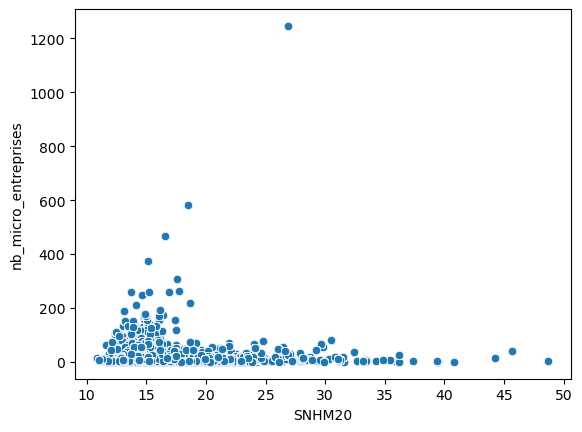

In [26]:
# Plot a scatter plot to visualize the relationship between median salary (SNHM20) 
# and the number of small enterprises (nb_micro_entreprises)

sns.scatterplot(x='SNHM20', y='nb_micro_entreprises', data = df_merge3);

##### Section 2.1.2 Test de Spearman entre le salaire médian et le nombre d'entreprises de petite taille <a class="anchor" id="section_2_1_2"></a>

**Hypothèses :**

- H0 : Il n'y a pas de corrélation entre les variables.
- H1 : Il y a une corrélation entre les variables.

Si la valeur p > α* : il n'y a pas de corrélation entre le salaire médian et le nombre d'entreprises de petite taille.
<p>*Ce coefficient α montre l'intensité de la corrélation.</p>

In [27]:
from scipy import stats

x = df_merge3['SNHM20']
y = df_merge3['nb_micro_entreprises']

# Computing the Spearman correlation coefficient

spearman_corr, spearman_p_value = stats.spearmanr(x, y)

print('Spearman correlation coefficient:', spearman_corr)
print('p-value:', spearman_p_value)

Spearman correlation coefficient: -0.0544376693824272
p-value: 0.0


**Conclusions :**

Après avoir calculé le coefficient de corrélation de Spearman entre le salaire médian et le nombre d'entreprises de petite taille, nous avons obtenu un coefficient de -0.0555 avec une p de 0.0.

Cela confirme une corrélation négative faible entre ces deux variables. Comparativement, avec le test de corrélation de Pearson, nous avions obtenu un coefficient de corrélation de -0.00918, également indiquant une corrélation négative, mais moins forte.

La valeur p < 0.05, nous rejetons H0 et acceptons H1. 
Il existe une corrélation entre le salaire médian et le nombre d'entreprises de grande taille.

##### Section 2.1.3 Test ANOVA <a class="anchor" id="section_2_1_3"></a>

Test ANOVA entre les régions (REG_nom) et le salaire moyen (SNHM20)

**Hypothesis :** 

- H0 : Aucune influence significative entre les régions et le salaire moyen
- H1 : Influence significative entre les régions et le salaire moyen

In [28]:
## Test
import statsmodels.api 
result = statsmodels.formula.api.ols('SNHM20 ~ REG_nom', data=df_merge3).fit()
table = statsmodels.api.stats.anova_lm(result)
display(table)

print("p-value (PR(>F)) < 5%  - we reject H0 and accept H1")

,df,sum_sq,mean_sq,F,PR(>F)
REG_nom,16.0,2.808454e+06,175528.358716,25828.976649,0.0
Residual,1278995.0,8.691784e+06,6.795792,NaN,NaN


p-value (PR(>F)) < 5%  - we reject H0 and accept H1


Il existe une influence significative entre les régions et le salaire moyen.

#### Section 2.2. Représentations graphiques <a class="anchor" id="section_2_2"></a>

##### Section 2.2.1 Représentations graphiques des salaires moyens par région <a class="anchor" id="section_2_2_1"></a>

<Figure size 2000x2000 with 0 Axes>

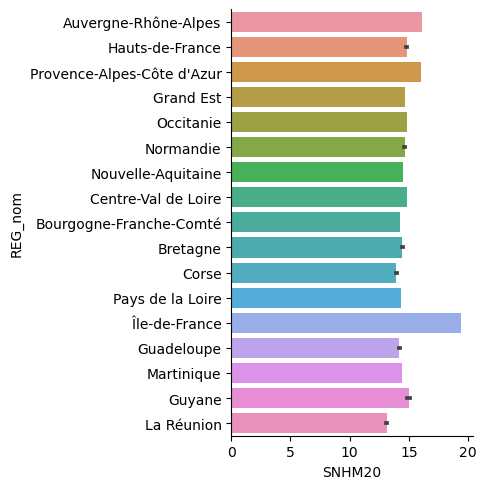

In [29]:
#Barplot
plt.figure(figsize=(20, 20))
sns.catplot(x = 'SNHM20', y = 'REG_nom', kind = 'bar', data = df_merge3);
plt.show();

**Conclusion :** 
- La région où le salaire moyen dans l'industrie est le plus élevé est l'Ile de France.
- La région où le salaire moyen dans l'industrie est le plus faible est La Réunion.
- On constate une relative égalité dans les autres regions. 

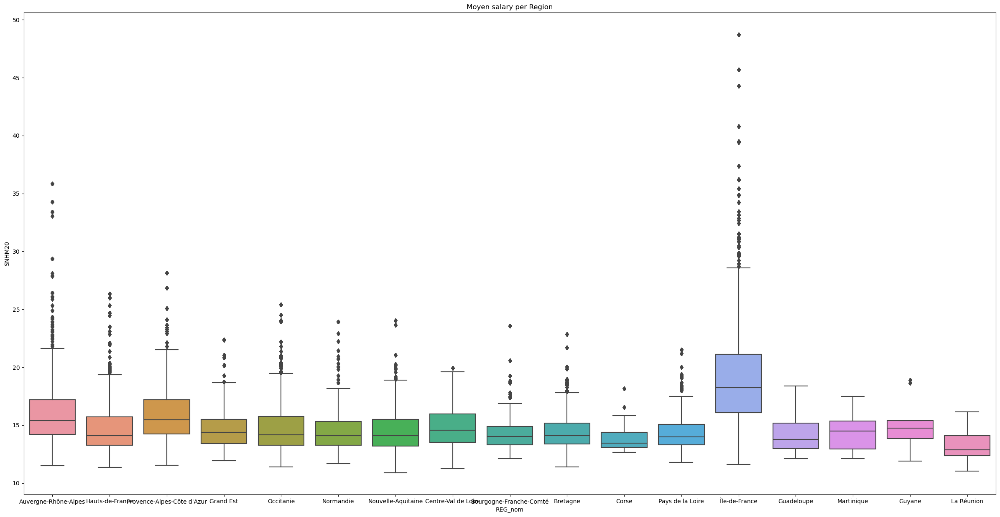

In [30]:
#Box plot (visibilité des valeurs aberrantes)
plt.figure(figsize=(30, 15));
sns.boxplot(x = 'REG_nom', y ='SNHM20', data = df_merge3)
plt.title('Moyen salary per Region')
plt.show()

**Conclusions :**

Dispersion : plus la boîte est longue, plus la dispersion des salaires moyens est grande dans une région, c'est le cas de l'Ile de France. (A l'inverse de la Bourgogne Franche-Comté, de la Corse ou de la Guyane).

Valeurs aberrantes : Les points situés à l'extérieur des « moustaches » du boxplot représentent les valeurs aberrantes, c'est-à-dire les salaires moyens qui sont considérablement plus élevés ou plus bas que la norme dans une région. 

C'est le cas pour un grand nombre de régions dont l'IDF qui détient la palme. La conclusion est inverse pour les DOM-TOM, la Corse et le Centre Val de Loire.

On va analyser les valeurs extrêmes en Île-de-France.

,CODGEO,Total_Salaries,nb_auto_entrepreneur,nb_micro_entreprises,nb_small_entreprises,nb_medium_entreprises,nb_large_entreprises,COM_code_insee,COM_nom,COM_latitude,COM_longitude,DEPT,DEPT_code,DEPT_nom,DEPT_ChefLieu_Code_insee,DEPT_ChefLieu,DEPT_ChefLieu_latitude,DEPT_ChefLieu_longitude,REG,REG_code,REG_nom,REG_ChefLieu_Code_insee,REG_ChefLieu,REG_ChefLieu_latitude,REG_ChefLieu_longitude,CAP,Capitale,Capitale_latitude,Capitale_longitude,DIST,DIST_COM_CL_DEPT,DIST_COM_CL_REG,DIST_COM_PARIS,SNHM20,SNHMC20,SNHMP20,SNHME20,SNHMO20,SNHMF20,SNHMFC20,SNHMFP20,SNHMFE20,SNHMFO20,SNHMH20,SNHMHC20,SNHMHP20,SNHMHE20,SNHMHO20,SNHM1820,SNHM2620,SNHM5020,SNHMF1820,SNHMF2620,SNHMF5020,SNHMH1820,SNHMH2620,SNHMH5020,NIVGEO,LIBGEO,MOCO,AGEQ80_17,SEXE,NB
1056007,78571,7,0,3,4,0,0,78571,Saint-Nom-la-Bretèche,48.863158,2.018960,||,78,Yvelines,78646,versailles,48.802292,2.11741,||,11,Île-de-France,75056,paris,48.86255,2.336419,||,Paris,48.852937,2.35005,||,9.89,23.22,24.25,48.719548,60.660752,19.118452,14.707427,14.269176,29.998029,38.555189,18.014081,15.720487,11.158611,60.478023,71.148906,20.954638,12.820346,14.570465,12.078399,41.612750,64.966012,11.497351,30.015923,33.360714,12.485167,50.316251,79.503926,COM,Saint-Nom-la-Bretèche,11,0,2,75
1214516,92051,75,7,41,20,3,4,92051,Neuilly-sur-Seine,48.885662,2.266596,||,92,Hauts-de-Seine,92050,nanterre,48.896169,2.20709,||,11,Île-de-France,75056,paris,48.86255,2.336419,||,Paris,48.852937,2.35005,||,4.50,5.72,7.11,45.669722,57.453860,21.641588,14.183891,12.339548,34.604539,44.606672,20.287171,13.698983,11.452839,55.868101,67.514054,23.688649,15.107443,12.598545,14.185917,41.545427,60.031972,13.835044,34.711260,38.454327,14.507292,48.018227,78.873873,COM,Neuilly-sur-Seine,11,5,1,1549
1059096,78650,19,0,15,4,0,0,78650,Le Vésinet,48.893566,2.130151,||,78,Yvelines,78646,versailles,48.802292,2.11741,||,11,Île-de-France,75056,paris,48.86255,2.336419,||,Paris,48.852937,2.35005,||,10.19,15.47,16.70,44.284168,55.353051,19.792069,14.842683,12.329917,31.755675,39.947696,19.015040,14.468250,11.568161,54.073435,65.674894,20.722316,15.573966,12.479043,13.546760,36.543832,65.032141,13.217302,29.589864,40.402751,13.929049,42.104021,82.240539,COM,Le Vésinet,32,75,1,39
1043318,78233,2,1,1,0,0,0,78233,Feucherolles,48.880114,1.979320,||,78,Yvelines,78646,versailles,48.802292,2.11741,||,11,Île-de-France,75056,paris,48.86255,2.336419,||,Paris,48.852937,2.35005,||,13.30,26.19,27.28,40.788450,50.974002,24.985329,14.081304,13.010610,30.329161,37.353019,28.109895,13.350515,13.635247,48.041954,58.408866,21.007601,15.575216,12.866320,10.922379,35.678227,51.290544,10.259388,28.888119,36.061527,11.544157,41.215767,59.317542,COM,Feucherolles,23,70,1,0
1043039,78224,2,1,1,0,0,0,78224,L'Étang-la-Ville,48.867329,2.060049,||,78,Yvelines,78646,versailles,48.802292,2.11741,||,11,Île-de-France,75056,paris,48.86255,2.336419,||,Paris,48.852937,2.35005,||,8.36,20.22,21.27,39.500071,48.577964,21.439671,13.067068,14.656655,28.443538,35.891097,18.483644,13.054451,11.736774,47.327455,55.965009,25.133529,13.093288,14.930860,11.719337,34.236397,50.453621,11.533420,27.644323,32.860681,11.906318,39.564762,60.247190,COM,L'Étang-la-Ville,22,50,2,100


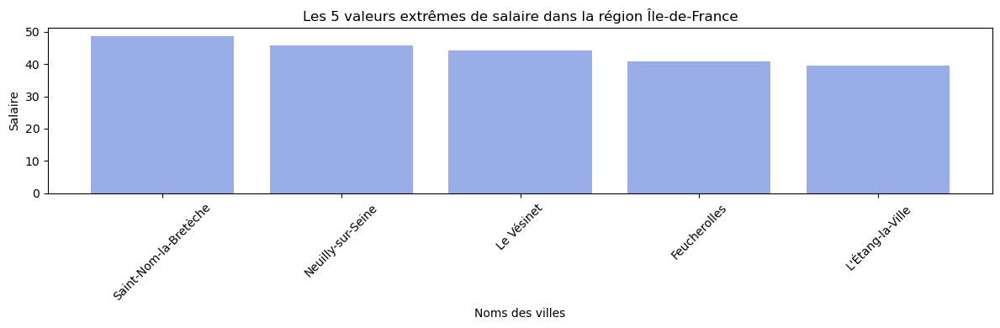

In [31]:
idf_data = df_merge3[df_merge3['REG_nom'] == 'Île-de-France']
idf_data_sorted = idf_data.sort_values(by='SNHM20', ascending=False)
top_salaries_unique = idf_data_sorted.drop_duplicates(subset=['SNHM20'], keep='first')
top_5_salaries = top_salaries_unique.head(5)
display(top_5_salaries)

plt.figure(figsize=(12, 4))
plt.bar(top_5_salaries['COM_nom'], top_5_salaries['SNHM20'], color='#99ADE9')
plt.xlabel('Noms des villes')
plt.ylabel('Salaire')
plt.title('Les 5 valeurs extrêmes de salaire dans la région Île-de-France')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

**Conclusion**

Nous avons analysé les 5 salaires les plus élevés. Nous constatons que dans les villes de Saint-Nom-la-Bretèche, Neuilly-sur-Seine et Le Vésinet, les salaires sont les plus élevés. Les valeurs extrêmes trouvées en Île-de-France montrent des disparités économiques importantes. Celles-ci peuvent être influencées par la présence de secteurs économiques spécifiques, d'entreprises multinationales ou de professionnels ayant des revenus élevés. On ne peut pas affirmer que ce sont des valeurs aberrantes à éliminer.

##### Section 2.2.2 Représentations graphiques de la distribution des salaires des femmes et des hommes de plus de 50 ans dans l'industrie en France <a class="anchor" id="section_2_2_2"></a>

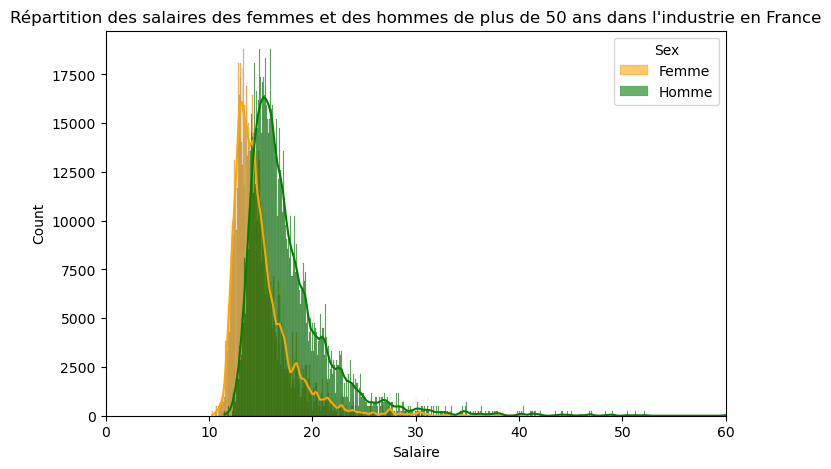

In [32]:
fig, ax = plt.subplots(figsize=(8, 5))

# Plot the distribution of women's salaries
sns.histplot(df_merge3['SNHMF5020'], kde=True, color='orange', label='Femme',alpha=0.6, ax=ax)

# Plot the distribution of men's salaries on the same Axes object
sns.histplot(df_merge3['SNHM5020'], kde=True, color='green', label='Homme', alpha=0.6, ax=ax)

ax.set_xlim(0, 60)  # Set the x-axis limits

plt.legend(title='Sex')
plt.title('Répartition des salaires des femmes et des hommes de plus de 50 ans dans l\'industrie en France')

plt.xlabel('Salaire');

**Conclusions :**
<p>La courbe KDE des salaires montre une distribution asymétrique vers la gauche, indiquant une concentration autour des salaires les plus bas. La concentration est plus importante autour de 12 €/h pour les femmes et 15 €/h pour les hommes.</p>
<p>Même dans les tranches salariales inférieures, les salaires des hommes sont généralement plus élevés que ceux des femmes.</p>

##### Section 2.2.3 Représentations graphiques de la distribution des salaires des femmes et des hommes de 18 à 25 ans dans l'industrie en France  <a class="anchor" id="section_2_2_3"></a> 


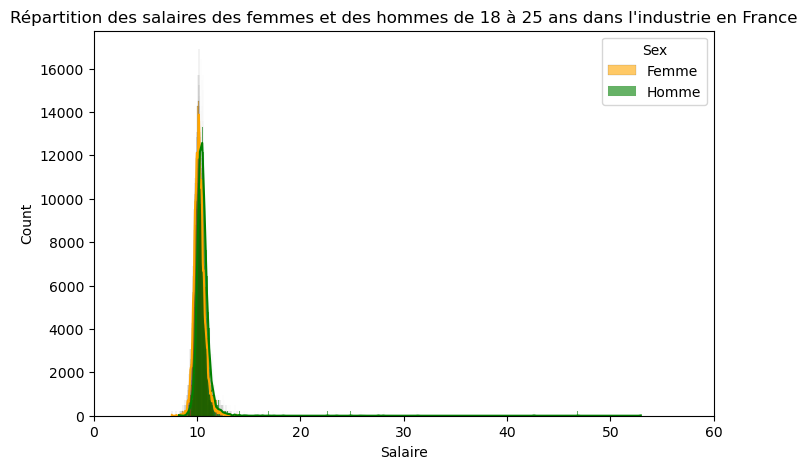

In [33]:
fig, ax = plt.subplots(figsize=(8, 5))

# Plot the distribution of women's salaries
sns.histplot(df_merge3['SNHMF1820'], kde=True, color='orange', label='Femme',alpha=0.6, ax=ax)

# Plot the distribution of men's salaries on the same Axes object
sns.histplot(df_merge3['SNHM1820'], kde=True, color='green', label='Homme', alpha=0.6, ax=ax)

ax.set_xlim(0, 60)  # Set the x-axis limits

plt.legend(title='Sex')
plt.title('Répartition des salaires des femmes et des hommes de 18 à 25 ans dans l\'industrie en France')

plt.xlabel('Salaire');

**Conclusions :**
- La majorité des salaires se concentre autour de 12 €/h pour les hommes et les femmes âgés de 18 à 25 ans.
- Même dans les tranches salariales inférieures, les salaires des hommes restent légèrement supérieurs à ceux des femmes.
- Contrairement à leurs aînés, les jeunes de 18 à 25 ans dans l'industrie connaissent moins d'écarts salariaux au début de leur carrière.


##### Section 2.2.4 Représentation graphique des salaires des femmes de plus de 50 ans par région <a class="anchor" id="section_2_2_4"></a>

<Figure size 3000x1000 with 0 Axes>

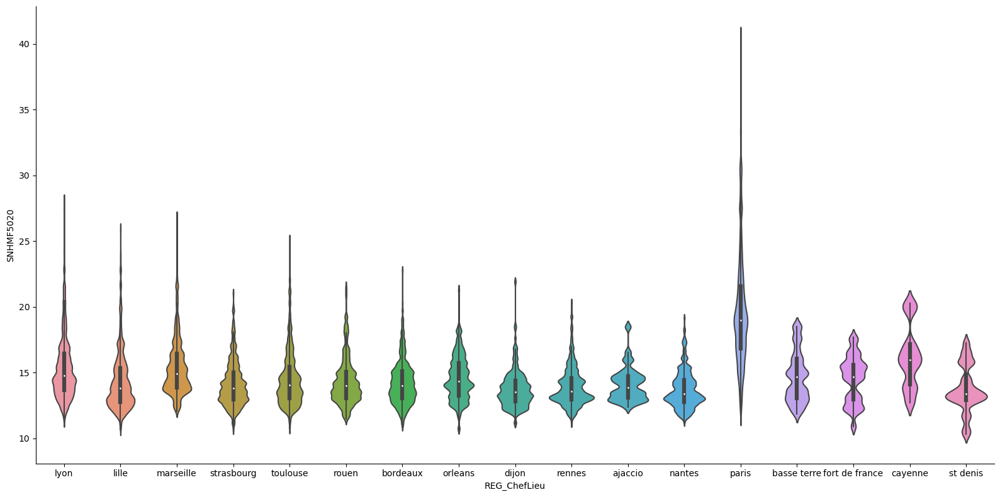

In [34]:
plt.figure(figsize=(30, 10));
sns.catplot(x = "REG_ChefLieu", y = "SNHMF5020", data = df_merge3, kind = "violin", 
            split = True, height=8, aspect=2, fontsize=10, labelpad=20, rotation=90);
plt.show();

**Conclusions :**

Disparités : Les violons reflètent les disparités salariales dans chaque chef-lieu. Si un violon est plus large et plus plat, cela indique une plus grande disparité des salaires. Par exemple, Paris montre une forte disparité, alors que Rennes et Nantes montrent des salaires plus uniformes.

Médiane : la ligne médiane à l'intérieur du violon représente la médiane des salaires. 
C'est la valeur centrale de la distribution des salaires pour ce groupe spécifique de femmes dans ce chef-lieu.

Paris et Marseille ont des valeurs médianes plus élevées que les autres villes, indiquant les salaires des femmes sont en moyenne plus élevées dans ces villes a contrario de Lille ou Saint Denis de la Réunion par exemple



##### Section 2.2.5 Représentation graphique des salaires des hommes de plus de 50 ans par région <a class="anchor" id="section_2_2_5"></a>

<Figure size 3000x1000 with 0 Axes>

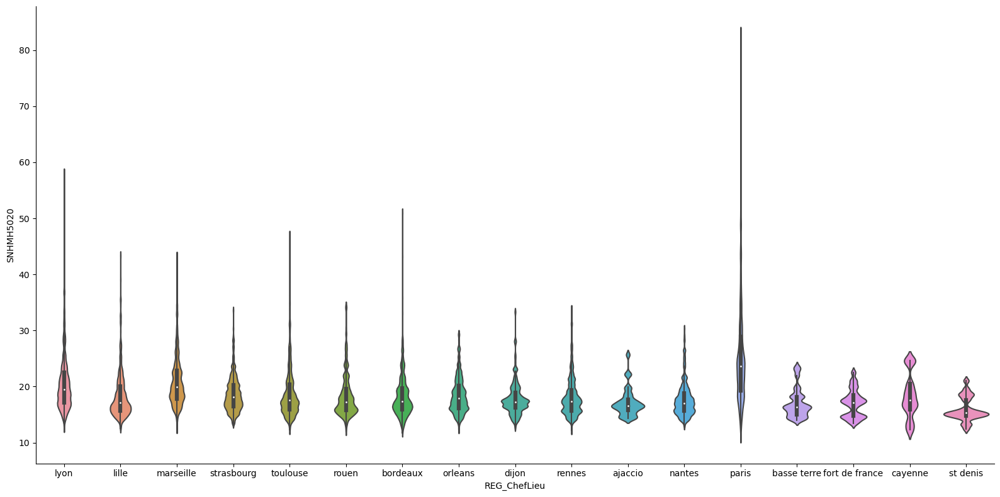

In [35]:
plt.figure(figsize=(30, 10));
sns.catplot(x = "REG_ChefLieu", y = "SNHMH5020", data = df_merge3, kind = "violin", 
            split = True,height=8, aspect=2, fontsize=10, labelpad=20, rotation=90);
plt.show();

**Conclusions :**
<p>Les interprétations sont sensiblement les mêmes que pour l'analyse des salaires des femmes de plus de 50 ans.
La différence notable est le niveau de salaire nettement plus élevé chez les hommes que chez les femmes, c'est très visible en terme de concentration (surtout en IDF)</p>

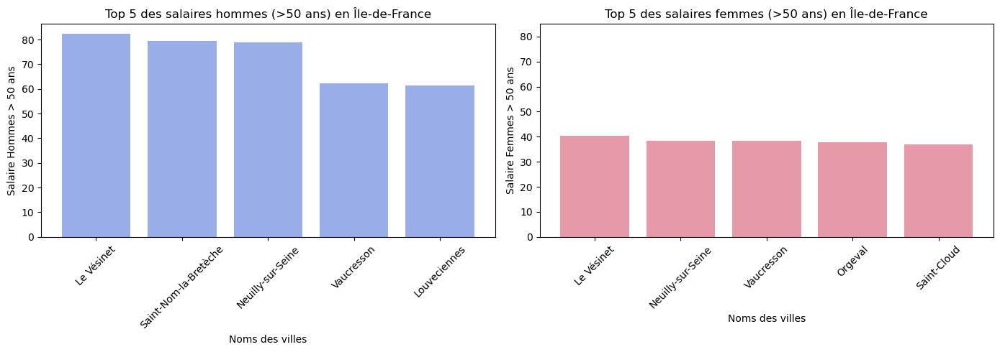

In [36]:

# Filtrer les données pour la région Île-de-France
idf_data = df_merge3[df_merge3['REG_nom'] == 'Île-de-France']

# Tri par salaires pour les hommes
idf_hommes_sorted = idf_data.sort_values(by='SNHMH5020', ascending=False)
top_salaries_unique_hommes = idf_hommes_sorted.drop_duplicates(subset=['SNHMH5020'], keep='first')
top_5_salaries_hommes = top_salaries_unique_hommes.head(5)

# Tri par salaires pour les femmes
idf_femmes_sorted = idf_data.sort_values(by='SNHMF5020', ascending=False)
top_salaries_unique_femmes = idf_femmes_sorted.drop_duplicates(subset=['SNHMF5020'], keep='first')
top_5_salaries_femmes = top_salaries_unique_femmes.head(5)

# Affichage des graphiques
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# Graphique pour les hommes
axes[0].bar(top_5_salaries_hommes['COM_nom'], top_5_salaries_hommes['SNHMH5020'], color='#99ADE9')
axes[0].set_xlabel('Noms des villes')
axes[0].set_ylabel('Salaire Hommes > 50 ans')
axes[0].set_title('Top 5 des salaires hommes (>50 ans) en Île-de-France')
axes[0].tick_params(axis='x', rotation=45)

# Graphique pour les femmes
axes[1].bar(top_5_salaries_femmes['COM_nom'], top_5_salaries_femmes['SNHMF5020'], color='#E599A9')
axes[1].set_xlabel('Noms des villes')
axes[1].set_ylabel('Salaire Femmes > 50 ans')
axes[1].set_title('Top 5 des salaires femmes (>50 ans) en Île-de-France')
axes[1].tick_params(axis='x', rotation=45)
axes[1].set_ylim(0, 85)  # Limite de l'axe y entre 0 et 80

plt.tight_layout()
plt.show()


**Conclusion**

Les graphiques montrent des différences et des similitudes dans les villes aux salaires les plus élevés pour les hommes et les femmes de plus de 50 ans en Île-de-France. 

Les villes de Le Vésinet, Neuilly-sur-Seine, et Vaucresson se distinguent pour les deux sexes, mais les salaires des hommes y sont nettement plus élevés, souvent deux fois plus élevés que ceux des femmes. 

Saint-Nom-la-Bretèche et Louveciennes sont dans le top 5 des salaires masculins mais pas féminins. À l'inverse, Orgeval et Saint-Cloud figurent dans le classement des salaires féminins mais pas masculins.

##### Section 2.2.6 Corrélation entre les tailles d'entreprise et les salaires moyens (heatmap) <a class="anchor" id="section_2_2_6"></a>

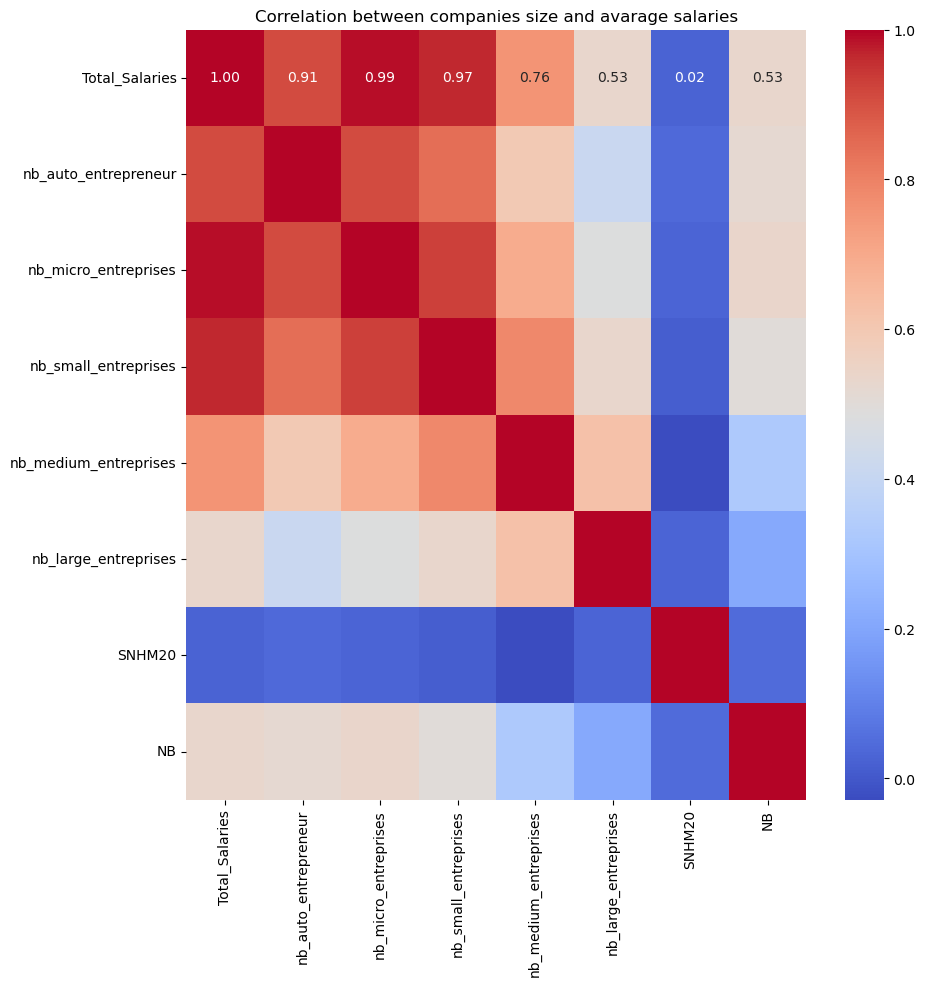

In [37]:
# Correlation between companies size and avarage salaries
selected_columns = ['Total_Salaries', 'nb_auto_entrepreneur','nb_micro_entreprises', 'nb_small_entreprises', 
                    'nb_medium_entreprises', 'nb_large_entreprises', 'SNHM20', 'NB']
selected_df = df_merge3[selected_columns]

correlation_matrix = selected_df.corr()

plt.figure(figsize=(10, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation between companies size and avarage salaries')
plt.show()

**Conclusions :** On note assez peu de corrélations entre les salaires médians et les tailles d'entreprises.

##### Section 2.2.7 Représentation graphique du nombre d'employés par région <a class="anchor" id="section_2_2_7"></a>

In [38]:
# Aggregate the data by REG_nom and sum the number of enterprises
reg_name_enterprises = df_merge3.groupby('REG_nom')['Total_Salaries'].sum().reset_index()

# Sort DataFrame by the 'Total_Salaries' column
reg_name_enterprises_sorted = reg_name_enterprises.sort_values(by='Total_Salaries', ascending=False)

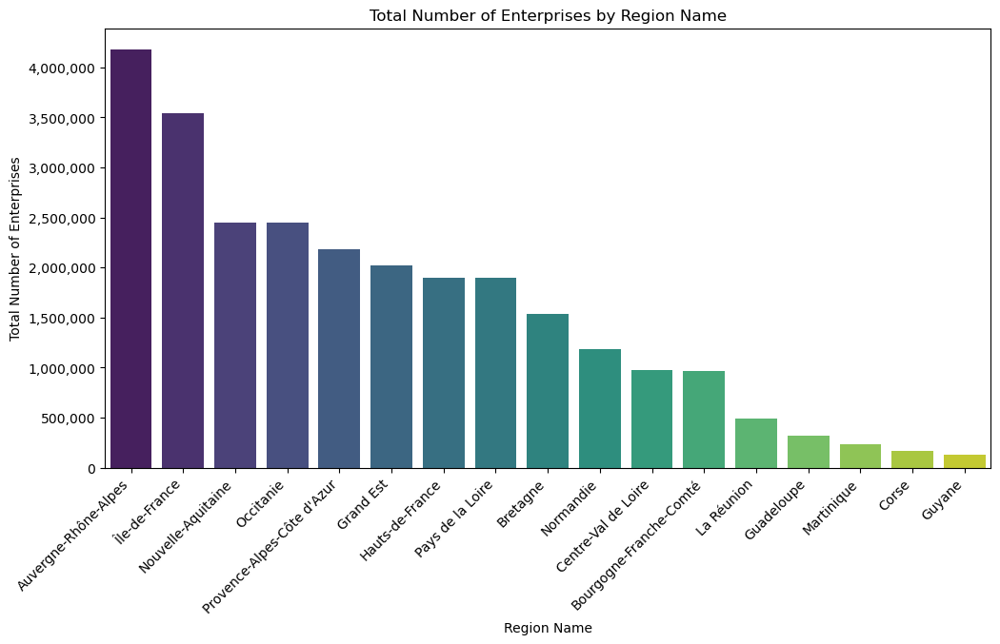

In [39]:
# Plotting the bar plot
plt.figure(figsize=(12, 6))
sns.barplot(x='REG_nom', y='Total_Salaries', data=reg_name_enterprises_sorted, palette='viridis' )
plt.title('Total Number of Enterprises by Region Name')
plt.xlabel('Region Name')
plt.ylabel('Total Number of Enterprises')
plt.xticks(rotation=45, ha='right')

# Customize the y-axis ticks to show whole numbers
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, _: '{:,.0f}'.format(x)))

plt.show();


**Conclusions :**
La région qui compte le plus grand nombre de salariés dans l'industrie (près de 4 millions) est Auvergne-Rhône-Alpes.

##### Section 2.2.8 Représentation graphique du type d'entreprises par Chef lieu des régions françaises <a class="anchor" id="section_2_2_8"></a>

In [40]:
# Aggregate the data by regional capital and sum the counts of each type of enterprise
region_enterprise_counts = df_merge3.groupby('REG_ChefLieu')[['nb_auto_entrepreneur','nb_micro_entreprises', 'nb_small_entreprises', 'nb_medium_entreprises', 'nb_large_entreprises']].sum().reset_index()

region_enterprise_counts_sorted = region_enterprise_counts.sort_values(by = 'nb_micro_entreprises', ascending = False)

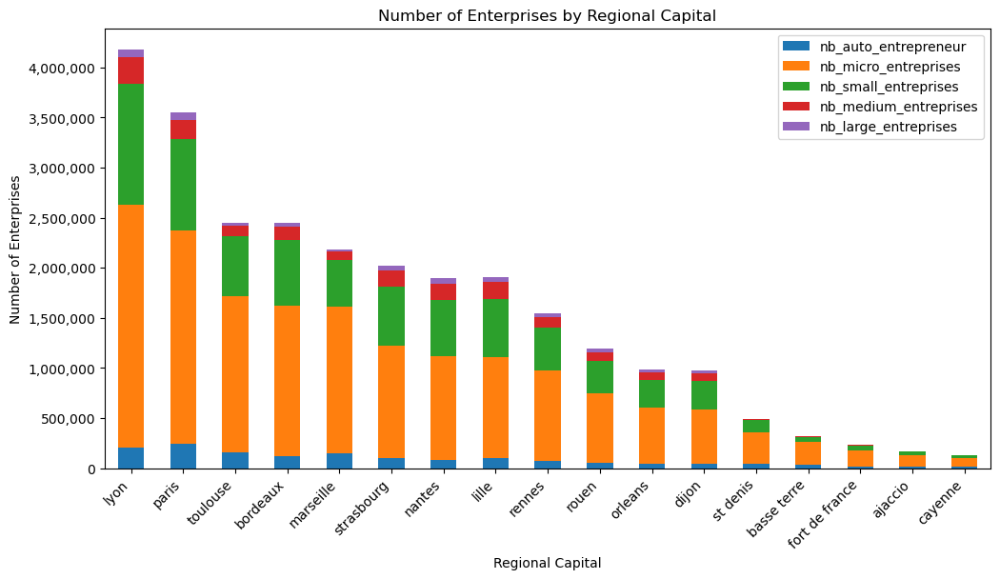

In [41]:
region_enterprise_counts_sorted.plot(x='REG_ChefLieu', kind='bar', stacked=True, figsize=(12, 6))
plt.title('Number of Enterprises by Regional Capital')
plt.xlabel('Regional Capital')
plt.ylabel('Number of Enterprises')
plt.xticks(rotation=45, ha='right')

# Customize the y-axis ticks to show whole numbers
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, _: '{:,.0f}'.format(x)))

**Conclusions :**
La représentation des micro-entreprises dans l'industrie est majoritaire dans toutes les grandes villes françaises. Lyon est N°1 comme évoqué dans la représentation graphique précédente.

##### Section 2.2.9 Corrélation entre les la distance des Grandes Villes et les salaires moyens (heatmap) <a class="anchor" id="section_2_2_9"></a>

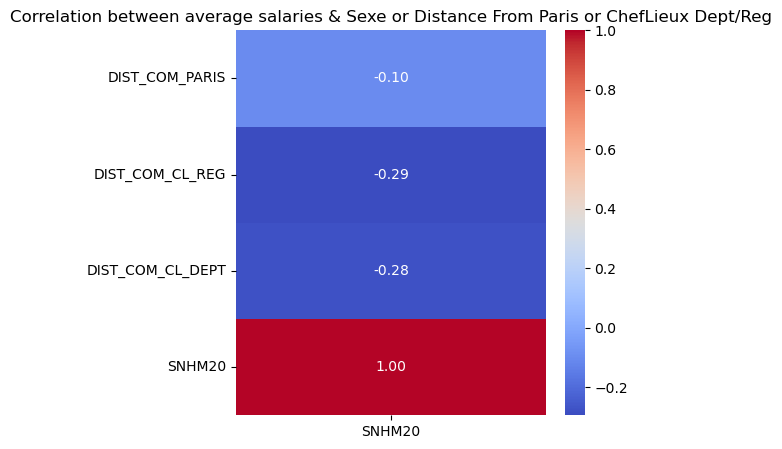

In [42]:
# Correlation between Average Salaries & distances from Paris/ChefLieux
selected_columns = ['DIST_COM_PARIS','DIST_COM_CL_REG','DIST_COM_CL_DEPT','SNHM20']
selected_df = df_merge3[selected_columns]

correlation_matrix = selected_df.corr()[["SNHM20"]]

plt.figure(figsize=(5, 5))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation between average salaries & Sexe or Distance From Paris or ChefLieux Dept/Reg')
plt.show()

**Conclusions :** Etonnamment on ne voit pas d'impact de la distance des grandes villes sur le salaire moyen

##### Section 2.2.10 Corrélation entre la distance du Chef Lieu de Région et le mode de cohabitation (displot) <a class="anchor" id="section_2_2_10"></a>

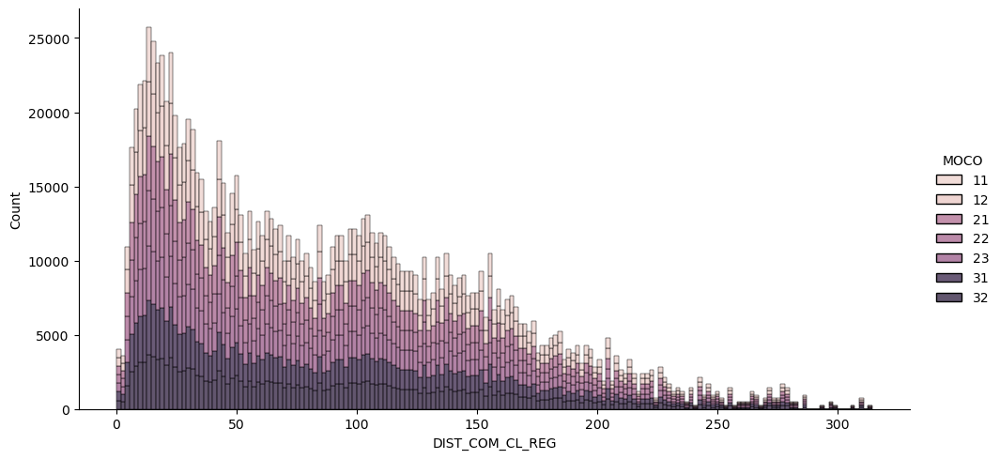

In [43]:
#Analysis of influence between Distance From ChefLieu_REG and Cohabitation Mode

sns.displot(data=df_merge3, x="DIST_COM_CL_REG", hue="MOCO", multiple="stack", height=5, aspect=2)


**Conclusions :** La distance par rapport au chef lieu de région ne semble pas avoir de réelle influence sur le mode de cohabitation.

### Chapitre 3. Nettoyage de données et Pre-processing  <a class="anchor" id="chapter3"></a>

#### Section 3.1. Problématique & proposition de résolution <a class="anchor" id="section_3_1"></a>


#### Section 3.1.1 Problématique partagée <a class="anchor" id="section_3_1_1"></a>
D'après ces premières analyses, il est nous est apparu clé **d'enrichir notre dataset** afin de travailler sur 2 axes principaux :
- Comment varie le nombre d’emplois (entreprises) en fonction de la région. 
- Comment les disparités salariales varient-elles selon le genre et l’âge dans ces différentes régions et d'en comprendre les raisons ?

Plus précisément, notre objectif est de comprendre :
- La différence de salaire net moyen horaire entre hommes et femmes, particulièrement parmi les professions de cadres (exécutives).
- Les écarts de salaire liés à l’âge entre hommes et femmes, en comparant les tranches d’âge les plus âgées avec les plus jeunes.
- L’écart salarial global entre hommes et femmes.
- Les disparités salariales entre hommes et femmes sur des tranches groupes d’âge spécifiques (18-25 ans et plus de 50 ans).

#### Section 3.1.2 Proposition de Résolution <a class="anchor" id="section_3_1_2"></a>

- Standardisation des données avant clustering : Application d’une normalisation standard sur les caractéristiques combinées pour permettre un clustering équilibré.
- Détermination du nombre optimal de clusters: Utilisation de la méthode du coude ou d’une autre méthode appropriée.
- Division des départements en clusters : Basée sur les caractéristiques socio-économiques telles que le salaire, le niveau d'éducation (avec ou sans diplôme bac+5) et le type d'entreprise, afin d’identifier des modèles ou des groupes de régions présentant des caractéristiques similaires.
- Visualisation géographique des clusters : Présentation des clusters identifiés sur une carte pour mieux comprendre leur répartition géographique.

#### Section 3.2 Enrichissement Dataset <a class="anchor" id="section_3_2"></a>

In [44]:
#  Allow to plot all columns of a data set
pd.set_option('display.max_columns', None)

## Read long strings in pandas dataframe
pd.options.display.max_colwidth = 1000

# Allow to display maximum 100 rows of a data set
pd.set_option('display.max_rows', 100)

In [45]:
# Read a Diploma dataset 
df_diploma.head()

,CODGEO,P20_HNSCOL15P_DIPLMIN,P20_HNSCOL15P_SUP5,P20_FNSCOL15P_DIPLMIN,P20_FNSCOL15P_SUP5
0,1001,40.946249,18.910057,52.629368,19.796264
1,1002,10.299953,10.697908,7.436433,13.236778
2,1004,855.298380,337.430793,1288.509677,394.687094
3,1005,108.000000,49.000000,123.000000,38.000000
4,1006,10.903509,2.973684,8.921053,2.973684


In [46]:
# Remplir les valeurs de CODGEO avec des zéros à gauche et renommer la colonne
df_diploma['CODGEO'] = df_diploma['CODGEO'].astype(str).str.zfill(5)

In [47]:
display(df_diploma.head())

,CODGEO,P20_HNSCOL15P_DIPLMIN,P20_HNSCOL15P_SUP5,P20_FNSCOL15P_DIPLMIN,P20_FNSCOL15P_SUP5
0,01001,40.946249,18.910057,52.629368,19.796264
1,01002,10.299953,10.697908,7.436433,13.236778
2,01004,855.298380,337.430793,1288.509677,394.687094
3,01005,108.000000,49.000000,123.000000,38.000000
4,01006,10.903509,2.973684,8.921053,2.973684


In [48]:
# Supprimer les chiffres après la virgule
#df_diploma['P20_HNSCOL15P_DIPLMIN'] = df_diploma['P20_HNSCOL15P_DIPLMIN'].astype(int)
#df_diploma['P20_HNSCOL15P_SUP5'] = df_diploma['P20_HNSCOL15P_SUP5'].astype(int)
#df_diploma['P20_FNSCOL15P_DIPLMIN'] = df_diploma['P20_FNSCOL15P_DIPLMIN'].astype(int)
#df_diploma['P20_FNSCOL15P_SUP5'] = df_diploma['P20_FNSCOL15P_SUP5'].astype(int)


df_diploma = df_diploma.rename(columns={
    'P20_HNSCOL15P_DIPLMIN': 'men_over_15_no_diploma',
    'P20_HNSCOL15P_SUP5': 'men_over_15_bac_plus_5_gratuated',
    'P20_FNSCOL15P_DIPLMIN': 'women_over_15_no_diploma',
    'P20_FNSCOL15P_SUP5': 'women_over_15_bac_plus_5_gratuated'
})

In [49]:
display(df_diploma.head())

,CODGEO,men_over_15_no_diploma,men_over_15_bac_plus_5_gratuated,women_over_15_no_diploma,women_over_15_bac_plus_5_gratuated
0,01001,40.946249,18.910057,52.629368,19.796264
1,01002,10.299953,10.697908,7.436433,13.236778
2,01004,855.298380,337.430793,1288.509677,394.687094
3,01005,108.000000,49.000000,123.000000,38.000000
4,01006,10.903509,2.973684,8.921053,2.973684


In [50]:
# Merge the 'df_merge3' DataFrame with the 'df_diploma' DataFrame based on the 'CODGEO' column
df_merge4=df_merge3.merge(df_diploma,left_on='CODGEO',right_on='CODGEO')
display(df_merge4.head())

,CODGEO,Total_Salaries,nb_auto_entrepreneur,nb_micro_entreprises,nb_small_entreprises,nb_medium_entreprises,nb_large_entreprises,COM_code_insee,COM_nom,COM_latitude,COM_longitude,DEPT,DEPT_code,DEPT_nom,DEPT_ChefLieu_Code_insee,DEPT_ChefLieu,DEPT_ChefLieu_latitude,DEPT_ChefLieu_longitude,REG,REG_code,REG_nom,REG_ChefLieu_Code_insee,REG_ChefLieu,REG_ChefLieu_latitude,REG_ChefLieu_longitude,CAP,Capitale,Capitale_latitude,Capitale_longitude,DIST,DIST_COM_CL_DEPT,DIST_COM_CL_REG,DIST_COM_PARIS,SNHM20,SNHMC20,SNHMP20,SNHME20,SNHMO20,SNHMF20,SNHMFC20,SNHMFP20,SNHMFE20,SNHMFO20,SNHMH20,SNHMHC20,SNHMHP20,SNHMHE20,SNHMHO20,SNHM1820,SNHM2620,SNHM5020,SNHMF1820,SNHMF2620,SNHMF5020,SNHMH1820,SNHMH2620,SNHMH5020,NIVGEO,LIBGEO,MOCO,AGEQ80_17,SEXE,NB,men_over_15_no_diploma,men_over_15_bac_plus_5_gratuated,women_over_15_no_diploma,women_over_15_bac_plus_5_gratuated
0,01004,33,2,14,15,2,0,01004,Ambérieu-en-Bugey,45.961049,5.372275,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,28.83,47.15,393.78,15.013132,25.221939,16.950395,11.259209,11.772666,13.043695,21.80658,14.36813,11.045518,10.763804,16.202197,26.693345,18.274408,11.761411,12.095672,10.880315,15.072711,17.255747,10.291297,13.234401,14.192028,11.286232,16.13062,19.22654,COM,Ambérieu-en-Bugey,11,0,1,416,855.29838,337.430793,1288.509677,394.687094
1,01004,33,2,14,15,2,0,01004,Ambérieu-en-Bugey,45.961049,5.372275,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,28.83,47.15,393.78,15.013132,25.221939,16.950395,11.259209,11.772666,13.043695,21.80658,14.36813,11.045518,10.763804,16.202197,26.693345,18.274408,11.761411,12.095672,10.880315,15.072711,17.255747,10.291297,13.234401,14.192028,11.286232,16.13062,19.22654,COM,Ambérieu-en-Bugey,11,0,2,469,855.29838,337.430793,1288.509677,394.687094
2,01004,33,2,14,15,2,0,01004,Ambérieu-en-Bugey,45.961049,5.372275,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,28.83,47.15,393.78,15.013132,25.221939,16.950395,11.259209,11.772666,13.043695,21.80658,14.36813,11.045518,10.763804,16.202197,26.693345,18.274408,11.761411,12.095672,10.880315,15.072711,17.255747,10.291297,13.234401,14.192028,11.286232,16.13062,19.22654,COM,Ambérieu-en-Bugey,11,5,1,331,855.29838,337.430793,1288.509677,394.687094
3,01004,33,2,14,15,2,0,01004,Ambérieu-en-Bugey,45.961049,5.372275,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,28.83,47.15,393.78,15.013132,25.221939,16.950395,11.259209,11.772666,13.043695,21.80658,14.36813,11.045518,10.763804,16.202197,26.693345,18.274408,11.761411,12.095672,10.880315,15.072711,17.255747,10.291297,13.234401,14.192028,11.286232,16.13062,19.22654,COM,Ambérieu-en-Bugey,11,5,2,276,855.29838,337.430793,1288.509677,394.687094
4,01004,33,2,14,15,2,0,01004,Ambérieu-en-Bugey,45.961049,5.372275,||,1,Ain,1053,bourg en bresse,46.205014,5.245594,||,84,Auvergne-Rhône-Alpes,69123,lyon,45.770061,4.828519,||,Paris,48.852937,2.35005,||,28.83,47.15,393.78,15.013132,25.221939,16.950395,11.259209,11.772666,13.043695,21.80658,14.36813,11.045518,10.763804,16.202197,26.693345,18.274408,11.761411,12.095672,10.880315,15.072711,17.255747,10.291297,13.234401,14.192028,11.286232,16.13062,19.22654,COM,Ambérieu-en-Bugey,11,10,1,313,855.29838,337.430793,1288.509677,394.687094


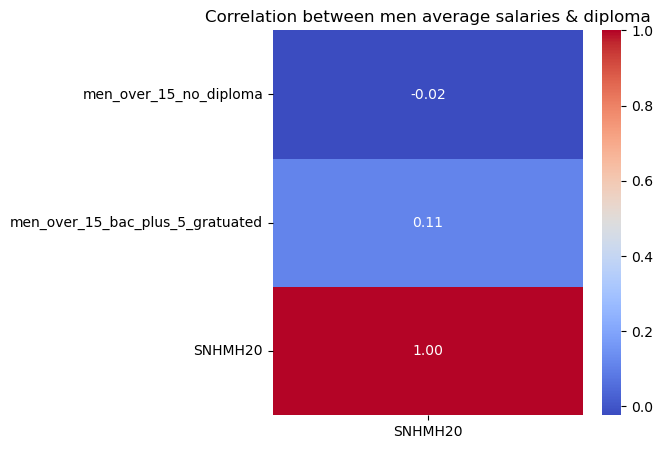

In [51]:
# Correlation entre le salaire moyen des hommes & diplômes
selected_columns = ['men_over_15_no_diploma','men_over_15_bac_plus_5_gratuated','SNHMH20']
selected_df = df_merge4[selected_columns]

correlation_matrix = selected_df.corr()[["SNHMH20"]]

plt.figure(figsize=(5, 5))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation between men average salaries & diploma')
plt.show()

**Pour les hommes de plus de 15 ans sans diplômes**
<p>Ils ont un indice de corrélation de -0,08.</p>
<p>Cela indique une corrélation très faible et presque négligeable entre le nombre d'hommes de plus de 15 ans sans diplômes et les salaires moyens des hommes. 
La valeur négative indique une tendance inverse légère, mais la valeur est proche de zéro, ce qui suggère qu'il n'y a pas de corrélation linéaire significative entre ces variables.
</p>

**Pour les hommes de plus de 15 ans avec un Bac +5** 
<p>Ils ont un indice de corrélation de +0,22.</p>
<p>Cela indique une corrélation positive modérée entre le nombre d'hommes de plus de 15 ans avec un Bac +5 
et les salaires moyens des hommes. 
La valeur positive indique que les deux variables ont tendance à augmenter ensemble, mais la corrélation n'est pas très forte. </p>

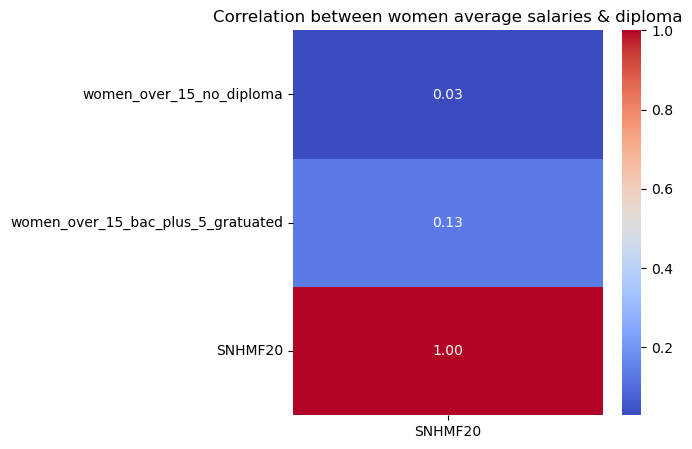

In [52]:
# Correlation entre le salaire moyen des femmes & diplômes
selected_columns = ['women_over_15_no_diploma','women_over_15_bac_plus_5_gratuated','SNHMF20']
selected_df = df_merge4[selected_columns]

correlation_matrix = selected_df.corr()[["SNHMF20"]]

plt.figure(figsize=(5, 5))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation between women average salaries & diploma')
plt.show()

Le constat est identique ou presque pour les femmes

In [53]:
df_final_merge = df_merge4.copy()

# Drop column 'NIVGEO' because it has only one unique value, and 'LIBGEO' - dublicate of com_name
df_final_merge = df_final_merge.drop(columns=['NIVGEO', 'LIBGEO'])

In [54]:
#df_final_merge.columns

In [55]:
# Renaming the columns
new_column_names = {
    'SNHM20': 'mean_net_salary_hour_overall',
    'SNHMC20': 'mean_net_salary_hour_executives',
    'SNHMP20': 'mean_net_salary_hour_avg_executive',
    'SNHME20': 'mean_net_salary_hour_employee',
    'SNHMO20': 'mean_net_salary_hour_worker',
    'SNHMF20': 'mean_net_salary_hour_female',
    'SNHMFC20': 'mean_net_salary_hour_female_executives',
    'SNHMFP20': 'mean_net_salary_hour_avg_female_executive',
    'SNHMFE20': 'mean_net_salary_hour_female_employee',
    'SNHMFO20': 'mean_net_salary_hour_female_worker',
    'SNHMH20': 'mean_net_salary_hour_male',
    'SNHMHC20': 'mean_net_salary_hour_male_executives',
    'SNHMHP20': 'mean_net_salary_hour_avg_male_executive',
    'SNHMHE20': 'mean_net_salary_hour_male_employee',
    'SNHMHO20': 'mean_net_salary_hour_male_worker',
    'SNHM1820': 'mean_net_salary_hour_18_25',
    'SNHM2620': 'mean_net_salary_hour_26_50',
    'SNHM5020': 'mean_net_salary_hour_over_50',
    'SNHMF1820': 'mean_net_salary_hour_female_18_25',
    'SNHMF2620': 'mean_net_salary_hour_female_26_50',
    'SNHMF5020': 'mean_net_salary_hour_female_over_50',
    'SNHMH1820': 'mean_net_salary_hour_male_18_25',
    'SNHMH2620': 'mean_net_salary_hour_male_26_50',
    'SNHMH5020': 'mean_net_salary_hour_male_over_50',
    'DEPT_nom': 'DEPT_name',
    'COM_nom' : 'COM_name', 
    'Capitale' : 'capital', 
    'Capitale_latitude' : 'capital_latitude',
    'Capitale_longitude':'capitale_longitude',
    'SEXE' : 'sex'
}

df_final_merge = df_final_merge.rename(columns=new_column_names)

In [56]:
summary(df_final_merge)

,type_info,%_missing_values,nb_unique_values,nb_zero_values,%_zero_values,list_unique_values,mean_or_mode,flag
CODGEO,object,0.0,5374,0,0.0,Too many values...,01004,Nothing to report
Total_Salaries,int64,0.0,198,6664,1.0,Too many values...,20.830108,Nothing to report
nb_auto_entrepreneur,int64,0.0,32,683298,53.0,Too many values...,1.154633,Nothing to report
nb_micro_entreprises,int64,0.0,137,19516,2.0,Too many values...,12.394864,Nothing to report
nb_small_entreprises,int64,0.0,81,208012,16.0,Too many values...,5.590435,Nothing to report
nb_medium_entreprises,int64,0.0,30,669256,52.0,Too many values...,1.309825,Nothing to report
nb_large_entreprises,int64,0.0,16,997934,78.0,Too many values...,0,Nothing to report
COM_code_insee,object,0.0,5374,0,0.0,Too many values...,01004,Nothing to report
COM_name,object,0.0,5326,0,0.0,Too many values...,Sainte-Marie,Nothing to report
COM_latitude,float64,0.0,5374,0,0.0,Too many values...,46.28218,Nothing to report


In [57]:
# Drop columns that will not be used 
df = df_final_merge.drop(columns=['MOCO', 'AGEQ80_17', 'sex', 'NB'])  

# Drop duplicate rows
df = df.drop_duplicates()

df_final_merge2 = df.copy()
df_final_merge2 = df_final_merge2.reset_index(drop=True) 
df_final_merge2.shape

(5374, 61)

In [58]:
# Function to format department codes correctly
def format_dept_code(code):
    try:
        # If the code is numeric and has a single digit, format it with leading zero
        if code.isdigit() and len(code) == 1:
            return f"{int(code):02d}"
        else:
            # If the code is alphanumeric or already has two digits, return it as it is
            return code
    except ValueError:
        # If the code is alphanumeric, return it as it is
        return code

# Apply the formatting function to DEPT_code
df_final_merge2['DEPT_code'] = df_final_merge2['DEPT_code'].apply(format_dept_code)


#### Section 3.3. Standardisation des variables numerique <a class="anchor" id="section_3_3"></a>

Nous n'avons pas de données qualitatives à encoder avant de procéder au clustering.

La standardisation des variables numériques permet de garantir que toutes les variables ont une échelle similaire, évitant ainsi que celles avec des valeurs plus élevées ne dominent l'analyse. 

Cette étape est particulièrement importante avant d'appliquer des techniques comme l'ACP et le clustering, car elle permet de mieux comprendre les tendances dans les données et aide les algorithmes à fonctionner correctement.

Avant de procéder à la standardisation, nous pouvons examiner la corrélation entre les variables numériques.

In [59]:
#df_final_merge2.columns

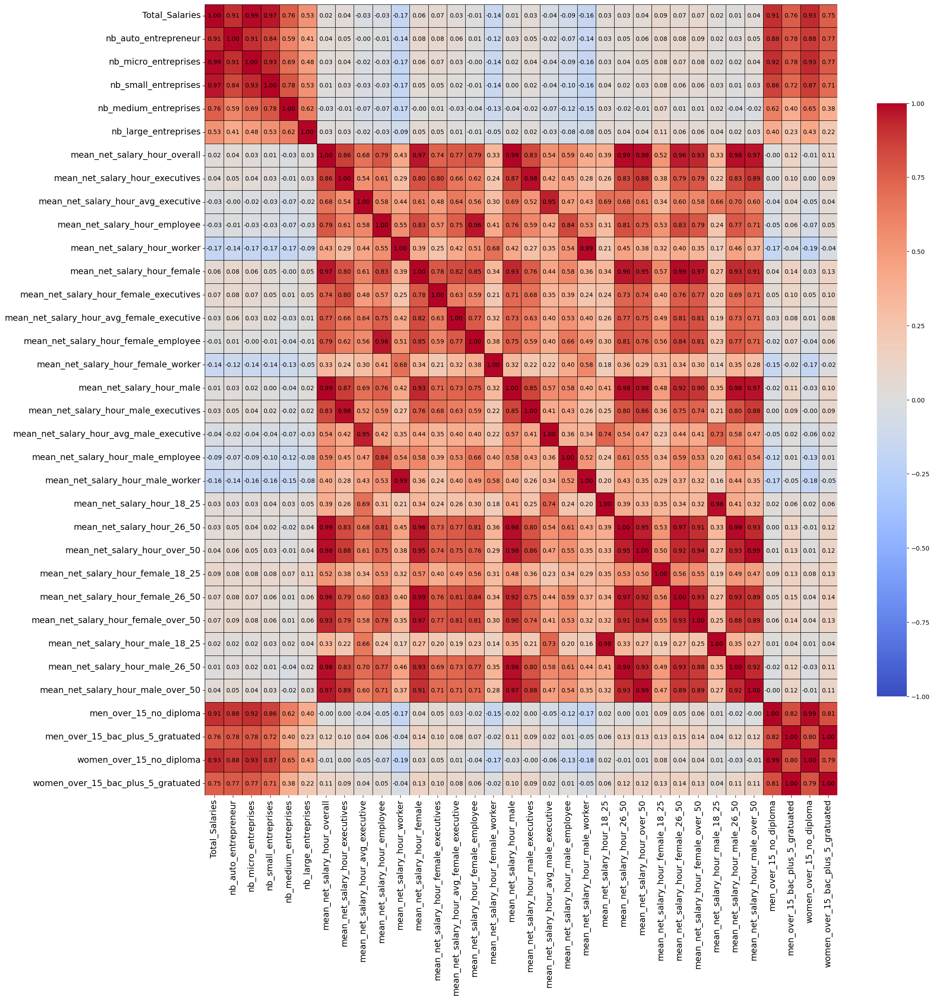

In [60]:
selected_columns = ['Total_Salaries', 'nb_auto_entrepreneur',
       'nb_micro_entreprises', 'nb_small_entreprises', 'nb_medium_entreprises',
       'nb_large_entreprises','mean_net_salary_hour_overall',
       'mean_net_salary_hour_executives', 'mean_net_salary_hour_avg_executive',
       'mean_net_salary_hour_employee', 'mean_net_salary_hour_worker',
       'mean_net_salary_hour_female', 'mean_net_salary_hour_female_executives',
       'mean_net_salary_hour_avg_female_executive',
       'mean_net_salary_hour_female_employee',
       'mean_net_salary_hour_female_worker', 'mean_net_salary_hour_male',
       'mean_net_salary_hour_male_executives',
       'mean_net_salary_hour_avg_male_executive',
       'mean_net_salary_hour_male_employee',
       'mean_net_salary_hour_male_worker', 'mean_net_salary_hour_18_25',
       'mean_net_salary_hour_26_50', 'mean_net_salary_hour_over_50',
       'mean_net_salary_hour_female_18_25',
       'mean_net_salary_hour_female_26_50',
       'mean_net_salary_hour_female_over_50',
       'mean_net_salary_hour_male_18_25', 'mean_net_salary_hour_male_26_50',
       'mean_net_salary_hour_male_over_50', 'men_over_15_no_diploma',
       'men_over_15_bac_plus_5_gratuated', 'women_over_15_no_diploma',
       'women_over_15_bac_plus_5_gratuated']

cor = df_final_merge2[selected_columns].corr()
plt.figure(figsize=(30, 30))
sns.heatmap(cor,  cmap = 'coolwarm' , vmin = -1, fmt='.2f', linewidths=.5, linecolor='black', cbar_kws={"shrink": 0.75});
plt.tight_layout()
plt.xticks(rotation=90, fontsize=14)
plt.yticks(rotation=0, fontsize=14)

# Ajouter manuellement les annotations
for i in range(len(cor)):
    for j in range(len(cor)):
        plt.text(j + 0.5, i + 0.5, f'{cor.iloc[i, j]:.2f}', 
                 ha='center', va='center', color='black', fontsize=10)

# Ajuster les marges 
plt.subplots_adjust(left=0.2, right=0.8, top=0.8, bottom=0.2)

plt.show();

**Conclusion**

La matrice de correlation montre une forte corrélation entre le nombre total d'entreprises et la répartition des tailles d'entreprises. Cette observation est normale parce que le nombre total d'entreprises est la somme de toutes les catégories d'entreprises (auto-entrepreneurs, micro-entreprises, petites entreprises, moyennes entreprises et grandes entreprises).

Il existe une corrélation positive entre le niveau d'éducation et la présence d'entreprises, tant pour les personnes sans diplôme que pour les diplômés Bac+5. Cependant, il n'y a pas de corrélation directe entre les salaires moyens horaires et le nombre total d'entreprises.

Les corrélations entre le niveau d'éducation et les salaires moyens horaires sont faibles et parfois négatives, indiquant que les niveaux d'éducation n'influencent pas significativement les salaires.

Maintenant, passons à la standardisation.

In [61]:
from sklearn.preprocessing import StandardScaler

features_num_selected = ['Total_Salaries', 'nb_auto_entrepreneur',
       'nb_micro_entreprises', 'nb_small_entreprises', 'nb_medium_entreprises',
       'nb_large_entreprises','DIST_COM_CL_DEPT', 'DIST_COM_CL_REG',
       'DIST_COM_PARIS', 'mean_net_salary_hour_overall',
       'mean_net_salary_hour_executives', 'mean_net_salary_hour_avg_executive',
       'mean_net_salary_hour_employee', 'mean_net_salary_hour_worker',
       'mean_net_salary_hour_female', 'mean_net_salary_hour_female_executives',
       'mean_net_salary_hour_avg_female_executive',
       'mean_net_salary_hour_female_employee',
       'mean_net_salary_hour_female_worker', 'mean_net_salary_hour_male',
       'mean_net_salary_hour_male_executives',
       'mean_net_salary_hour_avg_male_executive',
       'mean_net_salary_hour_male_employee',
       'mean_net_salary_hour_male_worker', 'mean_net_salary_hour_18_25',
       'mean_net_salary_hour_26_50', 'mean_net_salary_hour_over_50',
       'mean_net_salary_hour_female_18_25',
       'mean_net_salary_hour_female_26_50',
       'mean_net_salary_hour_female_over_50',
       'mean_net_salary_hour_male_18_25', 'mean_net_salary_hour_male_26_50',
       'mean_net_salary_hour_male_over_50', 'men_over_15_no_diploma',
       'men_over_15_bac_plus_5_gratuated', 'women_over_15_no_diploma',
       'women_over_15_bac_plus_5_gratuated']

sc = StandardScaler()
df_selected = df_final_merge2[features_num_selected].reset_index(drop=True) 

df_selected_scaled = sc.fit_transform(df_selected)
df_scaled_df = pd.DataFrame(df_selected_scaled, columns = features_num_selected)

df_scaled_df.head()

,Total_Salaries,nb_auto_entrepreneur,nb_micro_entreprises,nb_small_entreprises,nb_medium_entreprises,nb_large_entreprises,DIST_COM_CL_DEPT,DIST_COM_CL_REG,DIST_COM_PARIS,mean_net_salary_hour_overall,mean_net_salary_hour_executives,mean_net_salary_hour_avg_executive,mean_net_salary_hour_employee,mean_net_salary_hour_worker,mean_net_salary_hour_female,mean_net_salary_hour_female_executives,mean_net_salary_hour_avg_female_executive,mean_net_salary_hour_female_employee,mean_net_salary_hour_female_worker,mean_net_salary_hour_male,mean_net_salary_hour_male_executives,mean_net_salary_hour_avg_male_executive,mean_net_salary_hour_male_employee,mean_net_salary_hour_male_worker,mean_net_salary_hour_18_25,mean_net_salary_hour_26_50,mean_net_salary_hour_over_50,mean_net_salary_hour_female_18_25,mean_net_salary_hour_female_26_50,mean_net_salary_hour_female_over_50,mean_net_salary_hour_male_18_25,mean_net_salary_hour_male_26_50,mean_net_salary_hour_male_over_50,men_over_15_no_diploma,men_over_15_bac_plus_5_gratuated,women_over_15_no_diploma,women_over_15_bac_plus_5_gratuated
0,0.276419,0.251946,0.057615,0.839670,0.264968,-0.354321,-0.021830,-0.621553,-0.067957,-0.123000,0.022424,0.781825,-0.432562,-0.459464,-0.328691,-0.067377,-0.286817,-0.499618,-0.013930,-0.089311,-0.002369,0.668042,-0.308793,-0.376979,0.251947,-0.000556,-0.094492,0.110346,-0.243592,-0.282510,0.253226,0.038512,-0.058708,0.135823,-0.025513,0.213148,-0.003498
1,-0.200561,-0.344117,-0.085961,-0.320395,-0.502860,-0.354321,-0.258599,-0.598352,-0.072970,-0.040227,-0.216854,0.240488,0.487431,0.506843,0.035140,-0.164875,0.463698,0.788852,0.800814,-0.033695,-0.204251,0.121225,-0.313078,0.611445,-0.029253,0.071901,-0.162807,0.736975,0.125239,-0.204593,-0.184614,0.070244,-0.040774,-0.292931,-0.083508,-0.314668,-0.073984
2,0.707972,-0.046086,0.596025,1.018141,1.416709,-0.354321,0.283527,0.018465,-0.082572,-0.267876,0.805773,0.384362,0.848356,-0.361068,-0.540498,-0.460089,-1.395086,1.075665,0.180022,-0.129156,1.123838,0.581448,0.243709,-0.114492,0.400817,-0.363592,-0.263661,0.118027,-0.708234,-0.371753,0.438129,-0.158820,-0.208682,-0.132425,-0.089192,-0.165050,-0.083058
3,-0.268701,-0.344117,-0.229537,-0.320395,-0.118946,-0.354321,-0.890923,-0.364125,-0.108281,-0.241375,-0.382392,0.338912,0.471332,-0.000263,-0.324173,-0.654127,0.239472,0.025140,-0.575678,-0.216010,-0.200319,0.144740,1.940036,0.163609,-0.067723,-0.169466,-0.292430,-0.388044,-0.227720,-0.454206,-0.006634,-0.162682,-0.206156,-0.273241,-0.086267,-0.282890,-0.081181
4,-0.314128,-0.344117,-0.265431,-0.320395,-0.502860,-0.354321,-0.183904,-0.373122,-0.122145,-0.143083,0.195381,-0.330496,0.133244,0.351826,-0.149097,0.097920,-0.414515,0.020163,0.411421,-0.156718,0.191288,-0.210956,0.454287,0.340776,-0.161955,-0.122982,-0.187709,0.144973,-0.114887,-0.233034,-0.209061,-0.138611,-0.206388,-0.197654,-0.083190,-0.255910,-0.073439


### Chapitre 4. Modelisation <a class="anchor" id="chapter4"></a>


Le clustering est une technique d'analyse de données qui divise un ensemble de données en groupes homogènes appelés clusters. 

En regroupant les départements selon leurs caractéristiques socio-économiques telles que le salaire, le niveau d'éducation (avec ou sans diplôme bac+5) et le type d'entreprise, le clustering nous permet de mettre en lumière à la fois les similarités et les disparités entre les différents groupes.

Pour tester différentes méthodes de clustering, nous allons utiliser les approches suivantes :
- K-means clustering sans ACP
- K-means clustering après ACP
- K-means clustering après T-SNE
- AgglomerativeClustering après T-SNE
- AgglomerativeClustering après ACP
- K-means clustering après UMAP

Ces différentes méthodes nous permettront de comparer les résultats et de choisir la plus adaptée à notre analyse.

#### Section 4.1 K-means Clustering sans ACP <a class="anchor" id="section_4_1"></a>

**Step 1. Selection des nombres des clusters**

Pour déterminer le nombre optimal de clusters, nous commençons par utiliser un dendrogramme, suivi de la méthode du coude.

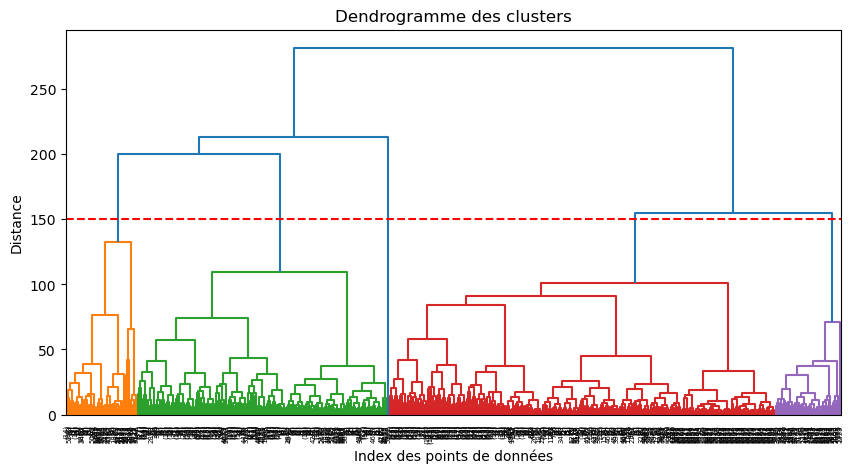

In [62]:
from scipy.cluster.hierarchy import dendrogram, linkage

# Appliquer l'algorithme de clustering hiérarchique
linked = linkage(df_scaled_df, method='ward')

# Tracer le dendrogramme
plt.figure(figsize=(10, 5))
dendrogram(linked, orientation='top', distance_sort='descending', truncate_mode='level', p=10, 
           color_threshold=150, show_leaf_counts=True)
plt.axhline(y=150, color='r', linestyle='--')
plt.title('Dendrogramme des clusters')
plt.xlabel('Index des points de données')
plt.ylabel('Distance')
plt.show()

Le dendrogramme suggère que cinq clusters pourraient être un bon choix, en fonction des distances de fusion observées.

Pour affiner notre analyse, nous allons utiliser la méthode du coude pour trouver le nombre de clusters optimal.

La méthode du coude consiste à calculer la distorsion (la somme des distances euclidiennes minimales des points aux centres des clusters) pour différents nombres de clusters. La distorsion est ensuite tracée en fonction du nombre de clusters, et le "coude" du graphique indique le nombre optimal de clusters à utiliser.

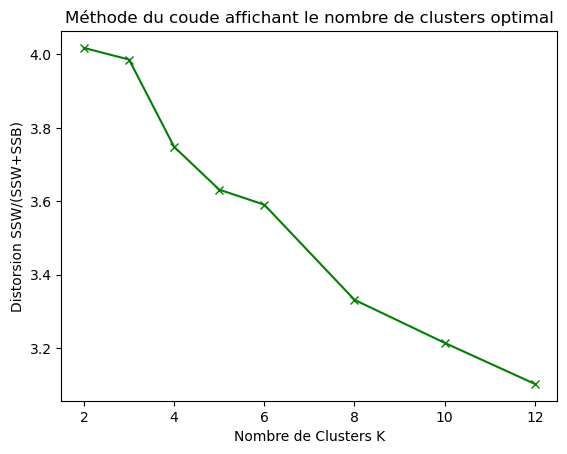

In [63]:
# Importation de la fonction cdist du package scipy.spatial.distance
from scipy.spatial.distance import cdist
from sklearn.cluster import KMeans

# Liste des nombres de clusters
range_n_clusters = [2, 3, 4, 5, 6, 8, 10, 12]  

# Initialisation de la liste de distorsions
distorsions = []

# Calcul des distorsions pour les différents modèles
for n_clusters in range_n_clusters:
    
    # Initialisation d'un cluster ayant un pour nombre de clusters n_clusters
    cluster = KMeans(n_clusters = n_clusters)
    
    # Apprentissage des données suivant le cluster construit ci-dessus
    cluster.fit(df_scaled_df)
    
    # Ajout de la nouvelle distorsion à la liste des données
    distorsions.append(sum(np.min(cdist(df_scaled_df, cluster.cluster_centers_, 'euclidean'), axis=1)) / np.size(df_scaled_df, axis = 0))

# Visualisation des distorsions en fonction du nombre de clusters
plt.plot(range_n_clusters, distorsions, 'gx-')
plt.xlabel('Nombre de Clusters K')
plt.ylabel('Distorsion SSW/(SSW+SSB)')
plt.title('Méthode du coude affichant le nombre de clusters optimal')
plt.show()

On remarque qu'après 5 clusters, les gains diminuent, donc nous allons sélectionner 5 clusters pour les analyses futures. 

En conclusion, en utilisant à la fois le dendrogramme et la méthode du coude, nous avons déterminé que l'algorithme K-Means sera utilisé avec cinq clusters sur les données standardisées.

**Step 2. Clustering avec KMeans**

Nous allons maintenant effectuer un clustering avec l'algorithme KMeans en utilisant le nombre de clusters déterminé précédemment.

In [64]:
from sklearn.cluster import KMeans

# Perform K-means clustering
kmeans = KMeans(n_clusters=5, random_state=42)
kmeans.fit(df_scaled_df)

# Centroids and labels
centroids = kmeans.cluster_centers_
labels = kmeans.labels_

# Dictionary to store results
clustering_results = {}

clustering_results['KMeans without ACP'] = {'data': df_scaled_df, 'labels': labels}

# Add the cluster labels back to the original DataFrame
df_final_merge2['Cluster'] = labels

# Calculate the mean of each feature for each cluster
cluster_means = df_final_merge2.groupby('Cluster')[features_num_selected].mean().reset_index()

# Display the mean features values by cluster
display(cluster_means)



,Cluster,Total_Salaries,nb_auto_entrepreneur,nb_micro_entreprises,nb_small_entreprises,nb_medium_entreprises,nb_large_entreprises,DIST_COM_CL_DEPT,DIST_COM_CL_REG,DIST_COM_PARIS,mean_net_salary_hour_overall,mean_net_salary_hour_executives,mean_net_salary_hour_avg_executive,mean_net_salary_hour_employee,mean_net_salary_hour_worker,mean_net_salary_hour_female,mean_net_salary_hour_female_executives,mean_net_salary_hour_avg_female_executive,mean_net_salary_hour_female_employee,mean_net_salary_hour_female_worker,mean_net_salary_hour_male,mean_net_salary_hour_male_executives,mean_net_salary_hour_avg_male_executive,mean_net_salary_hour_male_employee,mean_net_salary_hour_male_worker,mean_net_salary_hour_18_25,mean_net_salary_hour_26_50,mean_net_salary_hour_over_50,mean_net_salary_hour_female_18_25,mean_net_salary_hour_female_26_50,mean_net_salary_hour_female_over_50,mean_net_salary_hour_male_18_25,mean_net_salary_hour_male_26_50,mean_net_salary_hour_male_over_50,men_over_15_no_diploma,men_over_15_bac_plus_5_gratuated,women_over_15_no_diploma,women_over_15_bac_plus_5_gratuated
0,0,19.808411,1.322430,11.845794,4.915888,1.084112,0.640187,14.485888,34.745327,159.624346,25.641456,35.234286,18.852350,13.210916,12.734746,21.158069,29.074354,17.179550,13.045570,11.382372,29.011516,38.829833,20.595042,13.574833,12.949859,12.456065,23.775674,32.193836,11.156853,20.744170,24.411830,13.318278,26.147593,37.648365,506.171823,1705.986731,676.584697,1442.586513
1,1,16.807566,0.854930,9.865356,4.632112,1.138219,0.316950,33.665624,100.515439,477.809497,13.843422,23.636640,15.264401,11.180589,11.841282,12.604523,20.850554,14.153210,11.018457,10.542668,14.704132,24.952019,16.140159,11.652632,12.112188,10.331446,13.690732,15.519700,10.062775,12.615172,13.540546,10.518046,14.428506,16.922948,508.372161,161.736883,705.638270,147.885403
2,2,15.168459,0.807646,9.068100,4.164875,0.894863,0.232975,23.567330,66.495108,403.037180,17.196286,26.890479,16.634743,12.158127,12.683494,15.187221,23.359991,15.395091,11.958830,11.221522,18.665611,28.686680,17.707135,12.712776,12.949529,10.837100,16.763627,20.125831,10.453621,15.162910,16.753987,11.123309,17.944439,22.539786,385.860049,340.361716,491.962117,297.918914
3,3,187.234375,12.054688,113.523438,46.867188,11.273438,3.515625,14.550313,69.015937,1161.402422,14.761786,24.881122,15.335607,11.276490,11.379349,13.685417,22.287889,14.558747,11.200464,10.042576,15.527394,26.314092,16.016575,11.450334,11.657769,10.540380,14.629250,17.204530,10.276434,13.800904,15.133525,10.748634,15.189642,18.782352,6293.282511,5061.401929,8259.358670,4596.335593
4,4,1921.000000,157.000000,1246.000000,470.000000,45.000000,3.000000,0.000000,0.000000,1.460000,26.902558,36.764664,18.212561,12.738100,11.353863,23.684185,31.407258,17.473785,12.741673,11.046935,29.642383,41.113579,19.090146,12.733468,11.422010,13.089681,25.987506,34.305523,12.805619,23.875711,27.225903,13.395804,27.732365,40.393949,86644.864050,318287.322961,103630.577173,313110.402171


**Que nous apprennent les différents clusters identifiés ?**

| **Critère**                      | **Cluster 0**                  | **Cluster 1**                         | **Cluster 2**                           | **Cluster 3**                         | **Cluster 4**                      |
|----------------------------------|--------------------------------|---------------------------------------|-----------------------------------------|---------------------------------------|------------------------------------|
| **Nombre d'entreprises**         | Modéré                       | Faible                                | Faible                                  | Élevés                                  | Très élevé                         |
| **Disparité éducative**          | Haute concentration de diplômés Bac+5 | Équilibrée  | Forte disparité (plus de personnes sans diplôme)	| Équilibrée pour les hommes, deséquilibrée pour femmes (deux fois plus de femmes sans diplôme) | Haute concentration de diplômés Bac+5 |
| **Salaires horaires moyens**     | Élevés          | Parmi les plus bas   | Relativement élevés      | Relativement faible                         | Très élevés                        |
| **Localisation par rapport à Paris** | Proximité significative    | Très éloignée     | Éloignée      | Éloignée | Très proche                        |


**Step 3. Visualisation des clusters sur la map**

Nous allons maintenant visualiser les clusters sur la carte pour mieux comprendre leur répartition géographique.

In [65]:
# Define your legend HTML, cluster colors, and popup HTML function
legend_html = """
<div style="position: fixed; 
     bottom: 50px; left: 50px; width: 200px; height: 160px; 
     border:2px solid grey; z-index:9999; font-size:14px; 
     background:white; padding:10px;">
     <h4 style="margin:8px;">Cluster Legend</h4>
     <div style="background:#fbffb8;width:10px;height:10px;display:inline-block;"></div> Cluster 0 - Yellow<br>
     <div style="background:#32a852;width:10px;height:10px;display:inline-block;"></div> Cluster 1 - Green<br>
     <div style="background:#fa485a;width:10px;height:10px;display:inline-block;"></div> Cluster 2 - Red<br>
     <div style="background:#cfb8ff;width:10px;height:10px;display:inline-block;"></div> Cluster 3 - Purple<br>
     <div style="background:#3530cf;width:10px;height:10px;display:inline-block;"></div> Cluster 4 - Blue
</div>
"""

cluster_colors = {
    0: '#fbffb8',  # Light Yellow
    1: '#32a852',  # Green
    2: '#fa485a',  # Red
    3: '#cfb8ff',  # Light Purple
    4: '#3530cf'   # Blue
}

# Call the function to plot the map
plot_cluster_map(df_final_merge2, '../src/departements.geojson', 'Cluster', cluster_colors, legend_html, generate_popup, cluster_means)


#### Section 4.2 K-means Clustering après ACP  <a class="anchor" id="section_4_2"></a>

**Pourquoi ACP?**

Nous faisons de la réduction de dimension pour simplifier notre modèle et améliorer son efficacité. Avec des variables comme les salaires, le nombre d'entreprises et les niveaux d'éducation, l'ACP réduit la complexité et le bruit, facilite la visualisation des clusters et améliore les performances des algorithmes de clustering.

Ainsi, notre analyse devient plus robuste et précise.

**1. Analyse en Composantes Principales**

La variance expliquée :  [1.52742612e+01 7.88609504e+00 2.50728526e+00 2.12946875e+00
 1.32675499e+00 1.19064245e+00 1.07483994e+00 8.06871940e-01
 7.19678508e-01 6.71895044e-01 4.99652503e-01 4.48572741e-01
 4.24475562e-01 3.78067881e-01 3.54341798e-01 2.91082305e-01
 2.38411986e-01 2.15879597e-01 1.59262404e-01 1.18698534e-01
 1.13363854e-01 5.34129549e-02 5.25458963e-02 3.66999775e-02
 6.80720799e-03 6.44030307e-03 4.98969382e-03 4.44155877e-03
 3.63044434e-03 3.00817819e-03 2.58845415e-03 1.33306567e-03
 6.32425345e-04 3.90115122e-04 3.44214718e-04 1.94924771e-05
 3.38495104e-29]


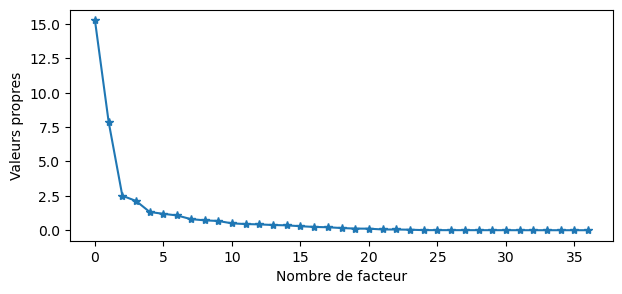

In [66]:
from sklearn.decomposition import PCA

pca = PCA()
Coord = pca.fit_transform(df_scaled_df)
size = len(df_scaled_df.columns)

print("La variance expliquée : ", pca.explained_variance_)

plt.figure(figsize=(7,3))
plt.plot(np.arange(0, size), pca.explained_variance_, marker='*')
plt.xlabel('Nombre de facteur')
plt.ylabel('Valeurs propres');

La courbe montre que les 2 premières composantes présentent une diminution marquée des valeurs propres, capturant ainsi la majorité de la variance. Cela indique que ces deux composantes principales sont les plus importantes pour l'analyse ACP.

On trace le graphe de la somme cumulative représentant le ratio de la variance expliquée en fonction du nombre de composantes.

Les ration de la variance expliquée : [4.12741053e-01 2.13098043e-01 6.77518568e-02 5.75424998e-02
 3.58515705e-02 3.21735378e-02 2.90443226e-02 2.18032918e-02
 1.94471511e-02 1.81559464e-02 1.35016089e-02 1.21213316e-02
 1.14701777e-02 1.02161495e-02 9.57502330e-03 7.86562540e-03
 6.44236816e-03 5.83349800e-03 4.30358833e-03 3.20747153e-03
 3.06331780e-03 1.44332475e-03 1.41989509e-03 9.91706711e-04
 1.83944359e-04 1.74029856e-04 1.34831495e-04 1.20019791e-04
 9.81018591e-05 8.12869846e-05 6.99452023e-05 3.60220975e-05
 1.70893963e-05 1.05416900e-05 9.30136936e-06 5.26725674e-07
 9.14681396e-31]


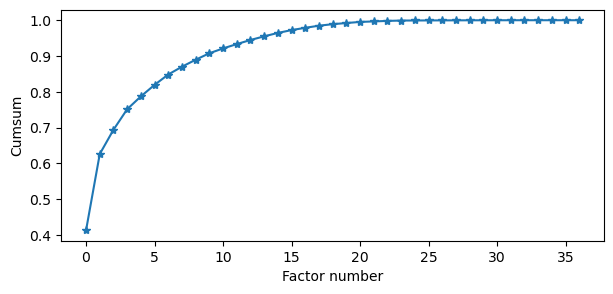

In [67]:
print("Les ration de la variance expliquée :", pca.explained_variance_ratio_)
plt.figure(figsize=(7,3))
plt.plot(np.arange(0,size), np.cumsum(pca.explained_variance_ratio_), marker = '*')
plt.xlabel('Factor number')
plt.ylabel('Cumsum');

Les deux premières composantes expliquent environ 62% de la variance totale et les cinq premières composantes expliquent environ 80%. 

On peut représenter la part de variance expliquée par chaque axe de l'ACP sous forme de graphique en camembert.

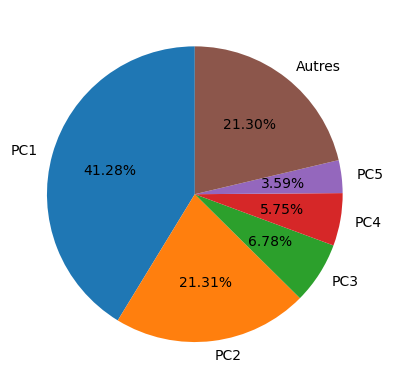

In [68]:
# Camembert de la répartition de la part de variance expliquée par chaque axe.
L1 = list(pca.explained_variance_ratio_[0:5])
L1.append(sum(pca.explained_variance_ratio_[5:31]))

plt.pie(L1, labels=['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'Autres'], 
        autopct='%1.2f%%', startangle=90);

Ce camembert représente la proportion de variance expliquée par chaque composante principale dans une ACP. Voici la répartition :
- PC1 explique 41.28% de la variance.
- PC2 explique 21.31% de la variance.
- PC3 explique 6.78% de la variance.
- PC4 explique 5.75% de la variance.
- PC5 explique 3.59% de la variance.
- "Autres" expliquent ensemble 21.30% de la variance.

Les deux premières composantes (PC1 et PC2) combinées expliquent approximativement 62,42 % de la variance totale, mais cela semble encore faible. 

En ajoutant les cinq premières composantes, nous expliquons environ 78,54 % de la variance totale.

**2. Affichage un cercle des corrélations**

On peut à présent tracer le cercle des corrélations, qui nous permet d'évaluer l'influence de chaque variable pour chaque axe de représentation.

Nous allons tracer ce cercle des corrélations uniquement pour les deux premières composantes principales (PC1 et PC2), car elles expliquent ensemble la plus grande part de la variance totale (62,42 %). Cela permet de visualiser de manière plus claire et compréhensible l'influence des variables sur les axes principaux.

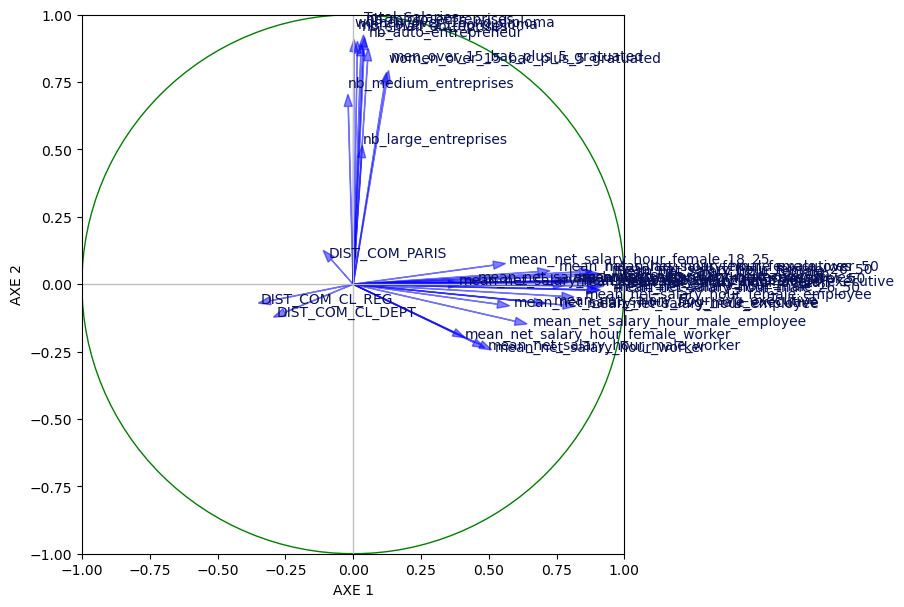

In [69]:
## Static correlation circle 

sqrt_eigval = np.sqrt(pca.explained_variance_)  
corvar = np.zeros((size, size))  

for k in range(size):  # Calculate for the first five components
    corvar[:, k] = pca.components_[k, :] * sqrt_eigval[k]

fig, axes = plt.subplots(figsize=(7, 7))
axes.set_xlim(-1, 1)
axes.set_ylim(-1, 1)

# Annotating name of variables
for j in range(size):
    plt.annotate(df_scaled_df.columns[j], (corvar[j, 0], corvar[j, 1]), color='#091158')
    plt.arrow(0, 0, corvar[j, 0]*0.9, corvar[j, 1]*0.9, alpha=0.5, head_width=0.03, color='b')

# Add axes lines
plt.plot([-1, 1], [0, 0], color='silver', linestyle='-', linewidth=1)
plt.plot([0, 0], [-1, 1], color='silver', linestyle='-', linewidth=1)

# Add a circle to show the correlation coefficient boundary
cercle = plt.Circle((0, 0), 1, color='green', fill=False)
axes.add_artist(cercle)

# Set the labels for the axes
plt.xlabel('AXE 1')  # Principal Component 1
plt.ylabel('AXE 2')  # Principal Component 2

# Display the plot
plt.show()


**Que nous apprend ce cercle de corrélation ?**

Nous constatons qu’il y a deux groupes principaux de vecteurs :
- Le premier groupe concerne principalement les variables de salaires (par genre, par âge et par catégorie de postes).
- Le second groupe concerne les variables de diplômes et de nombre d’entreprises.

Les vecteurs des variables de diplômes et de nombre d'entreprises pointant dans la même direction sur le cercle de corrélation indiquent une forte corrélation positive entre elles. Cela peut signifier qu’avec des niveaux de diplômes plus élevés sont associés à un plus grand nombre d'entreprises, qu’elle que soit leur taille.

S’agissant des vecteurs représentant les variables de salaires par genre, par âge et par catégorie de postes : 
- les salaires par genre (hommes et femmes) pointent dans la même direction, cela peut indiquer qu'il existe une disparité salariale entre hommes et femmes, les hommes ayant tendance à gagner plus que les femmes.
- les salaires par âge pointent dans la même direction, cela suggère une tendance générale de l'augmentation des salaires avec l'âge, ce qui est courant dans de nombreux contextes professionnels.
- les salaires varient également en fonction de la catégorie de postes occupée (employés, ouvriers, cadres), et cette variation est cohérente avec les tendances observées pour le genre et l'âge.âge.


**3. KMeans clustering après ACP**

Nous utiliserons l'algorithme K-Means pour effectuer un clustering sur les données transformées par l'ACP avec ces cinq composantes, afin d'identifier les groupes distincts et obtenir une meilleure compréhension des schémas présents.

**ACP avec n_components = 5**

In [70]:
pca_5 = PCA(n_components = 5)
coord_acp_5 = pca_5.fit_transform(df_scaled_df)


**Determination le nombre optimal de clusters**

Après avoir réduit la dimensionnalité de nos données à l'aide de l'ACP en utilisant cinq composantes principales, nous allons utiliser un dendrogramme pour visualiser les clusters.

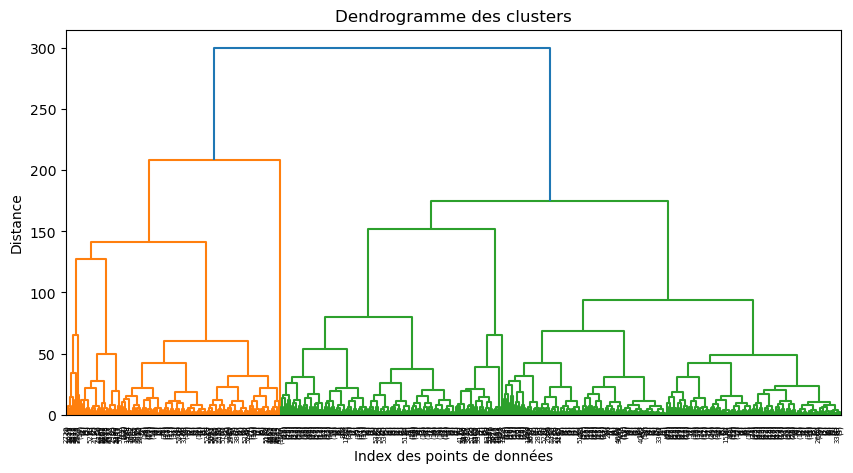

In [71]:
from scipy.cluster.hierarchy import dendrogram, linkage

# Appliquer l'algorithme de clustering hiérarchique
linked = linkage(coord_acp_5, method='ward')

# Tracer le dendrogramme
plt.figure(figsize=(10, 5))
dendrogram(linked, orientation='top', distance_sort='descending', truncate_mode='level', p=9, show_leaf_counts=True)
#plt.axhline(y=200, color='r', linestyle='--')
plt.title('Dendrogramme des clusters')
plt.xlabel('Index des points de données')
plt.ylabel('Distance')
plt.show()


Le dendrogramme suggère que trois clusters pourraient être un bon choix, en fonction des distances de fusion observées.

Pour affiner notre analyse, nous allons utiliser la méthode du coude pour trouver le nombre de clusters optimal.

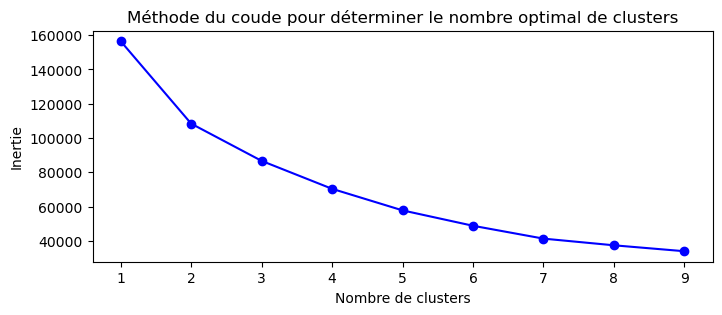

In [72]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Calcul de la distorsion pour un range de nombre de clusters
inertias = []
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(coord_acp_5) # Coord est le résultat d'ACP
    inertias.append(kmeans.inertia_)

# Tracé de la courbe du coude
plt.figure(figsize=(8, 3))
plt.plot(range(1, 10), inertias, 'bo-')
plt.xlabel('Nombre de clusters')
plt.ylabel('Inertie')
plt.title('Méthode du coude pour déterminer le nombre optimal de clusters')
plt.show()


Sur le graphique, on observe un changement moins marqué dans l'inertie après le troisième cluster, ce qui suggère que choisir 3 clusters pourrait être un bon choix pour notre modèle K-means.

En conclusion, nous allons utiliser le K-Means avec trois clusters sur les données transformées par l'ACP avec cinq composantes. Cela nous permettra de mieux identifier les groupes distincts et de comprendre les schémas présents dans nos données.

**Application de K-means sur les coordonnées obtenues par l'ACP**

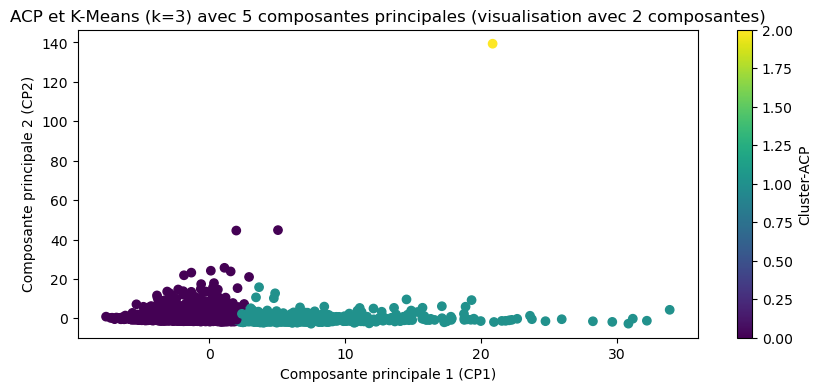

In [73]:
# Nombre optimal de clusters
k_optimal = 3

# Application de K-means avec le nombre optimal de clusters
kmeans = KMeans(n_clusters=k_optimal, random_state=42)
kmeans.fit(coord_acp_5)  # coord_acp_5 est le résultat de l'ACP avec 5 composantes

# Centroides et labels
centroids = kmeans.cluster_centers_
labels_acp = kmeans.labels_

# Ajout des étiquettes de clusters au DataFrame des coordonnées ACP
df_final_merge2['Cluster-ACP'] = labels_acp

clustering_results['KMeans after ACP'] = {'data': coord_acp_5, 'labels': labels_acp}

# Création d'un DataFrame avec les trois premières composantes principales et les labels de clusters
kmeans_data_3 = pd.DataFrame({
    'CP1': coord_acp_5[:, 0],
    'CP2': coord_acp_5[:, 1],
    'CP3': coord_acp_5[:, 2],
    'Cluster-ACP': labels_acp
})

# Visualisation des clusters avec les deux premières composantes principales
plt.figure(figsize=(10, 4))
plt.scatter(data=kmeans_data_3, x='CP1', y='CP2', c='Cluster-ACP', cmap='viridis')
plt.xlabel('Composante principale 1 (CP1)')
plt.ylabel('Composante principale 2 (CP2)')
plt.title(f'ACP et K-Means (k={k_optimal}) avec 5 composantes principales (visualisation avec 2 composantes)')
plt.colorbar(label='Cluster-ACP')
plt.show()

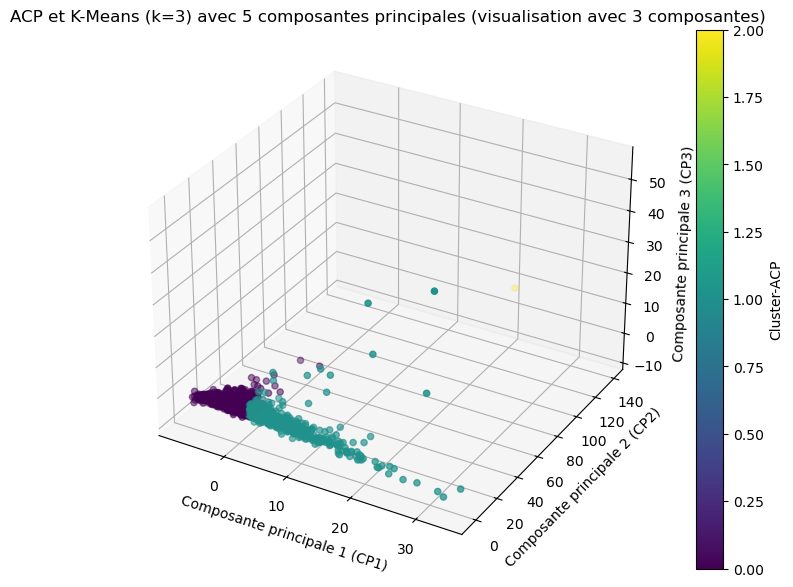

In [74]:
# Visualisation des clusters avec les trois premières composantes principales
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(kmeans_data_3['CP1'], kmeans_data_3['CP2'], kmeans_data_3['CP3'], c=kmeans_data_3['Cluster-ACP'], cmap='viridis')
ax.set_xlabel('Composante principale 1 (CP1)')
ax.set_ylabel('Composante principale 2 (CP2)')
ax.set_zlabel('Composante principale 3 (CP3)')
plt.title(f'ACP et K-Means (k={k_optimal}) avec 5 composantes principales (visualisation avec 3 composantes)')
plt.colorbar(sc, label='Cluster-ACP')
plt.show()

In [75]:
kmeans_data_3['Cluster-ACP'].value_counts()

Cluster-ACP
0    4223
1    1150
2       1
Name: count, dtype: int64

- Les clusters 0 et 1 semblent relativement homogènes, avec un nombre considérable d'observations.
- Le cluster 2 est très hétérogène, avec une seule observation. Cela peut indiquer soit une anomalie dans les données, soit une catégorie très spécifique qui se distingue nettement des autres.

**Application de l'ACP avec des paramètres supplémentaires**

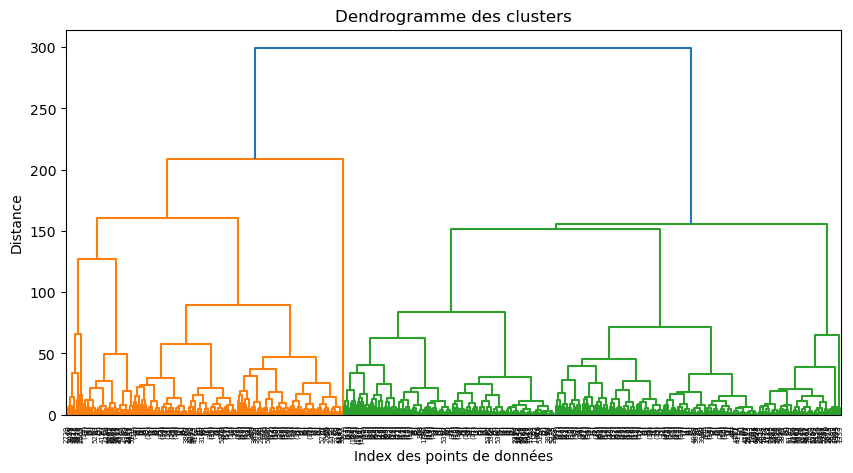

In [76]:
# Application de l'ACP avec des paramètres supplémentaires
pca = PCA(n_components=5, svd_solver='full', tol=1e-4)
coord_acp_5_optimised = pca.fit_transform(df_scaled_df)


# Appliquer l'algorithme de clustering hiérarchique
linked = linkage(coord_acp_5_optimised, method='ward')

# Tracer le dendrogramme
plt.figure(figsize=(10, 5))
dendrogram(linked, orientation='top', distance_sort='descending', truncate_mode='level', p=9, show_leaf_counts=True)
plt.title('Dendrogramme des clusters')
plt.xlabel('Index des points de données')
plt.ylabel('Distance')
plt.show()

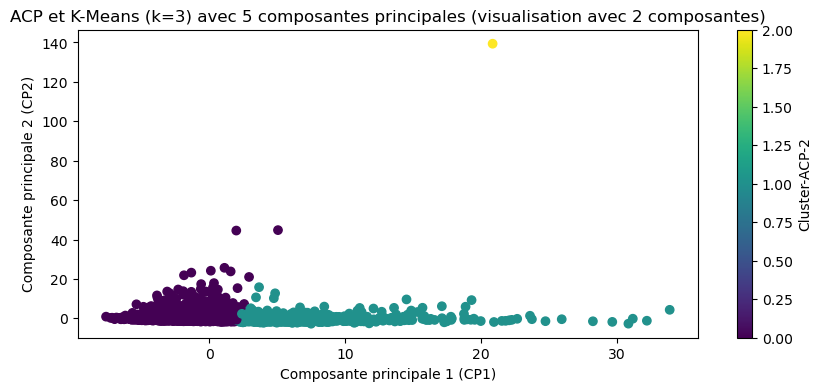

In [100]:
# Choisir le nombre de clusters basé sur les résultats ci-dessus (exemple avec k=3)
k_optimal = 3
kmeans = KMeans(n_clusters=k_optimal, random_state=42)
kmeans.fit(coord_acp_5_optimised)

# Centroides et labels
centroids = kmeans.cluster_centers_
labels_acp_2 = kmeans.labels_

# Ajout des étiquettes de clusters au DataFrame des coordonnées ACP
df_final_merge2['Cluster-ACP-2'] = labels_acp_2

clustering_results['KMeans after ACP-2'] = {'data': coord_acp_5_optimised, 'labels': labels_acp_2}


# Création d'un DataFrame avec les trois premières composantes principales et les labels de clusters
kmeans_data_3 = pd.DataFrame({
    'CP1': coord_acp_5_optimised[:, 0],
    'CP2': coord_acp_5_optimised[:, 1],
    'CP3': coord_acp_5_optimised[:, 2],
    'Cluster-ACP-2': labels_acp_2
})

# Visualisation des clusters avec les deux premières composantes principales
plt.figure(figsize=(10, 4))
plt.scatter(kmeans_data_3['CP1'], kmeans_data_3['CP2'], c=kmeans_data_3['Cluster-ACP-2'], cmap='viridis')
plt.xlabel('Composante principale 1 (CP1)')
plt.ylabel('Composante principale 2 (CP2)')
plt.title(f'ACP et K-Means (k={k_optimal}) avec 5 composantes principales (visualisation avec 2 composantes)')
plt.colorbar(label='Cluster-ACP-2')
plt.show()


In [101]:
# Verification value counts of elements in each cluster
kmeans_data_3['Cluster-ACP-2'].value_counts()

Cluster-ACP-2
0    4223
1    1150
2       1
Name: count, dtype: int64

Les résultats montrent la répartition des éléments dans trois clusters : le cluster 0 en contient 4223, indiquant un grand groupe principal, le cluster 1 en a 1150, formant un sous-groupe significatif, tandis que le cluster 2 n'a qu'un seul élément, ce qui suggère une caractéristique unique parmi les données.

In [102]:
# Calculate the mean of each feature for each cluster for ACP and ACP with parameters
cluster_means_acp = df_final_merge2.groupby('Cluster-ACP')[features_num_selected].mean().reset_index()
display(cluster_means_acp)

cluster_means_acp_2 = df_final_merge2.groupby('Cluster-ACP-2')[features_num_selected].mean().reset_index()
display(cluster_means_acp_2)

,Cluster-ACP,Total_Salaries,nb_auto_entrepreneur,nb_micro_entreprises,nb_small_entreprises,nb_medium_entreprises,nb_large_entreprises,DIST_COM_CL_DEPT,DIST_COM_CL_REG,DIST_COM_PARIS,mean_net_salary_hour_overall,mean_net_salary_hour_executives,mean_net_salary_hour_avg_executive,mean_net_salary_hour_employee,mean_net_salary_hour_worker,mean_net_salary_hour_female,mean_net_salary_hour_female_executives,mean_net_salary_hour_avg_female_executive,mean_net_salary_hour_female_employee,mean_net_salary_hour_female_worker,mean_net_salary_hour_male,mean_net_salary_hour_male_executives,mean_net_salary_hour_avg_male_executive,mean_net_salary_hour_male_employee,mean_net_salary_hour_male_worker,mean_net_salary_hour_18_25,mean_net_salary_hour_26_50,mean_net_salary_hour_over_50,mean_net_salary_hour_female_18_25,mean_net_salary_hour_female_26_50,mean_net_salary_hour_female_over_50,mean_net_salary_hour_male_18_25,mean_net_salary_hour_male_26_50,mean_net_salary_hour_male_over_50,men_over_15_no_diploma,men_over_15_bac_plus_5_gratuated,women_over_15_no_diploma,women_over_15_bac_plus_5_gratuated
0,0,21.525219,1.169311,12.751598,5.802510,1.400189,0.40161,31.683190,95.758051,489.856171,14.237906,24.016624,15.433458,11.300094,11.949445,12.912060,21.164274,14.305512,11.133007,10.620041,15.168010,25.380145,16.331279,11.783811,12.222368,10.395879,14.069107,16.054043,10.114847,12.929514,13.917601,10.594276,14.860707,17.574688,656.290828,318.805593,893.257647,289.547255
1,1,16.625217,0.965217,10.012174,4.407826,0.940000,0.30000,20.549148,52.718635,341.606287,19.573091,29.274419,17.313932,12.553193,12.784901,16.946718,25.041709,16.009976,12.364140,11.347310,21.521278,31.550319,18.534543,13.049302,13.031764,11.249514,18.755476,23.552794,10.667868,16.814151,19.033898,11.665920,20.224852,26.769500,430.330289,677.687669,540.984562,582.133886
2,2,1921.000000,157.000000,1246.000000,470.000000,45.000000,3.00000,0.000000,0.000000,1.460000,26.902558,36.764664,18.212561,12.738100,11.353863,23.684185,31.407258,17.473785,12.741673,11.046935,29.642383,41.113579,19.090146,12.733468,11.422010,13.089681,25.987506,34.305523,12.805619,23.875711,27.225903,13.395804,27.732365,40.393949,86644.864050,318287.322961,103630.577173,313110.402171


,Cluster-ACP-2,Total_Salaries,nb_auto_entrepreneur,nb_micro_entreprises,nb_small_entreprises,nb_medium_entreprises,nb_large_entreprises,DIST_COM_CL_DEPT,DIST_COM_CL_REG,DIST_COM_PARIS,mean_net_salary_hour_overall,mean_net_salary_hour_executives,mean_net_salary_hour_avg_executive,mean_net_salary_hour_employee,mean_net_salary_hour_worker,mean_net_salary_hour_female,mean_net_salary_hour_female_executives,mean_net_salary_hour_avg_female_executive,mean_net_salary_hour_female_employee,mean_net_salary_hour_female_worker,mean_net_salary_hour_male,mean_net_salary_hour_male_executives,mean_net_salary_hour_avg_male_executive,mean_net_salary_hour_male_employee,mean_net_salary_hour_male_worker,mean_net_salary_hour_18_25,mean_net_salary_hour_26_50,mean_net_salary_hour_over_50,mean_net_salary_hour_female_18_25,mean_net_salary_hour_female_26_50,mean_net_salary_hour_female_over_50,mean_net_salary_hour_male_18_25,mean_net_salary_hour_male_26_50,mean_net_salary_hour_male_over_50,men_over_15_no_diploma,men_over_15_bac_plus_5_gratuated,women_over_15_no_diploma,women_over_15_bac_plus_5_gratuated
0,0,21.525219,1.169311,12.751598,5.802510,1.400189,0.40161,31.683190,95.758051,489.856171,14.237906,24.016624,15.433458,11.300094,11.949445,12.912060,21.164274,14.305512,11.133007,10.620041,15.168010,25.380145,16.331279,11.783811,12.222368,10.395879,14.069107,16.054043,10.114847,12.929514,13.917601,10.594276,14.860707,17.574688,656.290828,318.805593,893.257647,289.547255
1,1,16.625217,0.965217,10.012174,4.407826,0.940000,0.30000,20.549148,52.718635,341.606287,19.573091,29.274419,17.313932,12.553193,12.784901,16.946718,25.041709,16.009976,12.364140,11.347310,21.521278,31.550319,18.534543,13.049302,13.031764,11.249514,18.755476,23.552794,10.667868,16.814151,19.033898,11.665920,20.224852,26.769500,430.330289,677.687669,540.984562,582.133886
2,2,1921.000000,157.000000,1246.000000,470.000000,45.000000,3.00000,0.000000,0.000000,1.460000,26.902558,36.764664,18.212561,12.738100,11.353863,23.684185,31.407258,17.473785,12.741673,11.046935,29.642383,41.113579,19.090146,12.733468,11.422010,13.089681,25.987506,34.305523,12.805619,23.875711,27.225903,13.395804,27.732365,40.393949,86644.864050,318287.322961,103630.577173,313110.402171


**Que nous apprennent les différents clusters identifiés ?**

| **Critère**                      | **Cluster 0**                  | **Cluster 1**                         | **Cluster 2**                           |
|----------------------------------|--------------------------------|---------------------------------------|-----------------------------------------|
| **Nombre d'entreprises**         | Modéré                         | Faible                                | Très élevé                              |
| **Disparité éducative**          |Forte disparité (2-3 fois plus de personnes sans diplôme)  | Haute concentration de diplômés Bac+5 pour les hommes, équilibrée pour femmes | Forte disparité (2-3 fois plus de personnes avec diplôme Bac+5) |
| **Salaires horaires moyens**     |Parmi les plus bas     | Élevés        | Très élevés     |
| **Localisation par rapport à Paris** | Éloignée       | Éloignée        | Très proche             |


**Visualisation des clusters sur la map (ACP + ACP-2)**

Nous allons maintenant visualiser les clusters sur la carte pour mieux comprendre leur répartition géographique.

In [103]:
# Define cluster colors and create the base map
cluster_colors_acp = {
    0: '#fbffb8',  # Light Yellow
    1: '#32a852',  # Green
    2: '#fa485a',  # Red
}

# Add a custom legend
legend_html = """
<div style="position: fixed; 
     bottom: 50px; left: 50px; width: 200px; height: 160px; 
     border:2px solid grey; z-index:9999; font-size:14px; 
     background:white; padding:10px;">
     <h4 style="margin:8px;">Cluster Legend</h4>
     <div style="background:#fbffb8;width:10px;height:10px;display:inline-block;"></div> Cluster 0 - Yellow<br>
     <div style="background:#32a852;width:10px;height:10px;display:inline-block;"></div> Cluster 1 - Green<br>
     <div style="background:#fa485a;width:10px;height:10px;display:inline-block;"></div> Cluster 2 - Red<br>
</div>
"""

# Call the function to plot the map
plot_cluster_map(df_final_merge2, '../src/departements-avec-outre-mer.geojson', 'Cluster-ACP', cluster_colors_acp, legend_html, generate_popup,cluster_means_acp)


In [104]:
# Define cluster colors and create the base map
cluster_colors_acp = {
    0: '#fbffb8',  # Light Yellow
    1: '#32a852',  # Green
    2: '#fa485a',  # Red
    3: '#CF9FFF',  # purple
}

# Add a custom legend
legend_html = """
<div style="position: fixed; 
     bottom: 50px; left: 50px; width: 200px; height: 160px; 
     border:2px solid grey; z-index:9999; font-size:14px; 
     background:white; padding:10px;">
     <h4 style="margin:8px;">Cluster Legend</h4>
     <div style="background:#fbffb8;width:10px;height:10px;display:inline-block;"></div> Cluster 0 - Yellow<br>
     <div style="background:#32a852;width:10px;height:10px;display:inline-block;"></div> Cluster 1 - Green<br>
     <div style="background:#fa485a;width:10px;height:10px;display:inline-block;"></div> Cluster 2 - Red<br>
     <div style="background:#CF9FFF;width:10px;height:10px;display:inline-block;"></div> Cluster 3 - Purple<br>
</div>
"""

# Call the function to plot the map
plot_cluster_map(df_final_merge2, '../src/departements-avec-outre-mer.geojson', 'Cluster-ACP-2', cluster_colors_acp, legend_html, generate_popup,cluster_means_acp_2)


#### Section 4.3 K-means Clustering après T-SNE  <a class="anchor" id="section_4_3"></a>

**1. Realisation T-SNE** 

Nous utilisons T-SNE pour réduire la dimensionnalité de notre jeu de données, après avoir précédemment utilisé l'ACP. 

Contrairement à l'ACP, qui est une méthode linéaire de réduction de dimensionnalité et conserve principalement la variance globale des données, T-SNE est une méthode non linéaire qui se concentre sur la préservation des relations locales et des proximités entre les points de données. 

Cette technique permet de projeter les données dans un espace à faible dimension (généralement 2 ou 3 dimensions) tout en préservant les relations de proximité, facilitant ainsi la visualisation des structures complexes dans les données et préparant le jeu de données pour le clustering.

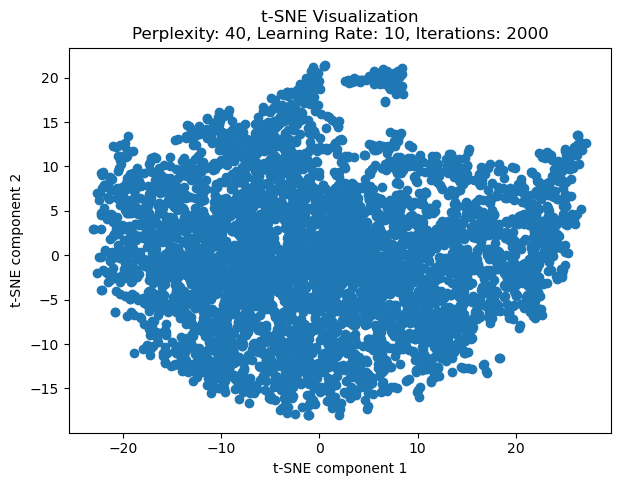

In [82]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Fonction pour tracer les résultats de t-SNE
def plot_tsne(Coord, perplexity, learning_rate, n_iter):
    plt.figure(figsize=(7, 5))
    plt.scatter(Coord[:, 0], Coord[:, 1], marker='o')
    plt.xlabel('t-SNE component 1')
    plt.ylabel('t-SNE component 2')
    plt.title(f't-SNE Visualization\nPerplexity: {perplexity}, Learning Rate: {learning_rate}, Iterations: {n_iter}')
    plt.show()

tsne_optimal = TSNE(n_components=3, perplexity=40, learning_rate=10, n_iter=2000, random_state=42)
Coord_optimal = tsne_optimal.fit_transform(df_scaled_df)
plot_tsne(Coord_optimal, perplexity=40, learning_rate=10, n_iter=2000)

In [105]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components = 3, perplexity=40, learning_rate=10, n_iter=2000, random_state=42)
coord_tsne = tsne.fit_transform(df_scaled_df)
coord_tsne_df = pd.DataFrame(coord_tsne)
#coord_tsne_df

**2. Application de K-means sur les coordonnées obtenues par le T-SNE**


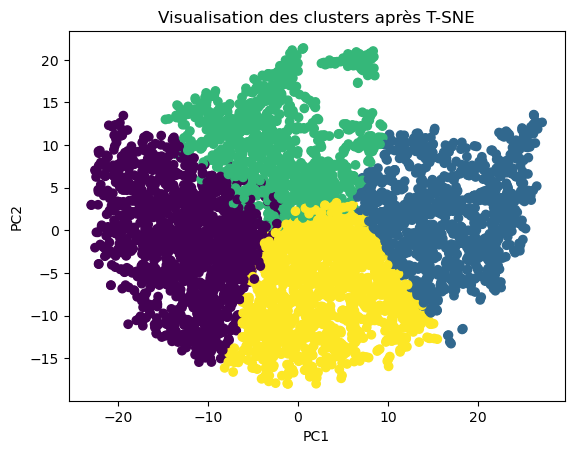

In [108]:
# Application de K-means sur coord_tsne
k_optimal = 4
kmeans = KMeans(n_clusters = k_optimal, random_state = 42)

kmeans.fit_transform(coord_tsne) # coord_tsne est le résultat de T-SNE

# Centroids and labels
centroids_tsne  = kmeans.cluster_centers_
labels_tsne = kmeans.labels_

# Ajout des étiquettes de clusters au DataFrame des coordonnées de T-SNE
df_final_merge2['Cluster-TSNE-kmeans'] = labels_tsne

clustering_results['KMeans after TSNE'] = {'data': coord_tsne, 'labels': labels_tsne}

kmeans_data_tsne = pd.DataFrame({'CP1': coord_tsne[:, 0], 'CP2': coord_tsne[:, 1], 'Cluster-TSNE-kmeans': labels_tsne})

plt.scatter(data=kmeans_data_tsne, x='CP1', y='CP2', c='Cluster-TSNE-kmeans');
plt.xlabel('PC1')  # Première composante principale
plt.ylabel('PC2')  # Deuxième composante principale
plt.title('Visualisation des clusters après T-SNE');

In [85]:
# Calculate the mean of each feature for each cluster
cluster_means_tsne = df_final_merge2.groupby('Cluster-TSNE-kmeans')[features_num_selected].mean().reset_index()
display(cluster_means_tsne)

# Verification value counts of elements in each cluster
display(kmeans_data_tsne['Cluster-TSNE-kmeans'].value_counts())

,Cluster-TSNE-kmeans,Total_Salaries,nb_auto_entrepreneur,nb_micro_entreprises,nb_small_entreprises,nb_medium_entreprises,nb_large_entreprises,DIST_COM_CL_DEPT,DIST_COM_CL_REG,DIST_COM_PARIS,mean_net_salary_hour_overall,mean_net_salary_hour_executives,mean_net_salary_hour_avg_executive,mean_net_salary_hour_employee,mean_net_salary_hour_worker,mean_net_salary_hour_female,mean_net_salary_hour_female_executives,mean_net_salary_hour_avg_female_executive,mean_net_salary_hour_female_employee,mean_net_salary_hour_female_worker,mean_net_salary_hour_male,mean_net_salary_hour_male_executives,mean_net_salary_hour_avg_male_executive,mean_net_salary_hour_male_employee,mean_net_salary_hour_male_worker,mean_net_salary_hour_18_25,mean_net_salary_hour_26_50,mean_net_salary_hour_over_50,mean_net_salary_hour_female_18_25,mean_net_salary_hour_female_26_50,mean_net_salary_hour_female_over_50,mean_net_salary_hour_male_18_25,mean_net_salary_hour_male_26_50,mean_net_salary_hour_male_over_50,men_over_15_no_diploma,men_over_15_bac_plus_5_gratuated,women_over_15_no_diploma,women_over_15_bac_plus_5_gratuated
0,0,11.882632,0.620036,7.315945,3.094843,0.706580,0.145228,37.014221,119.329615,377.759745,13.306582,22.930734,15.004662,11.008369,11.671695,12.221561,20.395222,13.927900,10.859643,10.451826,14.054535,24.132532,15.859799,11.441656,11.926294,10.226016,13.186293,14.763388,9.977541,12.217343,13.074377,10.395342,13.843104,15.963935,353.530714,86.799668,513.689568,80.676232
1,1,15.457961,0.863148,9.272809,4.196780,0.859571,0.265653,18.986225,53.392469,268.479937,19.640430,29.305463,17.254922,12.528649,12.687852,16.995650,25.062691,15.980367,12.352303,11.277309,21.614301,31.604695,18.467476,12.980256,12.929020,11.245841,18.804475,23.688402,10.665405,16.858780,19.106890,11.663739,20.286452,26.970756,389.315721,662.342398,500.505767,563.360860
2,2,56.102099,3.262405,32.687023,15.115458,3.801527,1.235687,24.151861,73.515582,923.515353,14.458229,24.731604,15.493815,11.331565,11.688080,13.252509,21.829869,14.565604,11.216537,10.347669,15.311611,26.214907,16.247672,11.631668,11.975678,10.446002,14.231348,16.566120,10.201065,13.270990,14.461053,10.628247,14.894225,18.110761,1849.265730,1308.847863,2427.809466,1212.913862
3,3,10.399737,0.509533,6.341223,2.819855,0.593031,0.136095,31.853314,83.475680,365.697535,15.190141,24.824571,15.952229,11.647323,12.526117,13.499341,21.631539,14.604834,11.414313,11.061321,16.378869,26.288941,17.009289,12.346138,12.812753,10.572173,15.006898,17.202812,10.222947,13.540248,14.541142,10.817506,16.042314,19.052390,252.037532,121.855200,346.801970,110.618317


Cluster-TSNE-kmeans
0    1687
3    1521
1    1118
2    1048
Name: count, dtype: int64

**Que nous apprennent les différents clusters identifiés ?**

| **Critère**                      | **Cluster 0**                  | **Cluster 1**                         | **Cluster 2**                           | **Cluster 3**                         | 
|----------------------------------|--------------------------------|---------------------------------------|-----------------------------------------|---------------------------------------|
| **Nombre d'entreprises**         | Faible       |  Modéré      | Élevés               | Faible        | 
| **Disparité éducative**          | Haute concentration de gens sans diplômes  | Équilibrée pour les femmes, deséquilibrée pour hommes (deux fois plus de hommes avec Bac+5) | Forte disparité (plus de personnes sans diplôme)	| Haute concentration de gens sans diplômes | 
| **Salaires horaires moyens**     |  Parmi les plus bas    |  Élevés  | Relativement faible      | Relativement faible  | 
| **Localisation par rapport à Paris** | Éloignée    |  Proximité significative    | Très éloignée      | Éloignée |               

**Visualisation des clusters sur la map (T-SNE)**

Nous allons maintenant visualiser les clusters sur la carte pour mieux comprendre leur répartition géographique.

In [86]:
# Define cluster colors and create the base map
cluster_colors_tsne = {
    0: '#fbffb8',  # Light Yellow
    1: '#32a852',  # Green
    2: '#fa485a',  # Red
    3: '#CF9FFF'
}

# Add a custom legend
legend_html = """
<div style="position: fixed; 
     bottom: 50px; left: 50px; width: 200px; height: 160px; 
     border:2px solid grey; z-index:9999; font-size:14px; 
     background:white; padding:10px;">
     <h4 style="margin:8px;">Cluster Legend</h4>
     <div style="background:#fbffb8;width:10px;height:10px;display:inline-block;"></div> Cluster 0 - Yellow<br>
     <div style="background:#32a852;width:10px;height:10px;display:inline-block;"></div> Cluster 1 - Green<br>
     <div style="background:#fa485a;width:10px;height:10px;display:inline-block;"></div> Cluster 2 - Red<br>
</div>
"""

# Call the function to plot the map
plot_cluster_map(df_final_merge2, '../src/departements-avec-outre-mer.geojson', 'Cluster-TSNE-kmeans', cluster_colors_tsne, legend_html, generate_popup, cluster_means_tsne)

#### Section 4.4 Agglomerative Clustering après T-SNE  <a class="anchor" id="section_4_4"></a>

Nous allons utiliser l'Agglomerative Clustering après avoir appliqué T-SNE pour réduire la dimensionnalité de notre jeu de données. 

L'Agglomerative Clustering est une méthode de clustering hiérarchique qui regroupe les données en formant des clusters imbriqués de manière récursive. 

En combinant T-SNE avec l'Agglomerative Clustering, nous pouvons exploiter les avantages de la réduction de dimensionnalité non linéaire pour mieux capturer les structures complexes dans les données tout en appliquant une méthode de clustering robuste. 

**AgglomerativeClustering apres T-SNE**

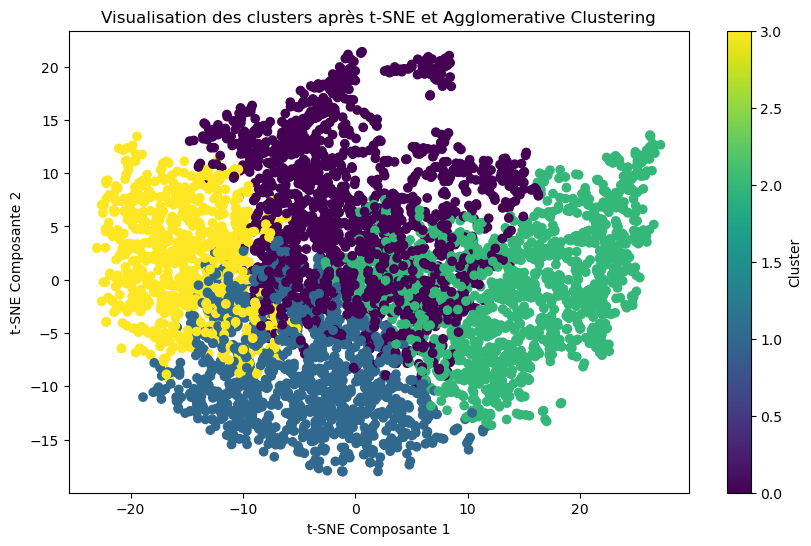

In [87]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import AgglomerativeClustering
from sklearn.manifold import TSNE

# Agglomerative Clustering
n_clusters = 4 # le nombre de clusters
agg_clustering = AgglomerativeClustering(n_clusters=n_clusters)
labels__tsne_agg = agg_clustering.fit_predict(coord_tsne)

# Ajout des étiquettes de clusters au DataFrame des coordonnées de t-SNE
data_clusters_tsne_agl = pd.DataFrame({'TSNE1': coord_tsne[:, 0], 'TSNE2': coord_tsne[:, 1],
                                       'Cluster-TSNE-agl': labels__tsne_agg})
df_final_merge2['Cluster-TSNE-agl'] = labels__tsne_agg

clustering_results['AgglomerativeClustering after TSNE'] = {'data': coord_tsne, 'labels': labels__tsne_agg}


# Visualisation des clusters après t-SNE
plt.figure(figsize=(10, 6))
scatter = plt.scatter(data=data_clusters_tsne_agl, x='TSNE1', y='TSNE2', c='Cluster-TSNE-agl', cmap='viridis')
plt.xlabel('t-SNE Composante 1')  # Première composante t-SNE
plt.ylabel('t-SNE Composante 2')  # Deuxième composante t-SNE
plt.title('Visualisation des clusters après t-SNE et Agglomerative Clustering')
plt.colorbar(scatter, label='Cluster')
plt.show()


In [88]:
display(df_final_merge2['Cluster-TSNE-agl'].value_counts())

# Calculate the mean of each feature for each cluster
cluster_means_acp_tsne_agl = df_final_merge2.groupby('Cluster-TSNE-agl')[features_num_selected].mean().reset_index()
display(cluster_means_acp_tsne_agl)

Cluster-TSNE-agl
0    1822
2    1407
1    1259
3     886
Name: count, dtype: int64

,Cluster-TSNE-agl,Total_Salaries,nb_auto_entrepreneur,nb_micro_entreprises,nb_small_entreprises,nb_medium_entreprises,nb_large_entreprises,DIST_COM_CL_DEPT,DIST_COM_CL_REG,DIST_COM_PARIS,mean_net_salary_hour_overall,mean_net_salary_hour_executives,mean_net_salary_hour_avg_executive,mean_net_salary_hour_employee,mean_net_salary_hour_worker,mean_net_salary_hour_female,mean_net_salary_hour_female_executives,mean_net_salary_hour_avg_female_executive,mean_net_salary_hour_female_employee,mean_net_salary_hour_female_worker,mean_net_salary_hour_male,mean_net_salary_hour_male_executives,mean_net_salary_hour_avg_male_executive,mean_net_salary_hour_male_employee,mean_net_salary_hour_male_worker,mean_net_salary_hour_18_25,mean_net_salary_hour_26_50,mean_net_salary_hour_over_50,mean_net_salary_hour_female_18_25,mean_net_salary_hour_female_26_50,mean_net_salary_hour_female_over_50,mean_net_salary_hour_male_18_25,mean_net_salary_hour_male_26_50,mean_net_salary_hour_male_over_50,men_over_15_no_diploma,men_over_15_bac_plus_5_gratuated,women_over_15_no_diploma,women_over_15_bac_plus_5_gratuated
0,0,37.107574,2.122393,21.922613,9.932492,2.400110,0.729967,20.973211,103.747920,686.593551,14.950246,25.114634,15.689065,11.498620,11.874779,13.567096,22.035769,14.659965,11.342021,10.539176,15.951471,26.673911,16.553066,11.925814,12.144431,10.499165,14.680034,17.148339,10.235987,13.567341,14.796686,10.695038,15.479017,18.867407,1196.530245,854.066417,1566.027576,787.868498
1,1,10.106434,0.513900,6.067514,2.683876,0.660048,0.181096,44.547538,78.675488,358.526855,14.128125,23.726793,15.525697,11.281885,12.283890,12.672172,20.803025,14.188445,11.070069,10.891935,15.108358,25.001308,16.521146,11.930088,12.563157,10.483229,14.013232,15.786497,10.163542,12.714199,13.535676,10.701329,14.883002,17.306012,298.240384,87.942141,430.432863,80.107148
2,2,14.046908,0.756219,8.359630,3.862829,0.808102,0.260128,21.515025,44.805394,297.838749,18.539522,27.915830,16.908876,12.351620,12.746354,16.135435,24.074203,15.630460,12.155843,11.343485,20.309659,29.929444,18.067943,12.880587,12.997579,11.070459,17.909301,22.008452,10.531885,16.063500,17.942580,11.453496,19.291733,24.894346,316.168554,494.073085,419.077734,421.681927
3,3,13.366817,0.707675,8.200903,3.534989,0.787810,0.135440,37.087415,128.544402,383.852619,13.037097,22.817248,14.877660,10.875960,11.445953,12.036079,20.308711,13.854805,10.768107,10.195576,13.739191,24.059924,15.710386,11.185851,11.716987,10.099127,12.890018,14.481800,9.855106,12.001436,12.916533,10.264595,13.497903,15.634532,398.001081,92.500183,579.153812,85.400289


**Que nous apprennent les différents clusters identifiés ?**

| **Critère**                      | **Cluster 0**                  | **Cluster 1**                         | **Cluster 2**                           | **Cluster 3**                         | 
|----------------------------------|--------------------------------|---------------------------------------|-----------------------------------------|---------------------------------------|
| **Nombre d'entreprises**         | Élevés       |    Faible  | Modéré     | Modéré       | 
| **Disparité éducative**          | Haute concentration de gens sans diplômes  |Forte disparité (plus de personnes sans diplôme) | Équilibrée |  Forte disparité (plus de personnes sans diplôme)| 
| **Salaires horaires moyens**     |  Relativement faible  |  Relativement faible| Élevés   | Parmi les plus bas    | 
| **Localisation par rapport à Paris** |   Très éloignée   |  Éloignée |    Proximité significative     | Éloignée |               

**Visualisation des clusters sur la map (AgglomerativeClustering après T-SNE)**

Nous allons maintenant visualiser les clusters sur la carte pour mieux comprendre leur répartition géographique.

In [89]:
# Define cluster colors and create the base map
cluster_colors_tsne = {
    0: '#fbffb8',  # Light Yellow
    1: '#32a852',  # Green
    2: '#fa485a',  # Red
    3: '#CF9FFF',  # Purple
}

# Add a custom legend
legend_html = """
<div style="position: fixed; 
     bottom: 50px; left: 50px; width: 200px; height: 160px; 
     border:2px solid grey; z-index:9999; font-size:14px; 
     background:white; padding:10px;">
     <h4 style="margin:8px;">Cluster Legend</h4>
     <div style="background:#fbffb8;width:10px;height:10px;display:inline-block;"></div> Cluster 0 - Yellow<br>
     <div style="background:#32a852;width:10px;height:10px;display:inline-block;"></div> Cluster 1 - Green<br>
     <div style="background:#fa485a;width:10px;height:10px;display:inline-block;"></div> Cluster 2 - Red<br>
     <div style="background:#CF9FFF;width:10px;height:10px;display:inline-block;"></div> Cluster 3 - Purple<br>
</div>
"""

# Call the function to plot the map
plot_cluster_map(df_final_merge2, '../src/departements.geojson', 'Cluster-TSNE-agl', cluster_colors_tsne, legend_html, generate_popup, cluster_means_acp_tsne_agl)

#### Section 4.5 Agglomerative Clustering après ACP  <a class="anchor" id="section_4_5"></a>

Nous allons combiner l'ACP avec l'Agglomerative Clustering, ce qui nous permet de profiter de la réduction linéaire de la dimensionnalité tout en appliquant une méthode de clustering hiérarchique pour regrouper les données en clusters imbriqués.

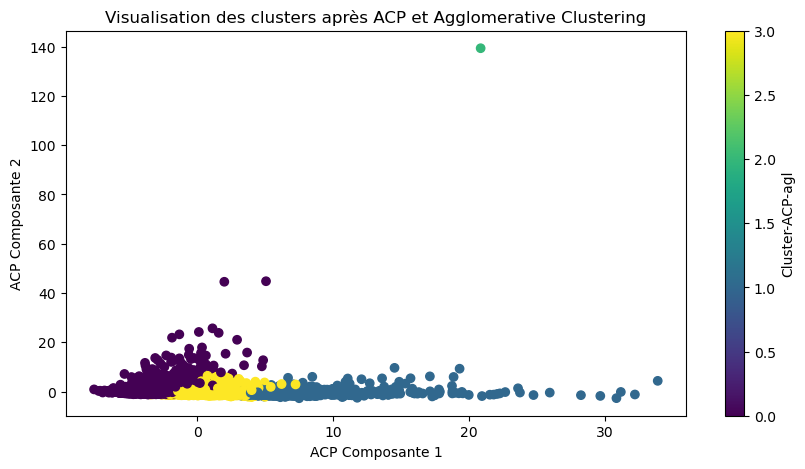

In [90]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import AgglomerativeClustering

# Agglomerative Clustering
n_clusters = 4  # le nombre de clusters
agg_clustering = AgglomerativeClustering(n_clusters=n_clusters)
labels__acp_agg = agg_clustering.fit_predict(coord_acp_5)

# Ajout des étiquettes de clusters au DataFrame des coordonnées de ACP
data_clusters_acp_agl = pd.DataFrame({'CP1': coord_acp_5[:, 0], 'CP2': coord_acp_5[:, 1],
                                       'Cluster-ACP-agl': labels__acp_agg})
df_final_merge2['Cluster-ACP-agl'] = labels__acp_agg

clustering_results['AgglomerativeClustering after ACP'] = {'data': coord_acp_5, 'labels': labels__acp_agg}

# Visualisation des clusters après ACP
plt.figure(figsize=(10, 5))
scatter = plt.scatter(data=data_clusters_acp_agl, x='CP1', y='CP2', c='Cluster-ACP-agl', cmap='viridis')
plt.xlabel('ACP Composante 1')  # Première composante t-SNE
plt.ylabel('ACP Composante 2')  # Deuxième composante t-SNE
plt.title('Visualisation des clusters après ACP et Agglomerative Clustering')
plt.colorbar(scatter, label='Cluster-ACP-agl')
plt.show()

In [91]:
df_final_merge2['Cluster-ACP-agl'].value_counts()

Cluster-ACP-agl
3    2707
0    2002
1     664
2       1
Name: count, dtype: int64

Bien que la majorité des données se répartissent entre les clusters 0 et 3, le graphique montre que les clusters ne sont pas distinctement séparés. En particulier, on observe une superposition significative des points des clusters 0 et 3, ce qui suggère que les caractéristiques socio-économiques de ces groupes sont très similaires.

#### Section 4.6 K-means Clustering après UMAP <a class="anchor" id="section_4_6"></a>

**1. Réduction des dimensions avec UMAP**

In [92]:
import umap.umap_ as umap

# Réduction de dimensionnalité avec UMAP
umap_model = umap.UMAP(n_neighbors=12, min_dist=0.15, n_components=2, random_state=42)
coord_umap = umap_model.fit_transform(df_scaled_df)


OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


**Application K-means après UMAP**

Après avoir réduit la dimensionnalité de nos données à l'aide de l'UMAP, nous allons appliquer K-means clustering.

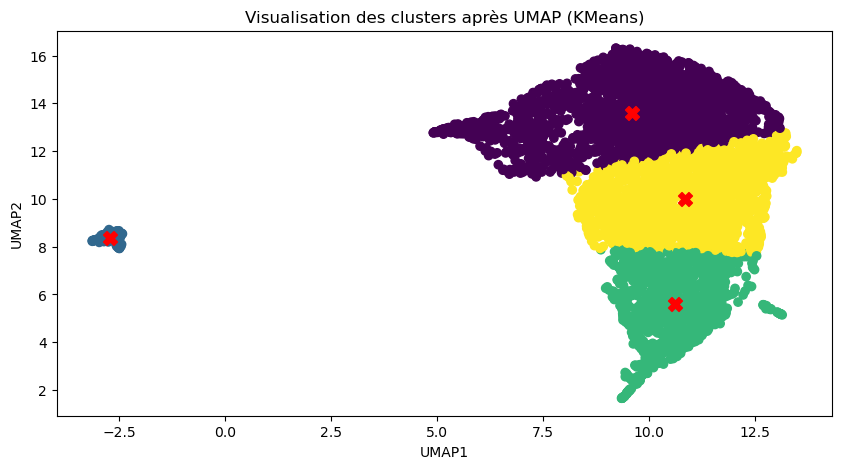

In [93]:
# Clustering avec KMeans
k_optimal = 4
kmeans = KMeans(n_clusters=k_optimal, random_state=42)
kmeans.fit(coord_umap)

# Centroids and labels
centroids_umap = kmeans.cluster_centers_
labels_umap = kmeans.labels_

# Ajout des étiquettes de clusters au DataFrame des coordonnées de UMAP
kmeans_data_umap = pd.DataFrame({'UMAP1': coord_umap[:, 0], 'UMAP2': coord_umap[:, 1], 'Cluster-UMAP-kmeans': labels_umap})
df_final_merge2['Cluster-UMAP-kmeans'] = labels_umap

clustering_results['KMeans after UMAP'] = {'data': coord_umap, 'labels': labels_umap}


# Visualisation des clusters après UMAP avec Matplotlib
plt.figure(figsize=(10, 5))
plt.scatter(kmeans_data_umap['UMAP1'], kmeans_data_umap['UMAP2'], c=kmeans_data_umap['Cluster-UMAP-kmeans'], cmap='viridis', marker='o')
plt.scatter(centroids_umap[:, 0], centroids_umap[:, 1], c='red', marker='X', s=100)  # Visualiser les centroids
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.title('Visualisation des clusters après UMAP (KMeans)')
plt.show()


In [94]:
df_final_merge2['Cluster-UMAP-kmeans'].value_counts()

Cluster-UMAP-kmeans
0    2348
3    1803
2    1135
1      88
Name: count, dtype: int64

In [95]:
cluster_means_umap = df_final_merge2.groupby('Cluster-UMAP-kmeans')[features_num_selected].mean().reset_index()
display(cluster_means_umap)

,Cluster-UMAP-kmeans,Total_Salaries,nb_auto_entrepreneur,nb_micro_entreprises,nb_small_entreprises,nb_medium_entreprises,nb_large_entreprises,DIST_COM_CL_DEPT,DIST_COM_CL_REG,DIST_COM_PARIS,mean_net_salary_hour_overall,mean_net_salary_hour_executives,mean_net_salary_hour_avg_executive,mean_net_salary_hour_employee,mean_net_salary_hour_worker,mean_net_salary_hour_female,mean_net_salary_hour_female_executives,mean_net_salary_hour_avg_female_executive,mean_net_salary_hour_female_employee,mean_net_salary_hour_female_worker,mean_net_salary_hour_male,mean_net_salary_hour_male_executives,mean_net_salary_hour_avg_male_executive,mean_net_salary_hour_male_employee,mean_net_salary_hour_male_worker,mean_net_salary_hour_18_25,mean_net_salary_hour_26_50,mean_net_salary_hour_over_50,mean_net_salary_hour_female_18_25,mean_net_salary_hour_female_26_50,mean_net_salary_hour_female_over_50,mean_net_salary_hour_male_18_25,mean_net_salary_hour_male_26_50,mean_net_salary_hour_male_over_50,men_over_15_no_diploma,men_over_15_bac_plus_5_gratuated,women_over_15_no_diploma,women_over_15_bac_plus_5_gratuated
0,0,28.345826,1.580494,16.731261,7.560477,1.913118,0.560477,33.124719,108.235511,357.748348,13.511852,23.253420,15.071051,11.061925,11.650179,12.423991,20.678888,14.040219,10.926194,10.403445,14.261112,24.492014,15.889873,11.452307,11.915373,10.301990,13.385608,15.100559,10.049819,12.435694,13.356656,10.478670,14.025245,16.349103,921.972532,586.868444,1251.504559,542.719046
1,1,55.954545,4.988636,37.784091,11.920455,1.170455,0.090909,28.362159,28.362159,7545.039318,14.053816,25.697641,16.173007,11.554602,11.628003,13.346826,23.156921,15.388916,11.383840,10.023223,14.587904,27.384964,16.885095,11.875183,11.868409,9.824007,13.655099,15.933018,9.915527,13.238955,14.531561,9.772120,13.992929,16.889495,2338.101268,427.498062,2794.603034,494.751886
2,2,15.482819,0.865198,9.245815,4.207048,0.883700,0.281057,19.957216,46.989022,255.637612,19.550476,29.099273,17.277650,12.558838,12.767374,16.949629,24.962512,15.993149,12.376230,11.330249,21.479865,31.331129,18.480005,13.040488,13.015259,11.254226,18.738871,23.531937,10.677828,16.819263,19.048654,11.667551,20.192250,26.720221,405.590843,650.535073,513.841010,554.951085
3,3,12.694398,0.595119,7.490849,3.586800,0.799224,0.222407,30.230438,85.994060,370.164187,15.258058,25.089546,15.909339,11.605503,12.372516,13.564147,21.786917,14.624649,11.393616,10.948265,16.464306,26.636925,16.933273,12.227663,12.656116,10.551688,15.035468,17.387284,10.209084,13.592672,14.658796,10.794397,16.063350,19.324351,289.601130,160.842993,405.059650,142.878793


**Que nous apprennent les différents clusters identifiés ?**

| **Critère**                      | **Cluster 0**                  | **Cluster 1**                         | **Cluster 2**                           | **Cluster 3**                         | 
|----------------------------------|--------------------------------|---------------------------------------|-----------------------------------------|---------------------------------------|
| **Nombre d'entreprises**         |  Modéré      |     Élevés|   Faible   | Faible       | 
| **Disparité éducative**          | Haute concentration de gens sans diplômes  |Forte disparité (plus de personnes sans diplôme) | Équilibrée pour les femmes, deséquilibrée pour hommes (plus de hommes avec Bac+5)  |  Forte disparité (plus de personnes sans diplôme)| 
| **Salaires horaires moyens**     |   Parmi les plus bas    |  Relativement faible| Élevés   | Relativement faible | 
| **Localisation par rapport à Paris** |  Éloignée  |   Très éloignée   |    Proximité significative     | Éloignée |       

Cluster-UMAP-kmeans-2
1    2406
2    1826
0    1054
3      88
Name: count, dtype: int64

,Cluster-UMAP-kmeans-2,Total_Salaries,nb_auto_entrepreneur,nb_micro_entreprises,nb_small_entreprises,nb_medium_entreprises,nb_large_entreprises,DIST_COM_CL_DEPT,DIST_COM_CL_REG,DIST_COM_PARIS,mean_net_salary_hour_overall,mean_net_salary_hour_executives,mean_net_salary_hour_avg_executive,mean_net_salary_hour_employee,mean_net_salary_hour_worker,mean_net_salary_hour_female,mean_net_salary_hour_female_executives,mean_net_salary_hour_avg_female_executive,mean_net_salary_hour_female_employee,mean_net_salary_hour_female_worker,mean_net_salary_hour_male,mean_net_salary_hour_male_executives,mean_net_salary_hour_avg_male_executive,mean_net_salary_hour_male_employee,mean_net_salary_hour_male_worker,mean_net_salary_hour_18_25,mean_net_salary_hour_26_50,mean_net_salary_hour_over_50,mean_net_salary_hour_female_18_25,mean_net_salary_hour_female_26_50,mean_net_salary_hour_female_over_50,mean_net_salary_hour_male_18_25,mean_net_salary_hour_male_26_50,mean_net_salary_hour_male_over_50,men_over_15_no_diploma,men_over_15_bac_plus_5_gratuated,women_over_15_no_diploma,women_over_15_bac_plus_5_gratuated
0,0,15.459203,0.874763,9.274194,4.128083,0.886148,0.296015,20.500019,47.504459,250.492761,19.698824,29.305453,17.358145,12.585971,12.798539,17.056779,25.097363,16.053614,12.403276,11.338965,21.654887,31.582026,18.580126,13.063786,13.047021,11.309258,18.845667,23.752915,10.719792,16.909165,19.194099,11.732365,20.309505,26.985827,420.012021,673.532157,529.727214,575.156370
1,1,28.118038,1.541978,16.552785,7.550291,1.914381,0.558603,32.038982,106.426712,356.543329,13.540288,23.239240,15.086949,11.077305,11.678011,12.435635,20.653341,14.041955,10.936107,10.429384,14.300669,24.481042,15.914624,11.485438,11.943759,10.310399,13.412265,15.132601,10.057829,12.446443,13.366669,10.486940,14.063260,16.390092,902.710100,572.657443,1225.214436,529.820190
2,2,12.634721,0.621030,7.493976,3.547097,0.764513,0.208105,30.800082,85.643176,370.035717,15.380835,25.225409,15.929253,11.629131,12.358313,13.673348,21.918803,14.666728,11.423378,10.943306,16.603627,26.782920,16.944623,12.231244,12.639839,10.547938,15.155384,17.562719,10.200159,13.706494,14.797740,10.794849,16.193471,19.539609,291.716746,174.483916,408.470089,153.790840
3,3,55.954545,4.988636,37.784091,11.920455,1.170455,0.090909,28.362159,28.362159,7545.039318,14.053816,25.697641,16.173007,11.554602,11.628003,13.346826,23.156921,15.388916,11.383840,10.023223,14.587904,27.384964,16.885095,11.875183,11.868409,9.824007,13.655099,15.933018,9.915527,13.238955,14.531561,9.772120,13.992929,16.889495,2338.101268,427.498062,2794.603034,494.751886


### Chapitre 5. Evaluation <a class="anchor" id="chapter5"></a>


Dans cette section, nous allons évaluer les performances des différentes méthodes de clustering utilisées précédemment.

La métrique de performance principale que nous allons utiliser pour comparer les modèles de clustering est **le Silhouette Score**. Cette métrique a été choisie pour les raisons suivantes :

- **Cohésion et Séparation** : Le Silhouette Score mesure à la fois la cohésion des clusters (la proximité des points au sein d'un même cluster) et la séparation entre les clusters (la distance entre différents clusters).
- **Interprétation Simple** : Il varie de -1 à 1, où des valeurs plus élevées indiquent des clusters bien formés et distincts, facilitant ainsi l'interprétation des résultats.


Nous utiliserons également une autre métrique de performance pour évaluer les modèles de clustering : **le Calinski-Harabasz Index**.

- **Description** : Cet indice mesure la compacité et la séparation des clusters. Il est calculé en utilisant le rapport entre la somme de la dispersion entre les clusters et la somme de la dispersion au sein des clusters.
- **Utilisation** : Un score élevé de l'indice Calinski-Harabasz indique que les clusters sont denses et bien séparés.

Cette métrique est utilisée en complément du Silhouette Score pour fournir une évaluation plus robuste des performances des modèles de clustering.

Nous allons appliquer ces indices aux résultats des différentes méthodes de clustering et comparer les scores obtenus pour déterminer quelle méthode offre la meilleure performance.

In [96]:
from sklearn.metrics import calinski_harabasz_score, silhouette_score

# Initialize a dictionary to store the scores
scores = {
    'Method': [],
    'Calinski-Harabasz Index': [],
    'Silhouette Score': []
}

# Function to evaluate and store scores
def evaluate_clustering(method_name, data, labels):
    ch_score = calinski_harabasz_score(data, labels)
    silhouette_avg = silhouette_score(data, labels)
    scores['Method'].append(method_name)
    scores['Calinski-Harabasz Index'].append(ch_score)
    scores['Silhouette Score'].append(silhouette_avg)

# Evaluate all stored clustering results
for method, result in clustering_results.items():
    evaluate_clustering(method, result['data'], result['labels'])

# Display the scores
scores_df = pd.DataFrame(scores)
display(scores_df)

,Method,Calinski-Harabasz Index,Silhouette Score
0,KMeans without ACP,1375.163267,0.275796
1,KMeans after ACP,2161.269875,0.476797
2,KMeans after ACP-2,2188.146925,0.367527
3,KMeans after TSNE,3054.531292,0.294976
4,AgglomerativeClustering after TSNE,2274.970079,0.227908
5,AgglomerativeClustering after ACP,1973.431784,0.271372
6,KMeans after UMAP,6371.374481,0.422500


Parmi ces méthodes, **KMeans après ACP** présente les meilleurs résultats avec un score de silhouette de 0.476798, ce qui indique une meilleure cohésion interne et une meilleure séparation des clusters.

**KMeans après UMAP** présente les meilleurs résultats en termes d'indice de Calinski-Harabasz avec une valeur de 6371.374481, ce qui indique une très bonne formation des clusters. 

Cependant, pour obtenir un bon équilibre entre la cohésion interne et la séparation des clusters, **KMeans après ACP** semble être la meilleure option grâce à son score de silhouette supérieur.

Nous allons tester différentes combinaisons de composantes principales (n_components) et de nombres de clusters (n_clusters) en utilisant l'Analyse en Composantes Principales (ACP) suivie de KMeans pour le clustering. Les performances de ces combinaisons seront évaluées à l'aide de deux métriques : le Silhouette Score et le Calinski-Harabasz Score. Les résultats seront visualisés pour aider à déterminer les paramètres optimaux.

    n_components  n_clusters  silhouette_score  calinski_harabasz_score
0              2           3          0.557496              3205.513228
1              2           4          0.475732              3579.855154
2              2           5          0.510540              4318.550897
3              2           6          0.451591              4951.826358
4              3           3          0.530790              2598.352242
5              3           4          0.436835              2715.040698
6              3           5          0.466806              2980.994905
7              3           6          0.391257              3097.922957
8              4           3          0.496767              2261.241403
9              4           4          0.392914              2336.439932
10             4           5          0.420632              2454.195642
11             4           6          0.421411              2586.165269
12             5           3          0.476793              2161

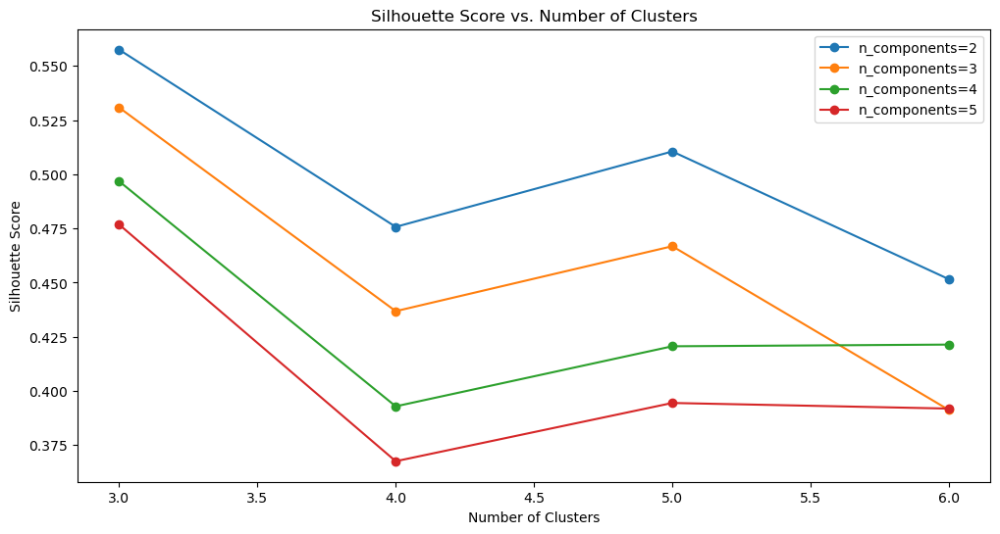

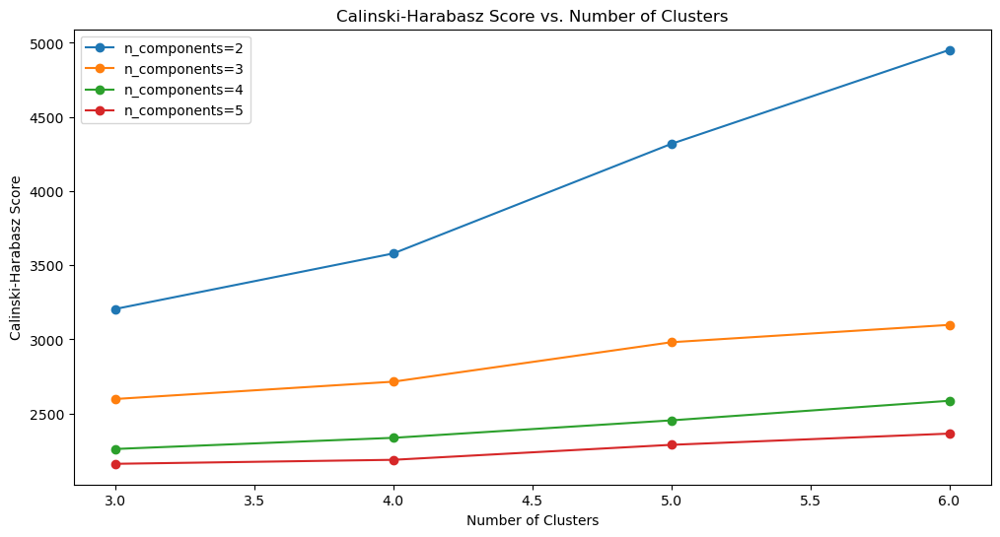

In [128]:
# Fonction pour évaluer ACP et KMeans
def evaluate_pca_kmeans(params, X):
    pca = PCA(n_components=params['n_components'])
    coord_acp = pca.fit_transform(X)
    kmeans = KMeans(n_clusters=params['n_clusters'], random_state=42)
    labels = kmeans.fit_predict(coord_acp)
    sil_score = silhouette_score(coord_acp, labels)
    ch_score = calinski_harabasz_score(coord_acp, labels)
    return sil_score, ch_score

# Paramètres de la recherche en grille
param_grid = {
    'n_components': [2, 3, 4, 5],
    'n_clusters': [3, 4, 5, 6]
}

# Stocker tous les scores
results = []

for n_components in param_grid['n_components']:
    for n_clusters in param_grid['n_clusters']:
        params = {
            'n_components': n_components,
            'n_clusters': n_clusters
        }
        sil_score, ch_score = evaluate_pca_kmeans(params, df_scaled_df)
        results.append({
            'n_components': n_components,
            'n_clusters': n_clusters,
            'silhouette_score': sil_score,
            'calinski_harabasz_score': ch_score
        })

# Convertir les résultats en DataFrame
results_df = pd.DataFrame(results)

# Affichage des résultats
print(results_df)

# Visualisation des scores Silhouette
fig, ax1 = plt.subplots(1, 1, figsize=(12, 6))
for n_components in param_grid['n_components']:
    subset = results_df[results_df['n_components'] == n_components]
    ax1.plot(subset['n_clusters'], subset['silhouette_score'], marker='o', label=f'n_components={n_components}')
ax1.set_title('Silhouette Score vs. Number of Clusters')
ax1.set_xlabel('Number of Clusters')
ax1.set_ylabel('Silhouette Score')
ax1.legend()

# Visualisation des scores Calinski-Harabasz
fig, ax2 = plt.subplots(1, 1, figsize=(12, 6))
for n_components in param_grid['n_components']:
    subset = results_df[results_df['n_components'] == n_components]
    ax2.plot(subset['n_clusters'], subset['calinski_harabasz_score'], marker='o', label=f'n_components={n_components}')
ax2.set_title('Calinski-Harabasz Score vs. Number of Clusters')
ax2.set_xlabel('Number of Clusters')
ax2.set_ylabel('Calinski-Harabasz Score')
ax2.legend()

plt.show()


**Conclusion**

Pour choisir le meilleur modèle de clustering, nous avons évalué les combinaisons de différentes dimensions réduites et nombres de clusters en utilisant deux métriques : le Silhouette Score et le Calinski-Harabasz Score.


**Top Performers**

- Silhouette Score
   - n_components=2, n_clusters=3 : Silhouette Score = 0.557496
   - n_components=2, n_clusters=5 : Silhouette Score = 0.510540
   - n_components=3, n_clusters=3 : Silhouette Score = 0.530790

- Calinski-Harabasz Score
   - n_components=2, n_clusters=6 : Calinski-Harabasz Score = 4951.826358
   - n_components=2, n_clusters=5 : Calinski-Harabasz Score = 4318.550897
   - n_components=2, n_clusters=4 : Calinski-Harabasz Score = 3579.855154

Les deux scores montrent que les meilleures performances sont obtenues avec n_components=2 et n_clusters=3, 4, 5, ou 6. 

Nous allons choisir la combinaison **n_components=2** et **n_clusters=5**. Cette combinaison offre un bon compromis entre les deux scores, avec des valeurs élevées dans les deux métriques. Cela devrait fournir un équilibre optimal entre la cohésion et la séparation des clusters, comme indiqué par les scores Silhouette et Calinski-Harabasz.

Ensuite, nous allons visualiser les clusters obtenus avec ces paramètres optimaux.

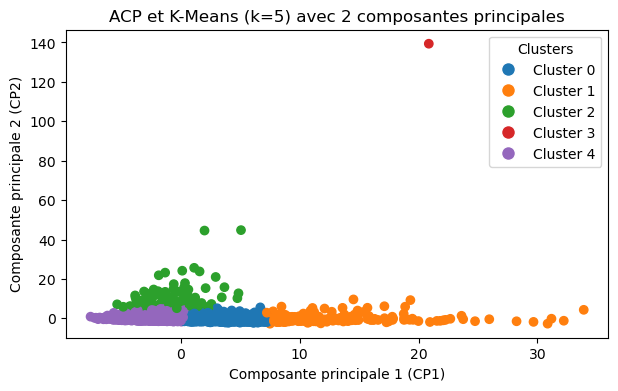

In [162]:
# Réduction de dimensionnalité avec ACP (2 composantes principales)
pca = PCA(n_components=2)
coord_acp_best = pca.fit_transform(df_scaled_df)

# Clustering avec KMeans (5 clusters)
k_optimal = 5
kmeans = KMeans(n_clusters=k_optimal, random_state=42)
kmeans.fit(coord_acp_best)

# Centroides et labels
centroids = kmeans.cluster_centers_
labels_acp_best = kmeans.labels_

# Ajout des étiquettes de clusters au DataFrame des coordonnées ACP
df_final_merge2['Cluster-ACP-KMeans-best'] = labels_acp_best

# Stockage des résultats de clustering
clustering_results = {'KMeans after ACP-2 best': {'data': coord_acp_best, 'labels': labels_acp_best}}

# Création d'un DataFrame avec les deux premières composantes principales et les labels de clusters
kmeans_data_optimised = pd.DataFrame({
    'CP1': coord_acp_best[:, 0],
    'CP2': coord_acp_best[:, 1],
    'Cluster-ACP-KMeans-best': labels_acp_best
})

# Définir les couleurs des clusters
cluster_colors_acp_optimised = {
    0: '#1f77b4',  # Blue
    1: '#ff7f0e',  # Orange
    2: '#2ca02c',  # Green
    3: '#d62728',  # Red
    4: '#9467bd',  # Purple
}

# Appliquer les couleurs aux clusters
colors = [cluster_colors_acp_optimised[label] for label in kmeans_data_optimised['Cluster-ACP-KMeans-best']]

# Visualisation des clusters avec les deux premières composantes principales
fig, ax = plt.figure(figsize=(7, 4)), plt.gca()
scatter = ax.scatter(kmeans_data_optimised['CP1'], kmeans_data_optimised['CP2'], c=colors)
plt.xlabel('Composante principale 1 (CP1)')
plt.ylabel('Composante principale 2 (CP2)')
plt.title(f'ACP et K-Means (k={k_optimal}) avec 2 composantes principales')

# Ajout de la légende
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=cluster_colors_acp_optimised[i], markersize=10) for i in range(k_optimal)]
labels = [f'Cluster {i}' for i in range(k_optimal)]
ax.legend(handles, labels, title="Clusters")

plt.show()


In [163]:
display(df_final_merge2['Cluster-ACP-KMeans-best'].value_counts())

# Calculate the mean of each feature for each cluster
cluster_means_acp_kmeans_optimised = df_final_merge2.groupby('Cluster-ACP-KMeans-best')[features_num_selected].mean().reset_index()
display(cluster_means_acp_kmeans_optimised)

Cluster-ACP-KMeans-best
4    3319
0    1690
1     240
2     124
3       1
Name: count, dtype: int64

,Cluster-ACP-KMeans-best,Total_Salaries,nb_auto_entrepreneur,nb_micro_entreprises,nb_small_entreprises,nb_medium_entreprises,nb_large_entreprises,DIST_COM_CL_DEPT,DIST_COM_CL_REG,DIST_COM_PARIS,mean_net_salary_hour_overall,mean_net_salary_hour_executives,mean_net_salary_hour_avg_executive,mean_net_salary_hour_employee,mean_net_salary_hour_worker,mean_net_salary_hour_female,mean_net_salary_hour_female_executives,mean_net_salary_hour_avg_female_executive,mean_net_salary_hour_female_employee,mean_net_salary_hour_female_worker,mean_net_salary_hour_male,mean_net_salary_hour_male_executives,mean_net_salary_hour_avg_male_executive,mean_net_salary_hour_male_employee,mean_net_salary_hour_male_worker,mean_net_salary_hour_18_25,mean_net_salary_hour_26_50,mean_net_salary_hour_over_50,mean_net_salary_hour_female_18_25,mean_net_salary_hour_female_26_50,mean_net_salary_hour_female_over_50,mean_net_salary_hour_male_18_25,mean_net_salary_hour_male_26_50,mean_net_salary_hour_male_over_50,men_over_15_no_diploma,men_over_15_bac_plus_5_gratuated,women_over_15_no_diploma,women_over_15_bac_plus_5_gratuated
0,0,15.234911,0.831361,9.134320,4.140237,0.897041,0.231953,23.930929,68.571852,403.129799,17.139427,26.921476,16.583437,12.114079,12.621003,15.126830,23.337516,15.355951,11.917524,11.171720,18.615204,28.739436,17.649878,12.660491,12.886331,10.816098,16.700487,20.076872,10.436902,15.104333,16.678072,11.099925,17.879850,22.522594,388.875778,347.655186,498.935866,304.142324
1,1,19.462500,1.266667,11.608333,4.933333,1.070833,0.583333,15.411208,34.037750,186.191667,25.057443,34.535366,18.790671,13.240576,12.866881,20.824307,28.748276,17.157965,13.072090,11.460871,28.229392,37.899569,20.475367,13.619226,13.084182,12.351493,23.322339,31.276758,11.146280,20.433071,23.978968,13.151991,25.574459,36.375886,484.325461,1538.924394,639.954223,1302.549133
2,2,190.596774,12.354839,116.064516,47.443548,11.338710,3.395161,14.842339,68.676774,1192.744597,14.746054,24.872697,15.312600,11.270353,11.370891,13.672240,22.271444,14.551464,11.195445,10.015722,15.510764,26.315860,15.980491,11.436306,11.649342,10.528962,14.601652,17.225833,10.267768,13.781228,15.144598,10.736417,15.156656,18.814660,6440.094561,5188.537185,8446.783949,4711.563784
3,3,1921.000000,157.000000,1246.000000,470.000000,45.000000,3.000000,0.000000,0.000000,1.460000,26.902558,36.764664,18.212561,12.738100,11.353863,23.684185,31.407258,17.473785,12.741673,11.046935,29.642383,41.113579,19.090146,12.733468,11.422010,13.089681,25.987506,34.305523,12.805619,23.875711,27.225903,13.395804,27.732365,40.393949,86644.864050,318287.322961,103630.577173,313110.402171
4,4,16.862911,0.845737,9.867129,4.672793,1.149443,0.327810,33.578554,100.163082,478.347138,13.807714,23.566673,15.261217,11.180601,11.852247,12.581747,20.811403,14.145767,11.017565,10.552900,14.656791,24.867282,16.136714,11.656157,12.123823,10.331299,13.664009,15.459354,10.062180,12.593697,13.511355,10.517857,14.396235,16.835317,510.511027,158.300424,708.095044,145.033384


**Visualisation finale avec les paramètres optimaux**

In [164]:
# Define cluster colors and create the base map
cluster_colors_acp_optimised = {
    0: '#EF779F  ',  # Purple
    1: '#ff9f00',  # Orange
    2: '#00a693',  # Green
    3: '#d62728',  # Red
    4: '#1180FF', # Blue
}

# Add a custom legend
legend_html = """
<div style="position: fixed; 
     bottom: 50px; left: 50px; width: 200px; height: 160px; 
     border:2px solid grey; z-index:9999; font-size:14px; 
     background:white; padding:10px;">
     <h4 style="margin:8px;">Cluster Legend</h4>
     <div style="background:#EF779F;width:10px;height:10px;display:inline-block;"></div> Cluster 0 - Purple<br>
     <div style="background:#ff9f00;width:10px;height:10px;display:inline-block;"></div> Cluster 1 - Orange<br>
     <div style="background:#00a693;width:10px;height:10px;display:inline-block;"></div> Cluster 2 - Green<br>
     <div style="background:#d62728;width:10px;height:10px;display:inline-block;"></div> Cluster 3 - Red<br>
     <div style="background:#1180FF;width:10px;height:10px;display:inline-block;"></div> Cluster 4 - Blue<br>
    
</div>
"""

# Call the function to plot the map
plot_cluster_map(df_final_merge2, '../src/departements-avec-outre-mer.geojson', 'Cluster-ACP-KMeans-3', cluster_colors_acp_optimised, legend_html, generate_popup, cluster_means_acp_kmeans_optimised)

### OLD

#### OLD Section 3.3 Calcul des disparités salariales <a class="anchor" id="section_3_3"></a>

#### OLD Section 3.4. Agrégation des données par Régions, Départements <a class="anchor" id="section_3_4"></a>

#### Section 3.5 Normalisation des données avant clustering <a class="anchor" id="section_3_5"></a> 

In [98]:
erewtrt

NameError: name 'erewtrt' is not defined